# Setup

## Path

In [ ]:
#%autoreload 2
%matplotlib inline
!nvcc --version

try:
    import google.colab
    _ON_COLAB = True
except:
    _ON_COLAB = False

print('Running on Google Colab = ', _ON_COLAB)

import os
import torch
from IPython import get_ipython

if _ON_COLAB:
    BASE_PATH = "/content"
    import locale
    locale.getpreferredencoding = lambda: "UTF-8"
else:
    BASE_PATH = "/lapix"
    VISIBLE_GPUS = [0] # selecionar gpu livre para rodar

    if torch.cuda.device_count() != 8:
        print("GPU JÁ SETADA - PULANDO ETAPA")
    else:
        os.environ["CUDA_VISIBLE_DEVICES"] = str(VISIBLE_GPUS).replace("]", "").replace("[","").replace(" ", "")
        os.environ["NVIDIA_VISIBLE_DEVICES"] = str(VISIBLE_GPUS).replace("]", "").replace("[","").replace(" ", "")
        print("CUDA GPUS NUMBER: ", torch.cuda.device_count())

os.chdir(BASE_PATH) # garante execução no /content (colab) ou /lapix (UFSC)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2024 NVIDIA Corporation
Built on Thu_Jun__6_02:18:23_PDT_2024
Cuda compilation tools, release 12.5, V12.5.82
Build cuda_12.5.r12.5/compiler.34385749_0
Running on Google Colab =  True


## Installations

In [ ]:
INSTALL_LIBS = False

if _ON_COLAB:
    INSTALL_LIBS = True

if INSTALL_LIBS:
    !pip install lapixdl
    !pip install -U albumentations
    !pip install fastai

## Imports

In [ ]:
import random
from pathlib import Path

import albumentations as A
import numpy as np
import pandas as pd
from fastai.vision.all import *
from lapixdl.evaluation.evaluate import evaluate_classification
from lapixdl.evaluation.model import Classification
import shutil

random.seed(81615)

## Google Drive

In [ ]:
from google.colab import drive
import os
drive.mount(os.path.join(BASE_PATH, "gdrive"))
DRIVE_BASE_PATH = os.path.join(BASE_PATH, "gdrive")

Mounted at /content/gdrive


# Utility Functions

In [ ]:
class AlbumentationsTransform(Transform):
    split_idx = 0

    def __init__(self, aug):
        self.aug = aug

    def encodes(self, img: PILImage):
        aug_img = self.aug(image=np.array(img))["image"]
        return PILImage.create(aug_img)

# Neural Networks

## Setup

In [ ]:
DEV_PATH = Path(os.path.join(BASE_PATH, 'gdrive/MyDrive/UFSC/Semestres/Décimo/TCC II/Desenvolvimento/Classificação/Alterações Morfológicas por Tipo'))

DATASET_PATH = (Path(os.path.join(DEV_PATH, 'Dataset'))) # Images root folder. The images must be inside the [train|val|test]/[class] folders.

OUTPUT_PATH = Path(os.path.join(DEV_PATH, 'Output'))

MODELS_PATH = (Path(os.path.join(OUTPUT_PATH, 'Models')))  # Folder where the models/weights should be saved in

OUTPUT_PATH.mkdir(parents=True, exist_ok=True)

## Splitting Train, Test, and Validation

In [ ]:
def random_sample_images(dirpath, destfolder, nimages):
  files_list = os.listdir(dirpath)

  for filename in random.sample(files_list, nimages):
    shutil.move(os.path.join(dirpath, filename), os.path.join(destfolder, filename))

In [ ]:
_SPLIT_NEEDED = False

if _SPLIT_NEEDED:
  TRAIN_PATH = os.path.join(DATASET_PATH, "train")
  VALID_PATH = os.path.join(DATASET_PATH, "valid")
  TEST_PATH = os.path.join(DATASET_PATH, "test")

  os.makedirs(DATASET_PATH, exist_ok=True)
  os.makedirs(TRAIN_PATH, exist_ok=True)
  os.makedirs(VALID_PATH, exist_ok=True)
  os.makedirs(TEST_PATH, exist_ok=True)

  dirnames = [
      'Greenish membranes',
      'Irregular placental disc',
      'Marginal insertion of the umbilical cord with radial blood vessel distribution',
      'Opaque placental membranes',
      'Oval-shaped disc',
      'Peripheral cord insertion with radial vasculature',
      'Placental lesions',
      'Unaltered'
  ]
  datadict = {}
  for dir_name in dirnames:
    os.makedirs(os.path.join(TRAIN_PATH, dir_name), exist_ok=True)
    os.makedirs(os.path.join(VALID_PATH, dir_name), exist_ok=True)
    os.makedirs(os.path.join(TEST_PATH, dir_name), exist_ok=True)

    datadict[dir_name] = len([fname for fname in os.listdir(os.path.join(DATASET_PATH, dir_name)) if os.path.isfile(os.path.join(DATASET_PATH, dir_name, fname))])

  train_rate = 0.8
  val_rate = 0.1
  test_rate = 0.1

  for key in datadict:
    images_to_train = int(datadict[key] * train_rate)
    images_to_val = int(datadict[key] * val_rate)
    images_to_test = int(datadict[key] * test_rate)

    random_sample_images(os.path.join(DATASET_PATH, key), os.path.join(TRAIN_PATH, key), images_to_train)
    random_sample_images(os.path.join(DATASET_PATH, key), os.path.join(VALID_PATH, key), images_to_val)
    random_sample_images(os.path.join(DATASET_PATH, key), os.path.join(TEST_PATH, key), images_to_test)

  os.chdir(BASE_PATH)
else:
  print('Split not needed')

Split not needed


## Albumentations

In [ ]:
import albumentations as A
_AUGMENTATION_NEEDED = False

if _AUGMENTATION_NEEDED:
  augmentations = A.Compose(
      [
          A.HorizontalFlip(p=0.5),
          A.Rotate((-10, 10), p=0.75),
          A.RandomBrightnessContrast(0.1, 0.1, p=0.75),
          A.Affine(p=0.75, shear=0.2)
      ]
  )

  transforms = [AlbumentationsTransform(augmentations)]
else:
  transforms = []
  print('Augmentation not needed')

Augmentation not needed


## Resnet18 - Batch Size 8 with DA

### Setup

In [ ]:
from fastai.vision.models import resnet18

used_model = resnet18

In [ ]:
metrics = [
    accuracy,
    F1Score(average="macro"),
    Precision(average="macro"),
    Recall(average="macro"),
]

In [ ]:
# Defina o tamanho do seu lote de imagens para processamento pela rede
batch_size = 8

image_size = (224, 224)

# Carregue os dados usando função nativa do fast.ai
data = ImageDataLoaders.from_folder(
    DATASET_PATH,
    train='train',
    valid='valid',
    test='test',
    bs=batch_size,
    item_tfms=Resize(image_size),
    batch_tfms=[*transforms, Normalize.from_stats(*imagenet_stats)]
)

In [ ]:
def get_learner(data, load_model=None, unfreeze:bool=False):
    """Creates and setups the learner for each step of the training approach.

    Args:
        data: Dataloader.
        load_model (str): Path to the model to be loaded.
        unfreeze (bool): Indicates if the model should be unfreezed. Defaults to False.
    """
    learner = vision_learner(
        data,
        used_model,
        metrics=metrics,
        loss_func=CrossEntropyLossFlat()
    ).to_fp16()

    learner.path = Path(os.path.join(MODELS_PATH, 'resnet18-bs8'))

    if load_model:
      learner.load(load_model, with_opt=False)

    if(unfreeze):
      learner.unfreeze()

    return learner

### Transfer Learning

#### Training

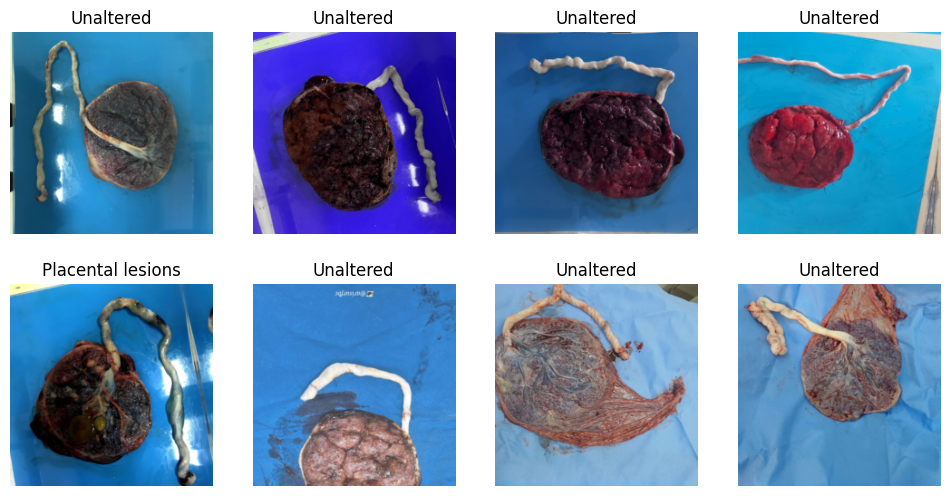

In [ ]:
data.show_batch()

/usr/local/lib/python3.12/dist-packages/fastai/callback/fp16.py:47: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  self.autocast,self.learn.scaler,self.scales = autocast(dtype=dtype),GradScaler(**self.kwargs),L()
/usr/local/lib/python3.12/dist-packages/fastai/callback/fp16.py:47: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.autocast,self.learn.scaler,self.scales = autocast(dtype=dtype),GradScaler(**self.kwargs),L()


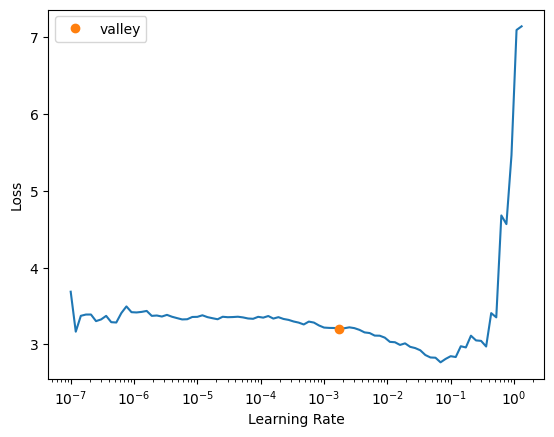

In [ ]:
learner = get_learner(data)
lr = learner.lr_find()

epoch,train_loss,valid_loss,accuracy,f1_score,precision_score,recall_score,time
0,3.061347,1.845188,0.371795,0.210548,0.233766,0.334965,01:24
1,2.365330,1.102283,0.705128,0.512885,0.427083,0.830645,01:02
2,1.536420,0.510889,0.884615,0.716426,0.636616,0.858871,01:02
3,0.936677,0.180279,0.961538,0.905234,0.854167,0.993952,01:02
4,0.489348,0.142547,0.948718,0.883402,0.852083,0.931452,01:03
5,0.314691,0.024459,0.987179,0.957333,0.998016,0.937500,01:03
6,0.240393,0.044584,0.974359,0.947951,0.916667,0.995968,01:02
7,0.155836,0.020428,0.987179,0.989385,0.998016,0.982143,01:02
8,0.126892,0.015087,1.000000,1.000000,1.000000,1.000000,01:15
9,0.122745,0.002631,1.000000,1.000000,1.000000,1.000000,01:05


Better model found at epoch 0 with f1_score value: 0.2105482593287471.


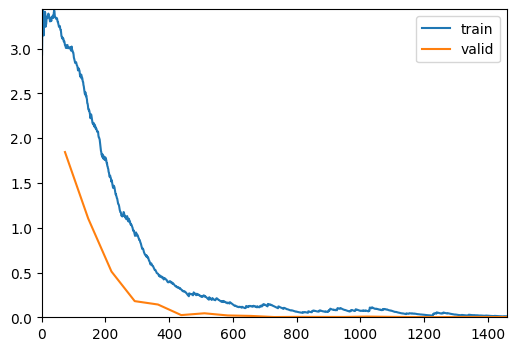

Better model found at epoch 1 with f1_score value: 0.5128851540616246.
Better model found at epoch 2 with f1_score value: 0.7164262820512821.
Better model found at epoch 3 with f1_score value: 0.9052341597796143.
Better model found at epoch 5 with f1_score value: 0.9573333333333334.
Better model found at epoch 7 with f1_score value: 0.9893846153846154.
Better model found at epoch 8 with f1_score value: 1.0.


In [ ]:
wd = 1e-2
TRAIN_EPOCH = 20
learn = learner
callbacks = [
    SaveModelCallback(monitor='f1_score', fname='best_model_stg1', with_opt=False),
    ShowGraphCallback(),
    # EarlyStoppingCallback(monitor='valid_loss', patience=5)
]

learn.fit_one_cycle(TRAIN_EPOCH, lr_max=lr, wd=wd, cbs=callbacks)

#### Results

/usr/local/lib/python3.12/dist-packages/fastai/callback/fp16.py:47: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  self.autocast,self.learn.scaler,self.scales = autocast(dtype=dtype),GradScaler(**self.kwargs),L()
/usr/local/lib/python3.12/dist-packages/fastai/callback/fp16.py:47: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.autocast,self.learn.scaler,self.scales = autocast(dtype=dtype),GradScaler(**self.kwargs),L()


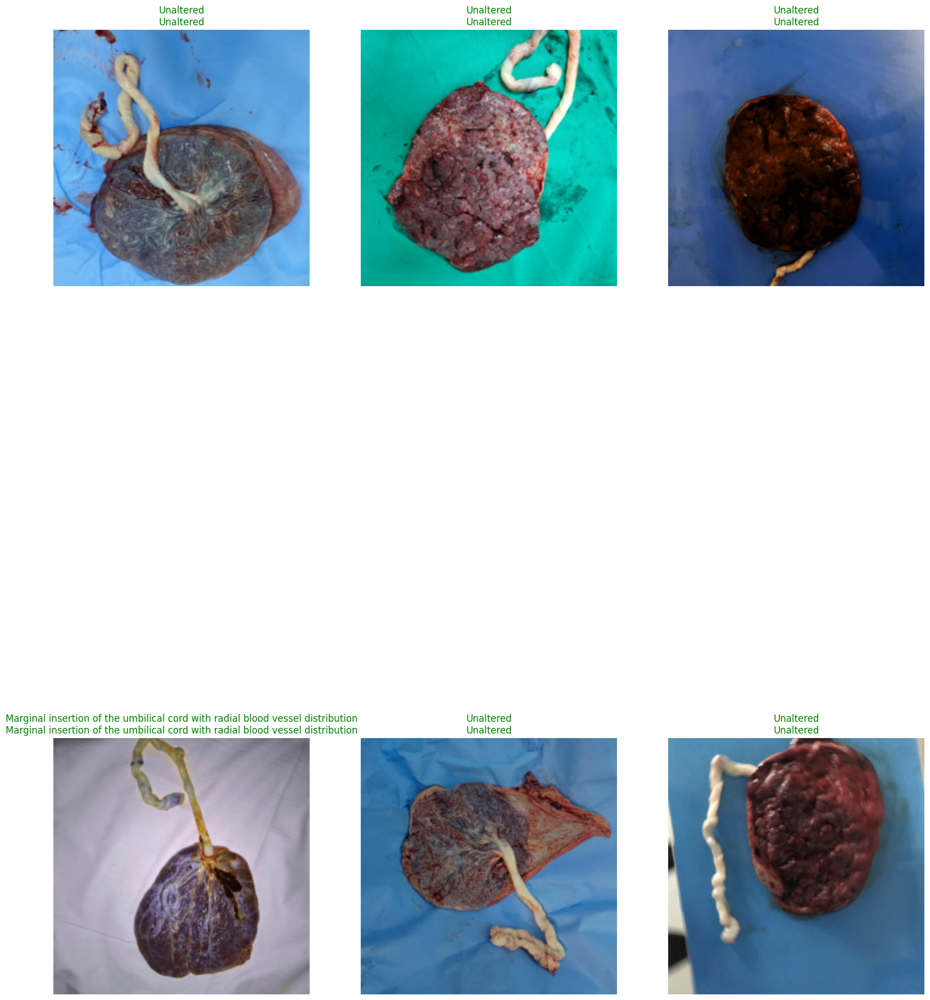

In [ ]:
get_learner(data, 'best_model_stg1').show_results(
    max_n=6, figsize=(20, 30)
)

### Finetuning

#### Training

In [ ]:
'''
learner = get_learner(data, 'best_model_stg1', True)
learner.lr_find()
'''

print('Skipped since finetuning not needed')

Skipped since finetuning not needed


In [ ]:
'''
lr = slice(1.44e-5, 8e-5)
wd = 1e-2
TRAIN_EPOCH = 20
callbacks = [
    SaveModelCallback(monitor='f1_score', fname='best_model_stg2', with_opt=False),
    ShowGraphCallback(),
    EarlyStoppingCallback(monitor='valid_loss', patience=3)
]

learn.fit_one_cycle(TRAIN_EPOCH, lr_max=lr, wd=wd, cbs=callbacks)
'''

print('Skipped since finetuning not needed')

Skipped since finetuning not needed


### Test

#### Setup

In [ ]:
# Defina o tamanho do seu lote de imagens para processamento pela rede
batch_size = 1

image_size = (224, 224)

# Carregue os dados usando função nativa do fast.ai
data_test = ImageDataLoaders.from_folder(
    DATASET_PATH,
    train='test',
    valid='test',
    test='test',
    bs=batch_size,
    item_tfms=Resize(image_size),
    batch_tfms=Normalize.from_stats(*imagenet_stats)
)

In [ ]:
learner = get_learner(data_test, 'best_model_stg1')
test_dataset = data_test.valid_ds

#### Functions

In [ ]:
from IPython.display import Image

def gt_classifications(ds):
    for (img, cls) in ds:
        yield Classification(int(cls))

def pred_classifications(ds):
    for (img, cls) in ds:
        (cls_name, pred_cls, scores) = learner.predict(img)
        yield Classification(int(pred_cls), scores[int(pred_cls)])

def top5(img):
  pred_class, pred_idxs, outputs = learner.predict(img)
  top_5_conf, i = outputs.topk(5)
  itr = 0
  classes = data.classes
  for x in i:
    print("Class: %s, Probability: %.4f %%"%(classes[x.item()], top_5_conf[itr].item()*100))
    itr=itr+1
  print()

def get_prediction(img, correct_class):
  pred_class, pred_idxs, outputs = learner.predict(img)
  classes = data.classes
  out = list(outputs)
  index = classes.index(correct_class)
  prediction = out[index]
  print("%.10f %%"%(prediction.item()*100))
  print()

#### Results

In [ ]:
evaluation_test = evaluate_classification(
    gt_classifications(test_dataset), pred_classifications(test_dataset), test_dataset.vocab
)

print(evaluation_test)

0 samples [00:00, ? samples/s]

/usr/local/lib/python3.12/dist-packages/fastai/callback/fp16.py:47: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  self.autocast,self.learn.scaler,self.scales = autocast(dtype=dtype),GradScaler(**self.kwargs),L()
/usr/local/lib/python3.12/dist-packages/fastai/callback/fp16.py:47: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.autocast,self.learn.scaler,self.scales = autocast(dtype=dtype),GradScaler(**self.kwargs),L()


Classification Metrics:
	Sample Count: 78
	Accuracy: 0.9743589743589743
	Avg Recall: 0.872983870967742
	Avg Precision: 0.872983870967742
	Avg Specificity: 0.9905641233766234
	Avg FPR: 0.009435876623376624
	Avg F-Score: 0.872983870967742

By Class:

Greenish membranes:
	TP: 0
	TN: 76
	FP: 1
	FN: 1
	FPR: 0.012987012987012988
	Accuracy: 0.9743589743589743
	Recall: 0.0
	Precision: 0.0
	Specificity: 0.987012987012987
	F-Score: 0.0
Irregular placental disc:
	TP: 1
	TN: 77
	FP: 0
	FN: 0
	FPR: 0.0
	Accuracy: 1.0
	Recall: 1.0
	Precision: 1
	Specificity: 1.0
	F-Score: 1.0
Marginal insertion of the umbilical cord with radial blood vessel distribution:
	TP: 2
	TN: 76
	FP: 0
	FN: 0
	FPR: 0.0
	Accuracy: 1.0
	Recall: 1.0
	Precision: 1
	Specificity: 1.0
	F-Score: 1.0
Opaque placental membranes:
	TP: 2
	TN: 76
	FP: 0
	FN: 0
	FPR: 0.0
	Accuracy: 1.0
	Recall: 1.0
	Precision: 1
	Specificity: 1.0
	F-Score: 1.0
Oval-shaped disc:
	TP: 1
	TN: 77
	FP: 0
	FN: 0
	FPR: 0.0
	Accuracy: 1.0
	Recall: 1.0
	Precision: 

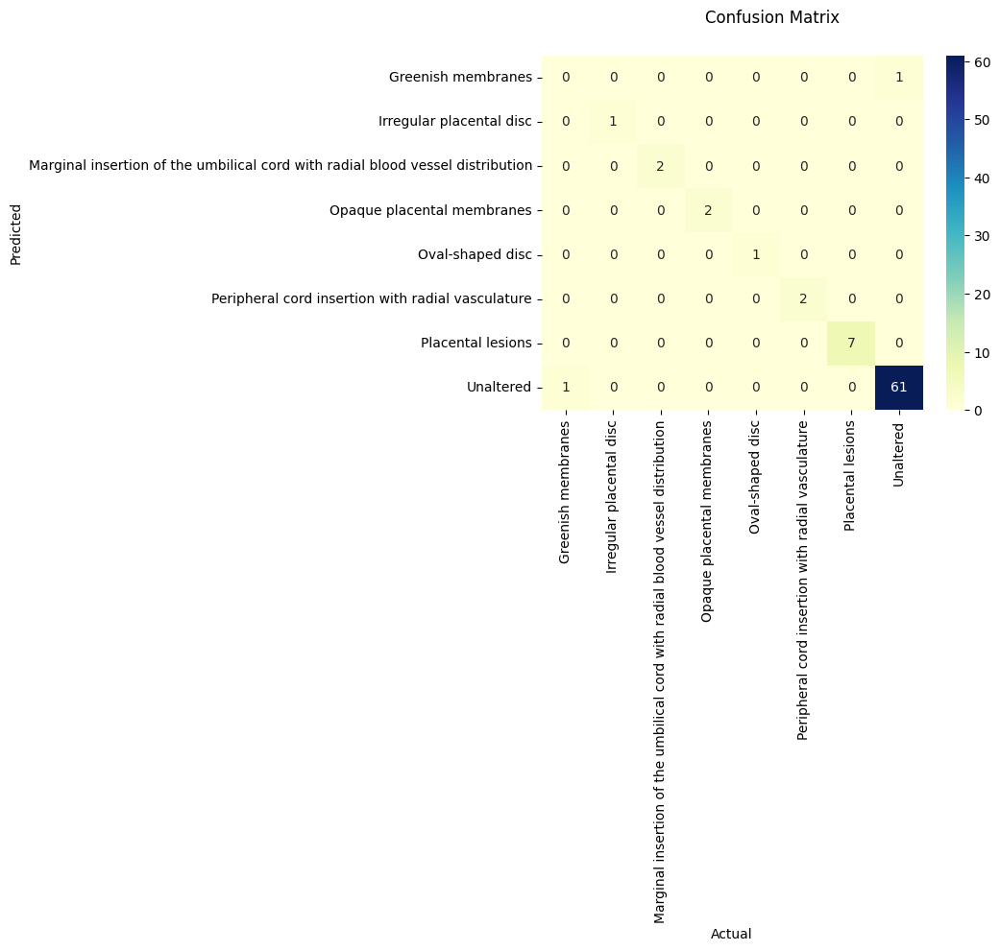

(<Figure size 640x480 with 2 Axes>,
 <Axes: xlabel='Actual', ylabel='Predicted'>)

In [ ]:
evaluation_test.show_confusion_matrix()

/usr/local/lib/python3.12/dist-packages/fastai/callback/fp16.py:47: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  self.autocast,self.learn.scaler,self.scales = autocast(dtype=dtype),GradScaler(**self.kwargs),L()
/usr/local/lib/python3.12/dist-packages/fastai/callback/fp16.py:47: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.autocast,self.learn.scaler,self.scales = autocast(dtype=dtype),GradScaler(**self.kwargs),L()


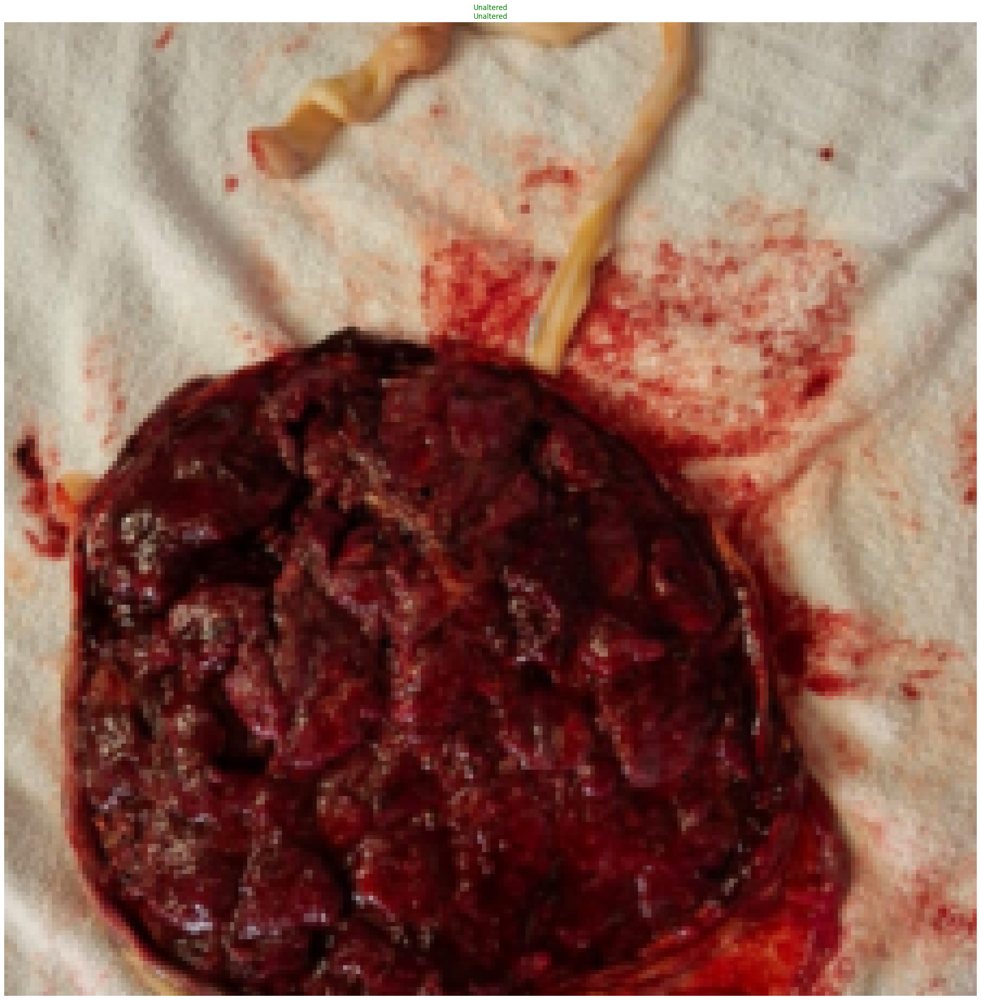

In [ ]:
learner.show_results(max_n=2, figsize=(30, 40))

## Resnet34 - Batch Size 8 with DA

### Setup

In [ ]:
from fastai.vision.models import resnet34

used_model = resnet34

In [ ]:
metrics = [
    accuracy,
    F1Score(average="macro"),
    Precision(average="macro"),
    Recall(average="macro"),
]

In [ ]:
# Defina o tamanho do seu lote de imagens para processamento pela rede
batch_size = 8

image_size = (224, 224)

# Carregue os dados usando função nativa do fast.ai
data = ImageDataLoaders.from_folder(
    DATASET_PATH,
    train='train',
    valid='valid',
    test='test',
    bs=batch_size,
    item_tfms=Resize(image_size),
    batch_tfms=[*transforms, Normalize.from_stats(*imagenet_stats)]
)

In [ ]:
def get_learner(data, load_model=None, unfreeze:bool=False):
    """Creates and setups the learner for each step of the training approach.

    Args:
        data: Dataloader.
        load_model (str): Path to the model to be loaded.
        unfreeze (bool): Indicates if the model should be unfreezed. Defaults to False.
    """
    learner = vision_learner(
        data,
        used_model,
        metrics=metrics,
        loss_func=CrossEntropyLossFlat()
    ).to_fp16()

    learner.path = Path(os.path.join(MODELS_PATH, 'resnet34-bs8'))

    if load_model:
      learner.load(load_model, with_opt=False)

    if(unfreeze):
      learner.unfreeze()

    return learner

### Transfer Learning

#### Training

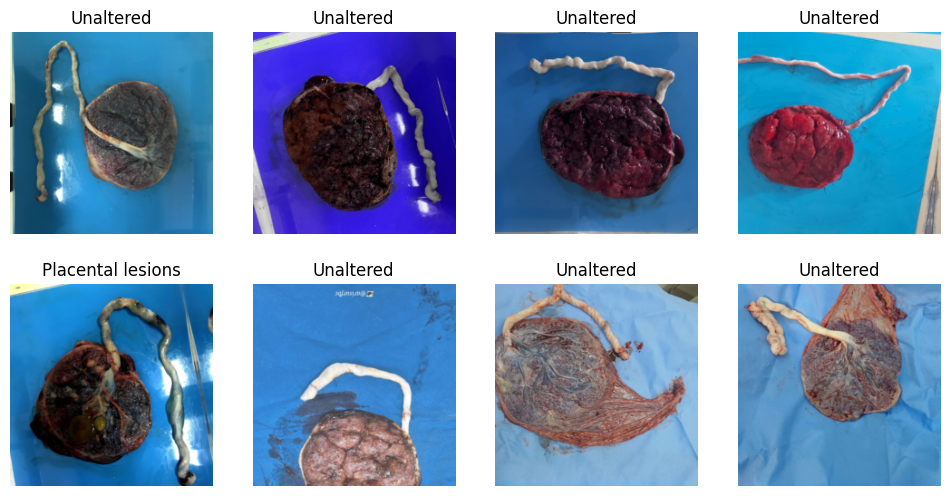

In [ ]:
data.show_batch()

Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth


100%|██████████| 83.3M/83.3M [00:00<00:00, 207MB/s]
/usr/local/lib/python3.12/dist-packages/fastai/callback/fp16.py:47: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  self.autocast,self.learn.scaler,self.scales = autocast(dtype=dtype),GradScaler(**self.kwargs),L()
/usr/local/lib/python3.12/dist-packages/fastai/callback/fp16.py:47: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.autocast,self.learn.scaler,self.scales = autocast(dtype=dtype),GradScaler(**self.kwargs),L()


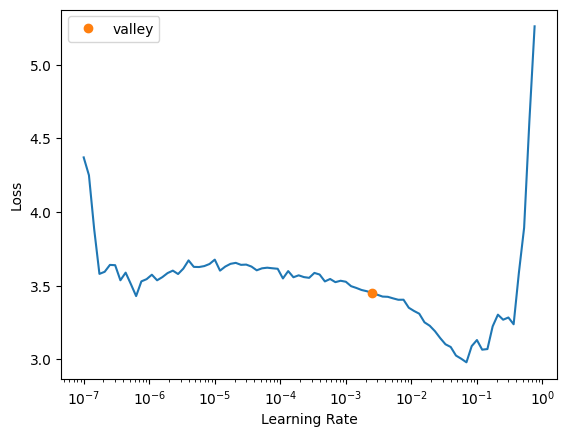

In [ ]:
learner = get_learner(data)
lr = learner.lr_find().valley

epoch,train_loss,valid_loss,accuracy,f1_score,precision_score,recall_score,time
0,3.021834,1.749376,0.448718,0.240017,0.247601,0.425403,01:16
1,2.223544,0.759954,0.807692,0.539857,0.467415,0.725806,01:00
2,1.343907,0.354715,0.923077,0.805025,0.772845,0.864919,01:02
3,0.711017,0.151591,0.948718,0.755333,0.813740,0.747984,01:01
4,0.386248,0.123190,0.961538,0.802151,0.794859,0.810484,01:01
5,0.263433,0.035538,1.000000,1.000000,1.000000,1.000000,01:01
6,0.205564,0.112632,0.974359,0.748016,0.746094,0.750000,01:03
7,0.203921,0.043819,0.987179,0.957333,0.998016,0.937500,01:00
8,0.155223,0.057501,0.974359,0.906035,0.875000,0.980127,01:00
9,0.095397,0.021390,0.987179,0.957333,0.998016,0.937500,01:00


Better model found at epoch 0 with f1_score value: 0.2400171850349335.


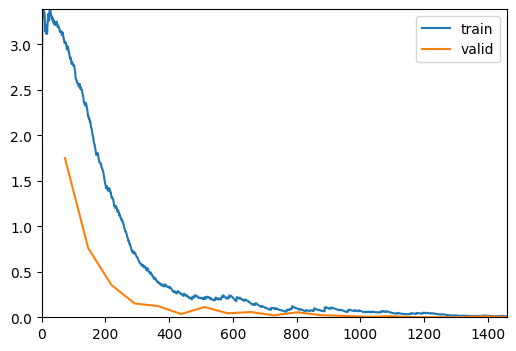

Better model found at epoch 1 with f1_score value: 0.5398574561403509.


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 2 with f1_score value: 0.8050245098039215.


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 5 with f1_score value: 1.0.


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
wd = 1e-2
TRAIN_EPOCH = 20
learn = learner
callbacks = [
    SaveModelCallback(monitor='f1_score', fname='best_model_stg1', with_opt=False),
    ShowGraphCallback(),
    EarlyStoppingCallback(monitor='valid_loss', patience=5)
]

learn.fit_one_cycle(TRAIN_EPOCH, lr_max=lr, wd=wd, cbs=callbacks)

#### Results

/usr/local/lib/python3.12/dist-packages/fastai/callback/fp16.py:47: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  self.autocast,self.learn.scaler,self.scales = autocast(dtype=dtype),GradScaler(**self.kwargs),L()
/usr/local/lib/python3.12/dist-packages/fastai/callback/fp16.py:47: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.autocast,self.learn.scaler,self.scales = autocast(dtype=dtype),GradScaler(**self.kwargs),L()


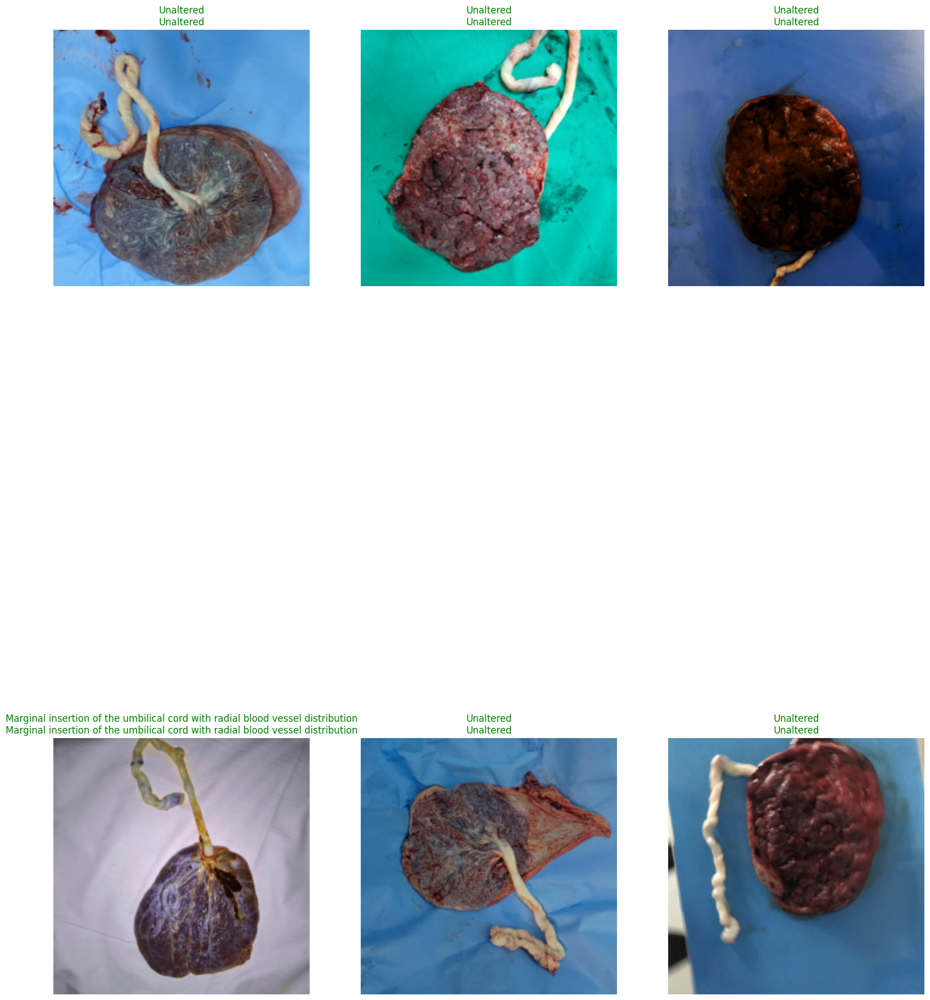

In [ ]:
get_learner(data, 'best_model_stg1').show_results(
    max_n=6, figsize=(20, 30)
)

### Finetuning

In [ ]:
'''
learner = get_learner(data, 'best_model_stg1', True)
learner.lr_find()
'''

print('Skipped since finetuning not needed')

Skipped since finetuning not needed


In [ ]:
'''
lr = slice(1.44e-5, 8e-5)
wd = 1e-2
TRAIN_EPOCH = 20
callbacks = [
    SaveModelCallback(monitor='f1_score', fname='best_model_stg2', with_opt=False),
    ShowGraphCallback(),
    EarlyStoppingCallback(monitor='valid_loss', patience=3)
]

learn.fit_one_cycle(TRAIN_EPOCH, lr_max=lr, wd=wd, cbs=callbacks)
'''

print('Skipped since finetuning not needed')

Skipped since finetuning not needed


### Test

#### Setup

In [ ]:
# Defina o tamanho do seu lote de imagens para processamento pela rede
batch_size = 1

image_size = (224, 224)

# Carregue os dados usando função nativa do fast.ai
data_test = ImageDataLoaders.from_folder(
    DATASET_PATH,
    train='test',
    valid='test',
    test='test',
    bs=batch_size,
    item_tfms=Resize(image_size),
    batch_tfms=Normalize.from_stats(*imagenet_stats)
)

In [ ]:
learner = get_learner(data_test, 'best_model_stg1')
test_dataset = data_test.valid_ds

#### Functions

In [ ]:
from IPython.display import Image

def gt_classifications(ds):
    for (img, cls) in ds:
        yield Classification(int(cls))

def pred_classifications(ds):
    for (img, cls) in ds:
        (cls_name, pred_cls, scores) = learner.predict(img)
        yield Classification(int(pred_cls), scores[int(pred_cls)])

def top2(img):
  pred_class, pred_idxs, outputs = learner.predict(img)
  top_2_conf, i = outputs.topk(2)
  itr = 0
  classes = learner.dls.classes
  for x in i:
    print("Class: %s, Probability: %.4f %%"%(classes[x.item()], top_2_conf[itr].item()*100))
    itr=itr+1
  print()

def get_prediction(img, correct_class):
  pred_class, pred_idxs, outputs = learner.predict(img)
  classes = data_test.classes
  out = list(outputs)
  index = classes.index(correct_class)
  prediction = out[index]
  print("%.10f %%"%(prediction.item()*100))
  print()

#### Results

In [ ]:
evaluation_test = evaluate_classification(
    gt_classifications(test_dataset), pred_classifications(test_dataset), test_dataset.vocab
)

print(evaluation_test)

0 samples [00:00, ? samples/s]

/usr/local/lib/python3.12/dist-packages/fastai/callback/fp16.py:47: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  self.autocast,self.learn.scaler,self.scales = autocast(dtype=dtype),GradScaler(**self.kwargs),L()
/usr/local/lib/python3.12/dist-packages/fastai/callback/fp16.py:47: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.autocast,self.learn.scaler,self.scales = autocast(dtype=dtype),GradScaler(**self.kwargs),L()


Classification Metrics:
	Sample Count: 78
	Accuracy: 0.9487179487179487
	Avg Recall: 0.7321428571428571
	Avg Precision: 0.7424242424242424
	Avg Specificity: 0.96875
	Avg FPR: 0.03125
	Avg F-Score: 0.7364783653846154

By Class:

Greenish membranes:
	TP: 1
	TN: 77
	FP: 0
	FN: 0
	FPR: 0.0
	Accuracy: 1.0
	Recall: 1.0
	Precision: 1
	Specificity: 1.0
	F-Score: 1.0
Irregular placental disc:
	TP: 0
	TN: 77
	FP: 0
	FN: 1
	FPR: 0.0
	Accuracy: 0.9871794871794872
	Recall: 0.0
	Precision: nan
	Specificity: 1.0
	F-Score: 0.0
Marginal insertion of the umbilical cord with radial blood vessel distribution:
	TP: 2
	TN: 76
	FP: 0
	FN: 0
	FPR: 0.0
	Accuracy: 1.0
	Recall: 1.0
	Precision: 1
	Specificity: 1.0
	F-Score: 1.0
Opaque placental membranes:
	TP: 2
	TN: 76
	FP: 0
	FN: 0
	FPR: 0.0
	Accuracy: 1.0
	Recall: 1.0
	Precision: 1
	Specificity: 1.0
	F-Score: 1.0
Oval-shaped disc:
	TP: 1
	TN: 77
	FP: 0
	FN: 0
	FPR: 0.0
	Accuracy: 1.0
	Recall: 1.0
	Precision: 1
	Specificity: 1.0
	F-Score: 1.0
Peripheral cord in

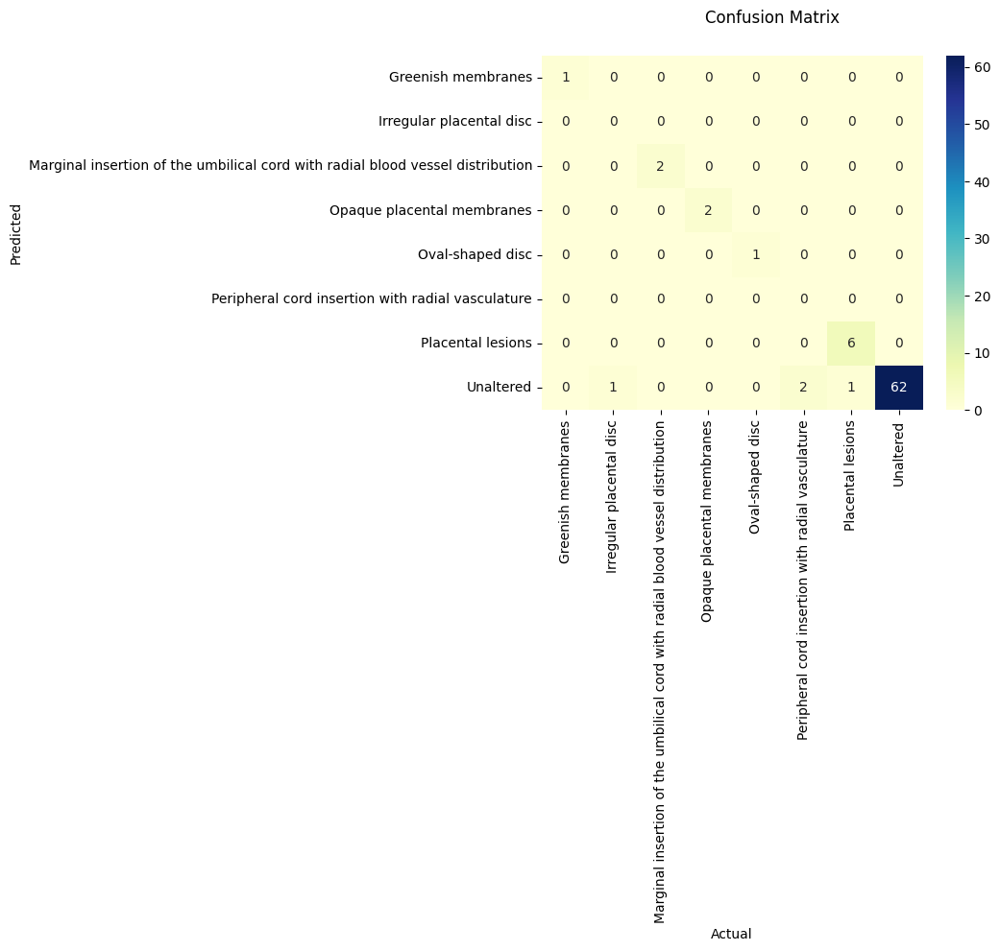

(<Figure size 640x480 with 2 Axes>,
 <Axes: xlabel='Actual', ylabel='Predicted'>)

In [ ]:
evaluation_test.show_confusion_matrix()

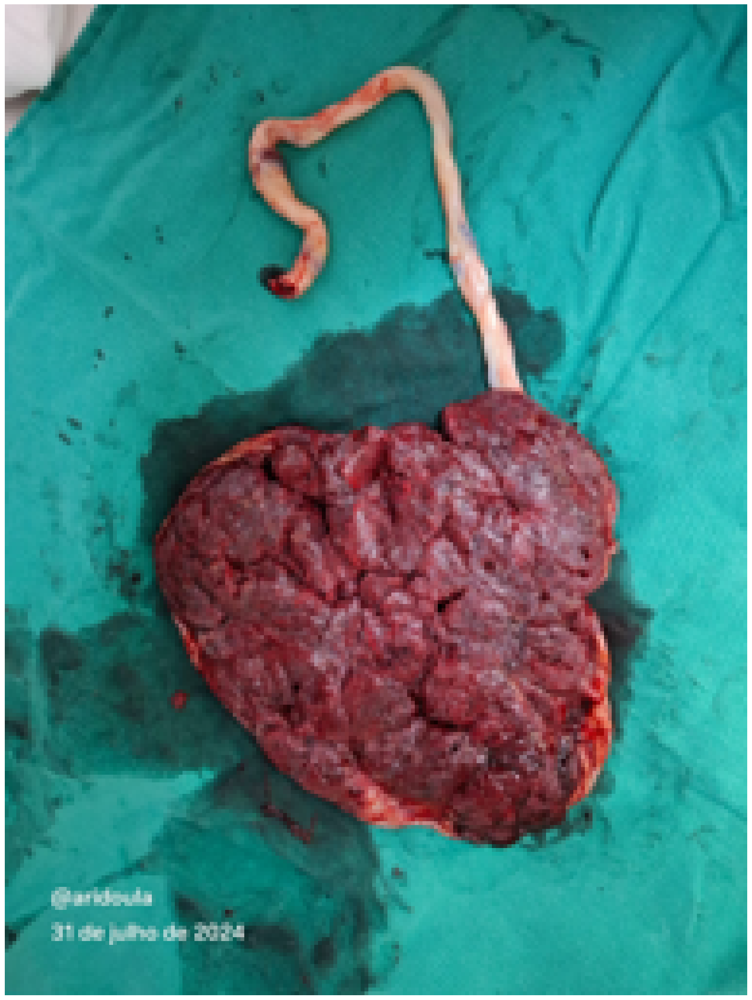

/usr/local/lib/python3.12/dist-packages/fastai/callback/fp16.py:47: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  self.autocast,self.learn.scaler,self.scales = autocast(dtype=dtype),GradScaler(**self.kwargs),L()
/usr/local/lib/python3.12/dist-packages/fastai/callback/fp16.py:47: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  self.autocast,self.learn.scaler,self.scales = autocast(dtype=dtype),GradScaler(**self.kwargs),L()


Predicted class: Unaltered


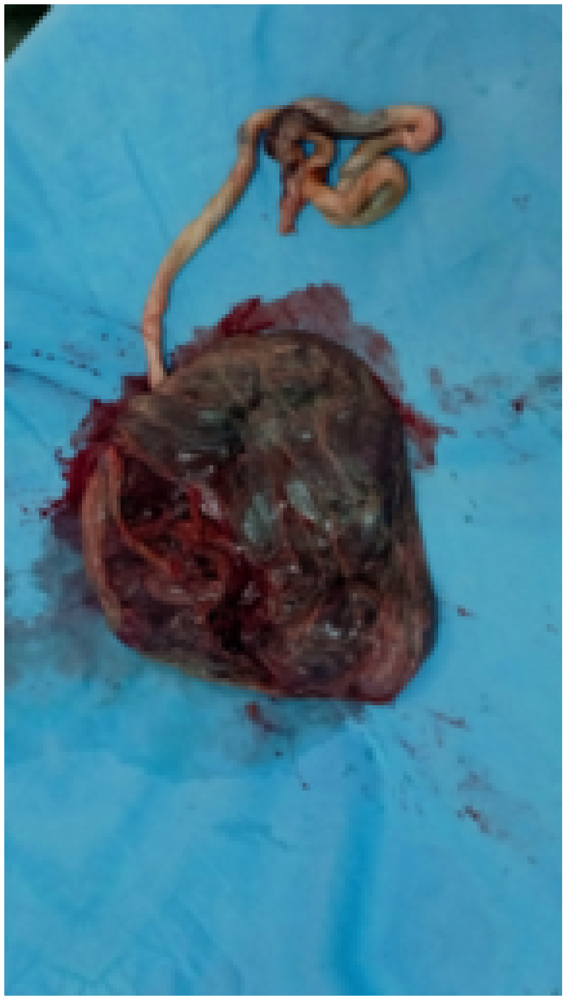

Predicted class: Greenish membranes


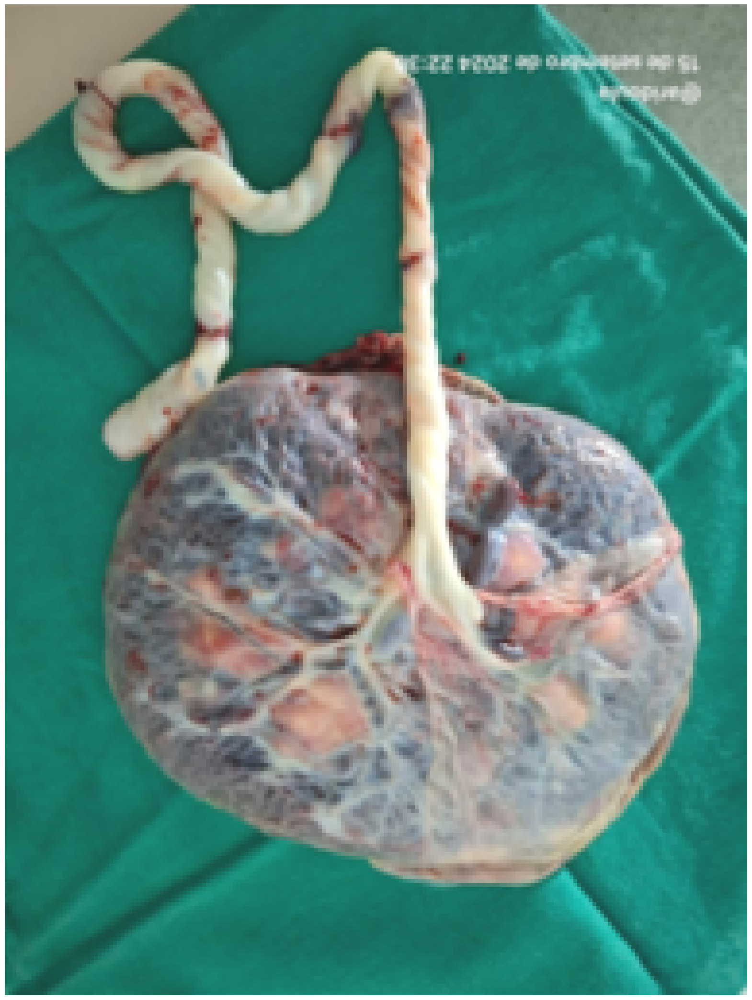

Predicted class: Opaque placental membranes


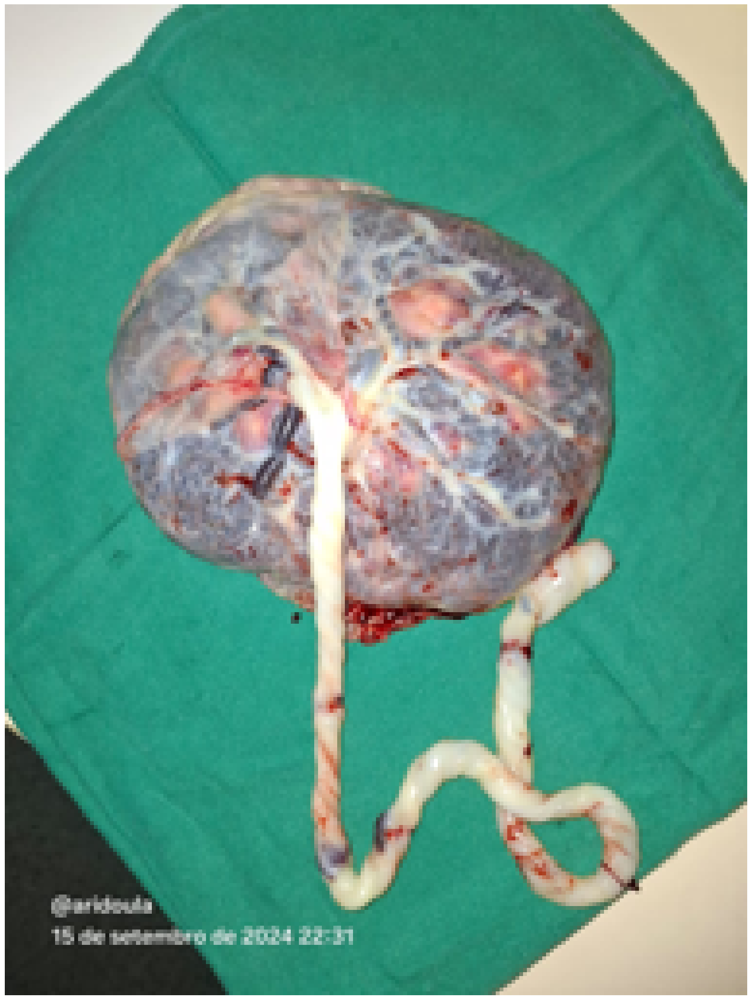

Predicted class: Opaque placental membranes


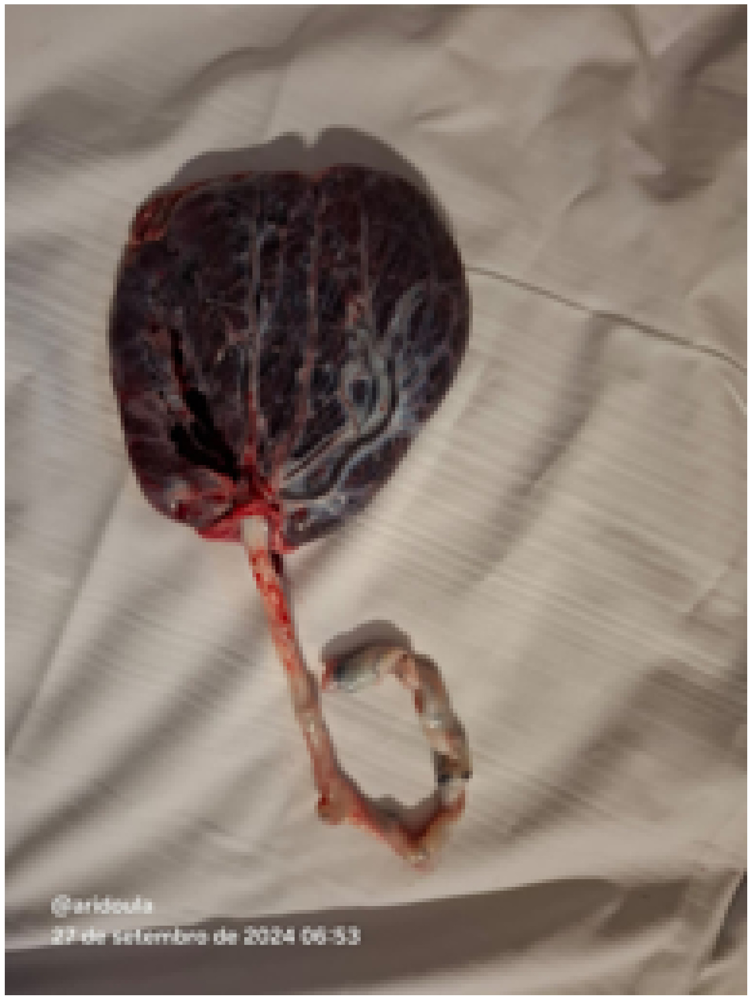

Predicted class: Marginal insertion of the umbilical cord with radial blood vessel distribution


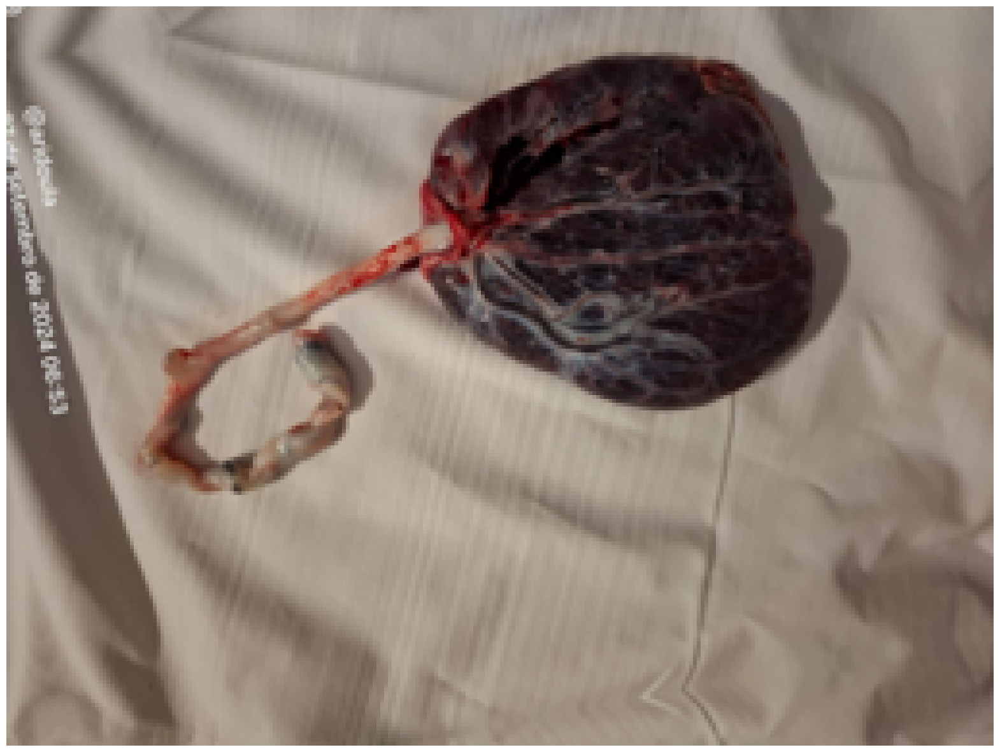

Predicted class: Marginal insertion of the umbilical cord with radial blood vessel distribution


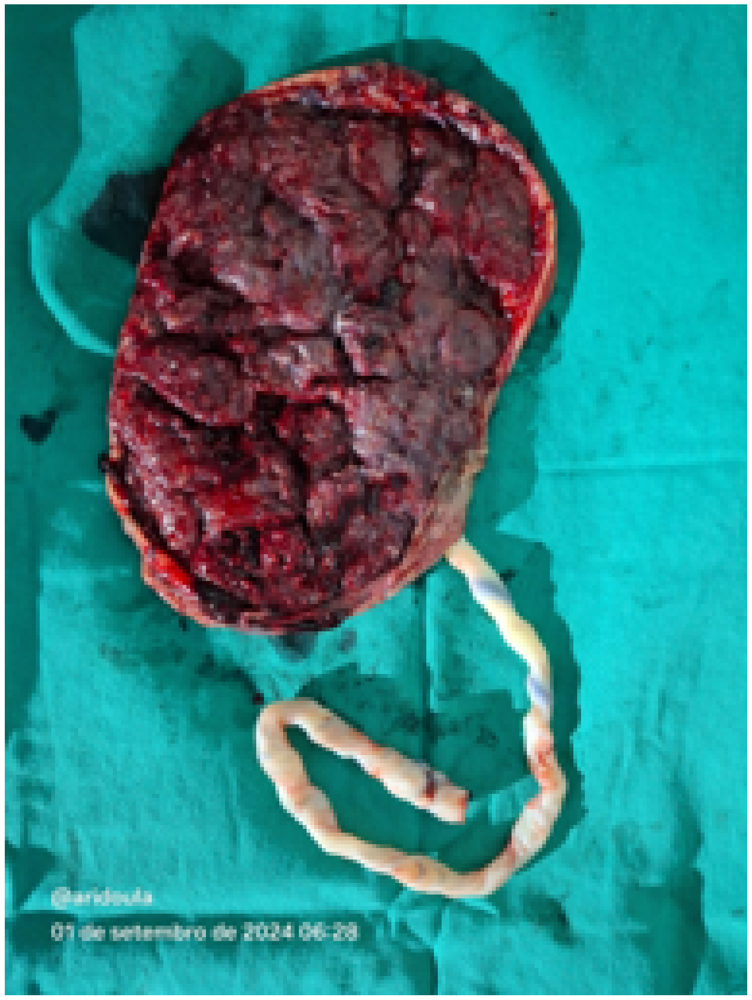

Predicted class: Oval-shaped disc


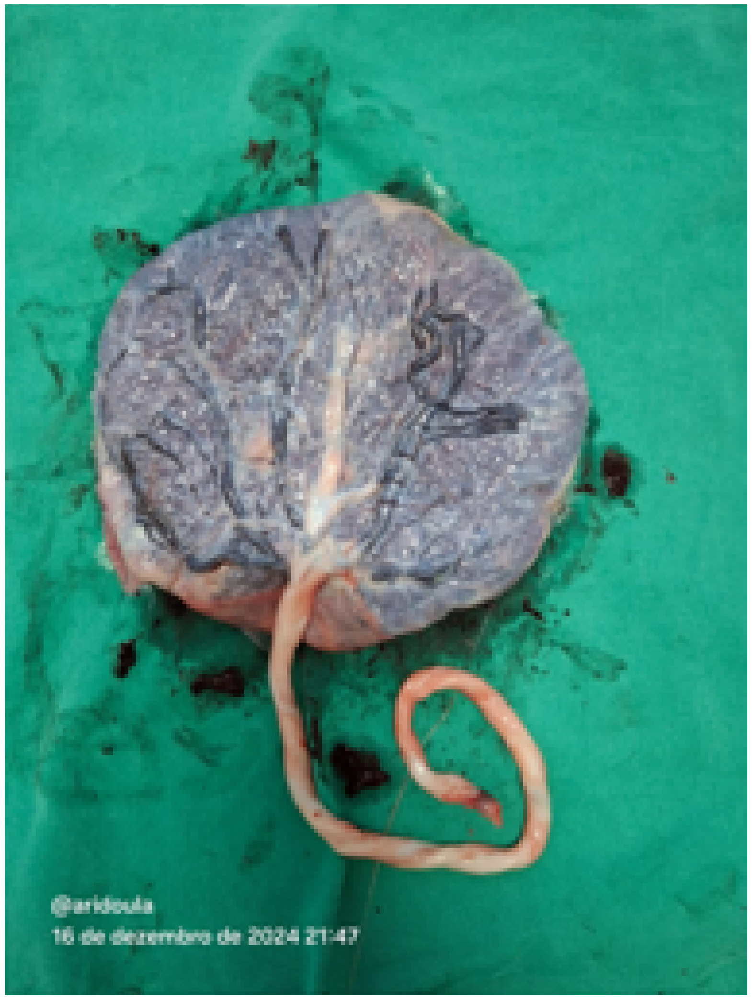

Predicted class: Unaltered


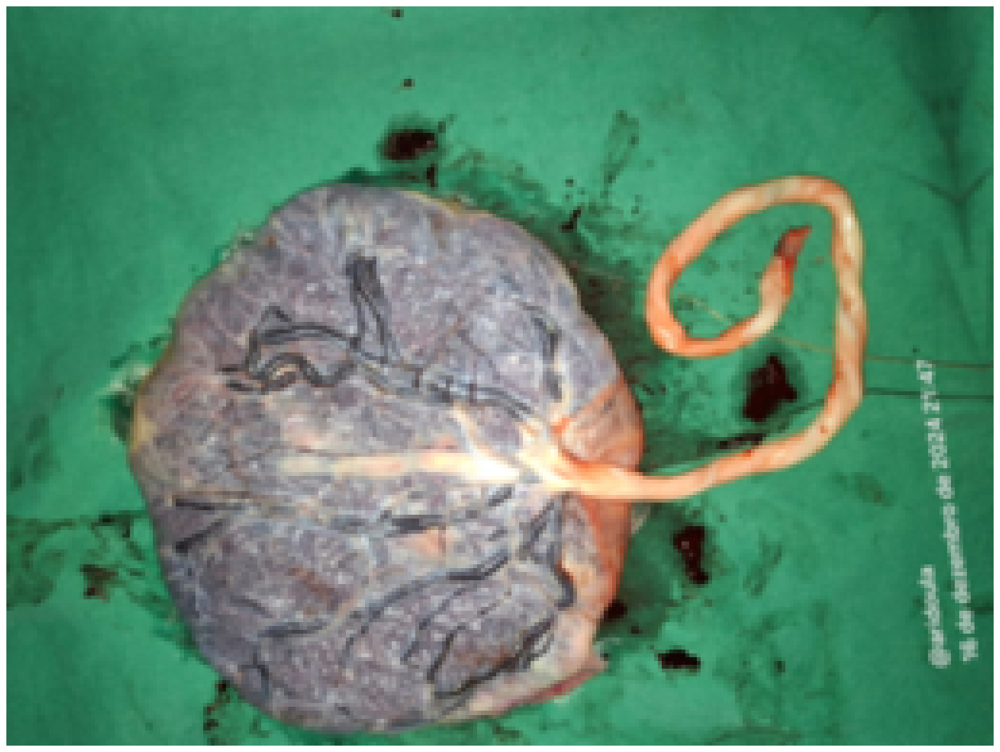

Predicted class: Unaltered


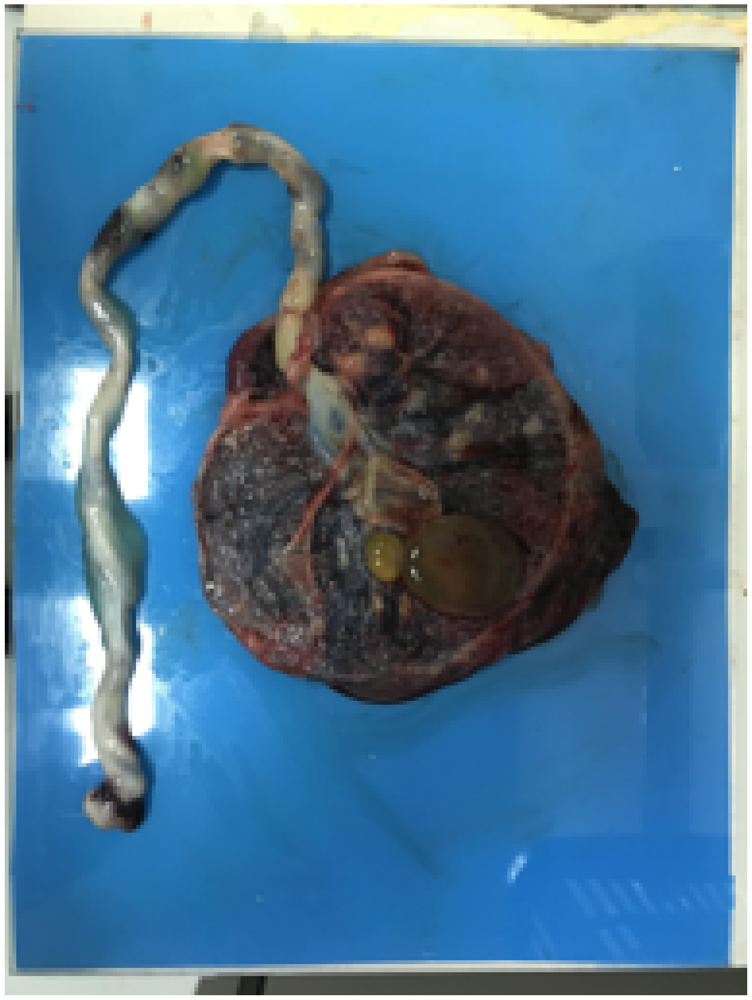

Predicted class: Placental lesions


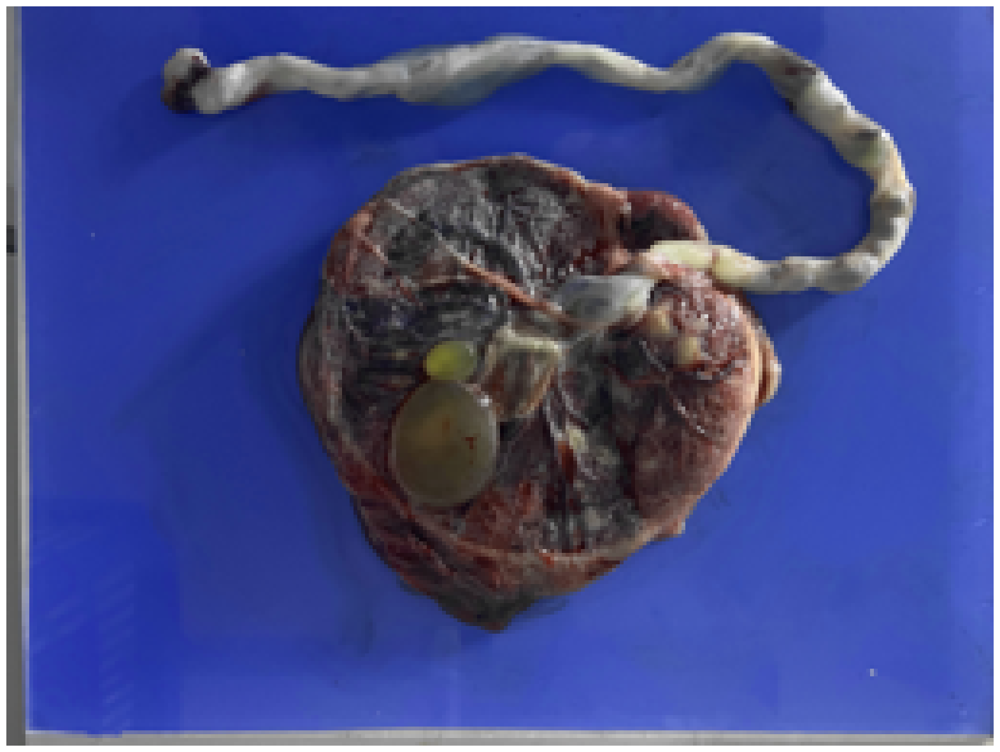

Predicted class: Placental lesions


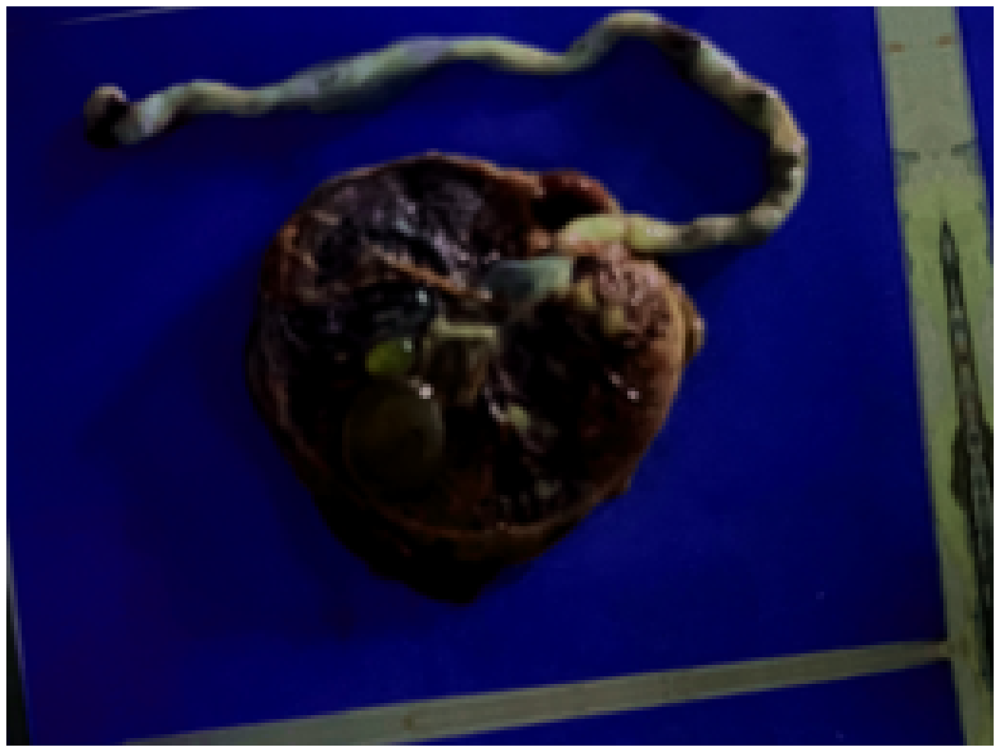

Predicted class: Unaltered


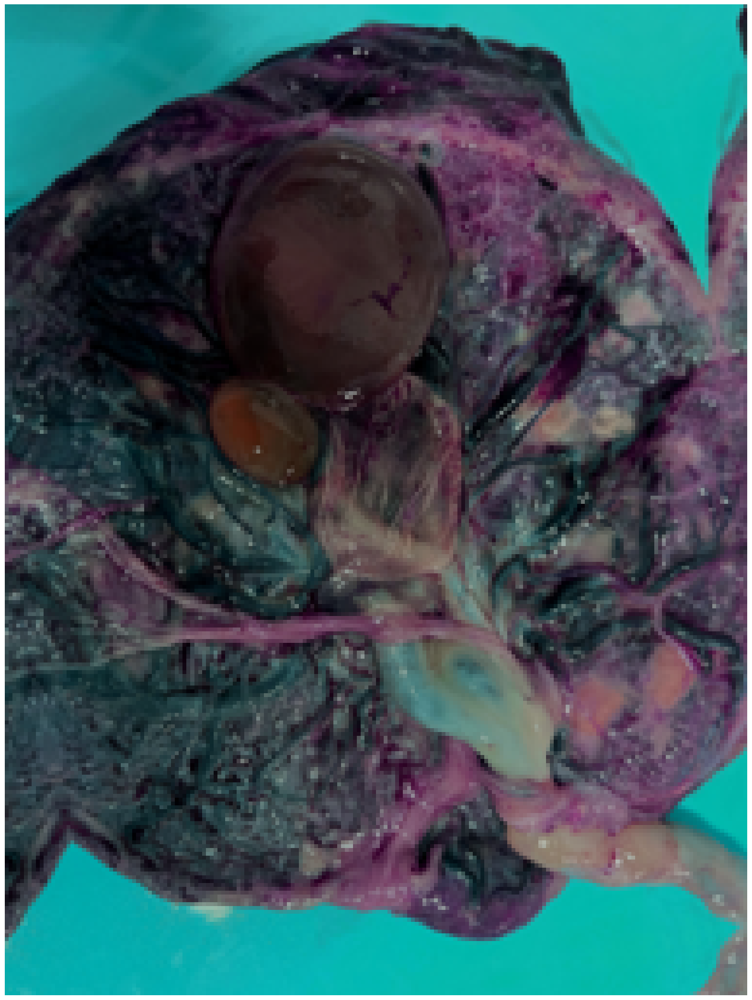

Predicted class: Placental lesions


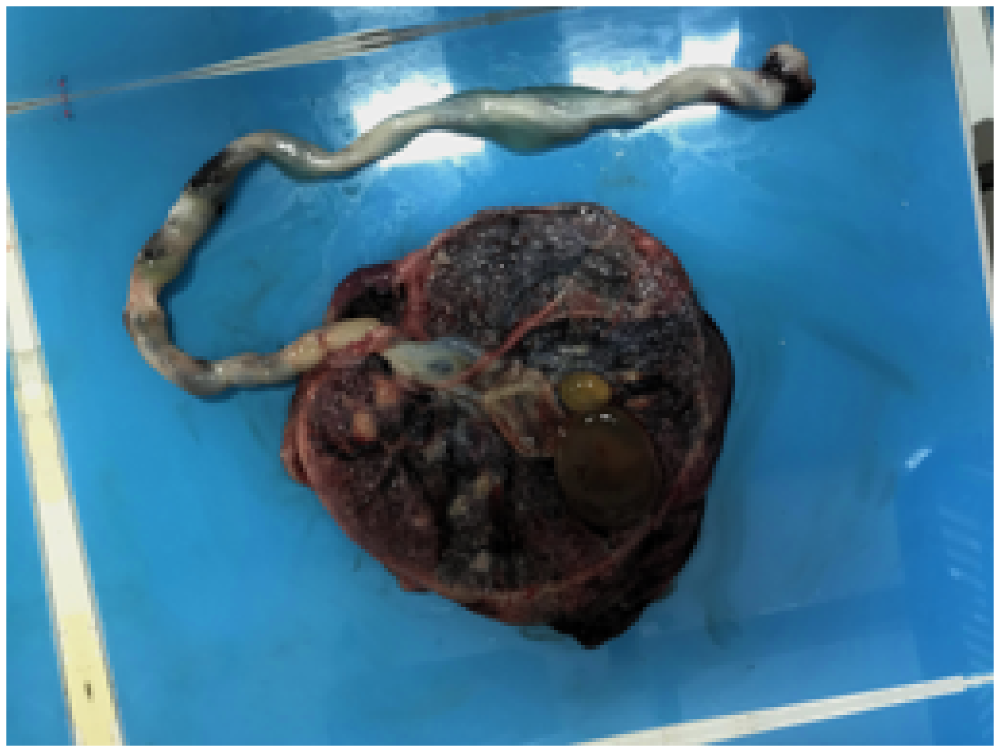

Predicted class: Placental lesions


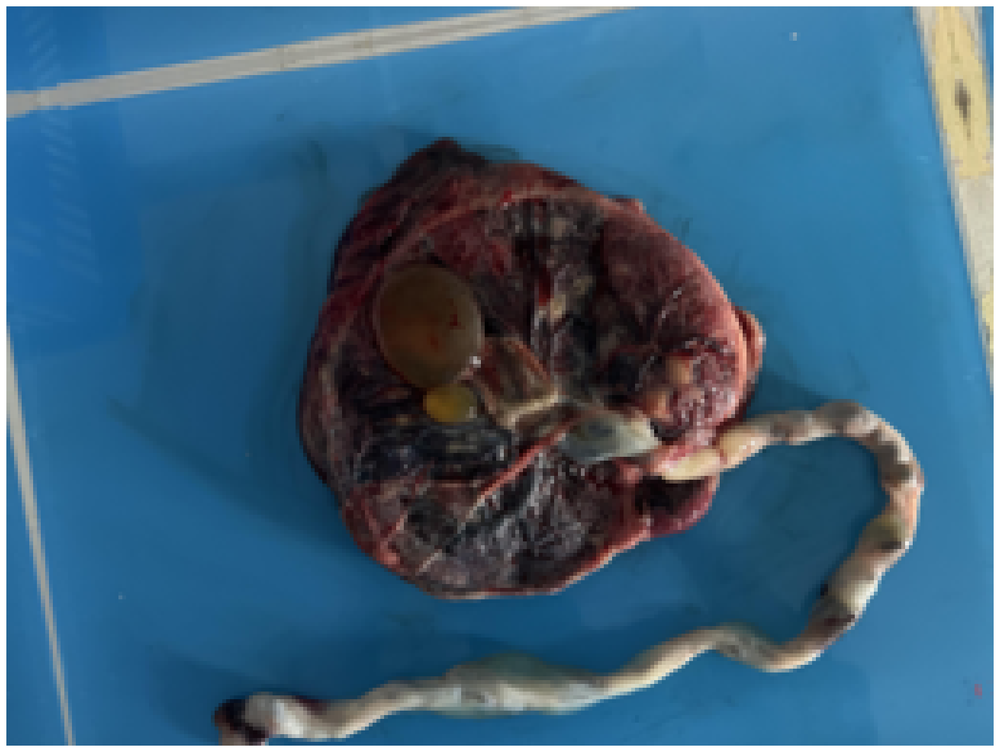

Predicted class: Placental lesions


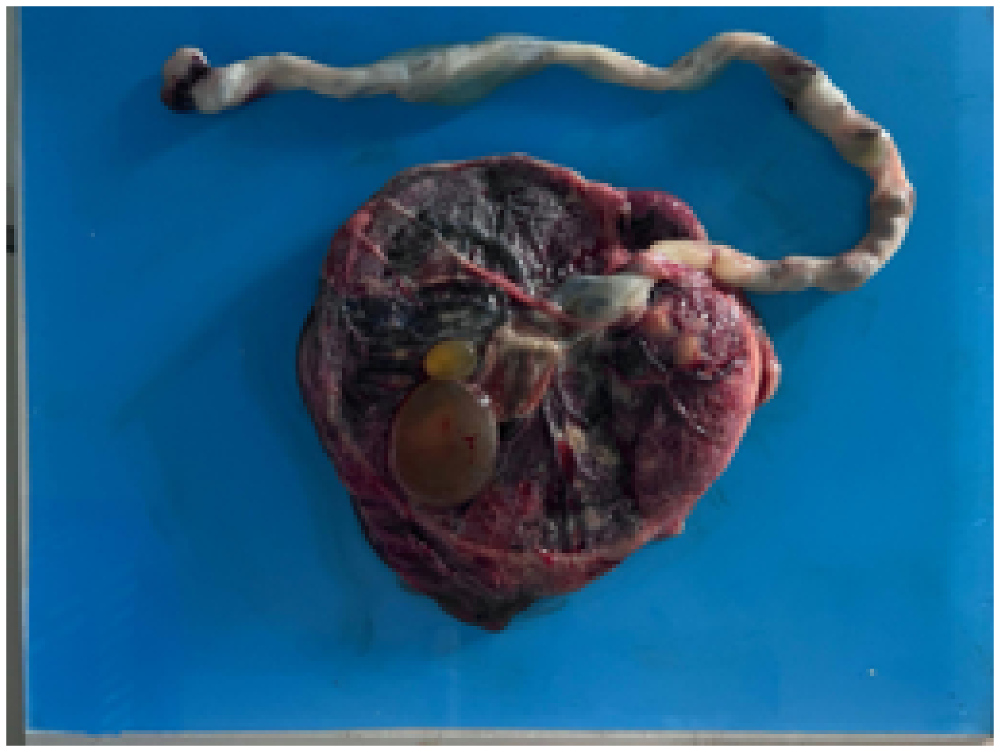

Predicted class: Placental lesions


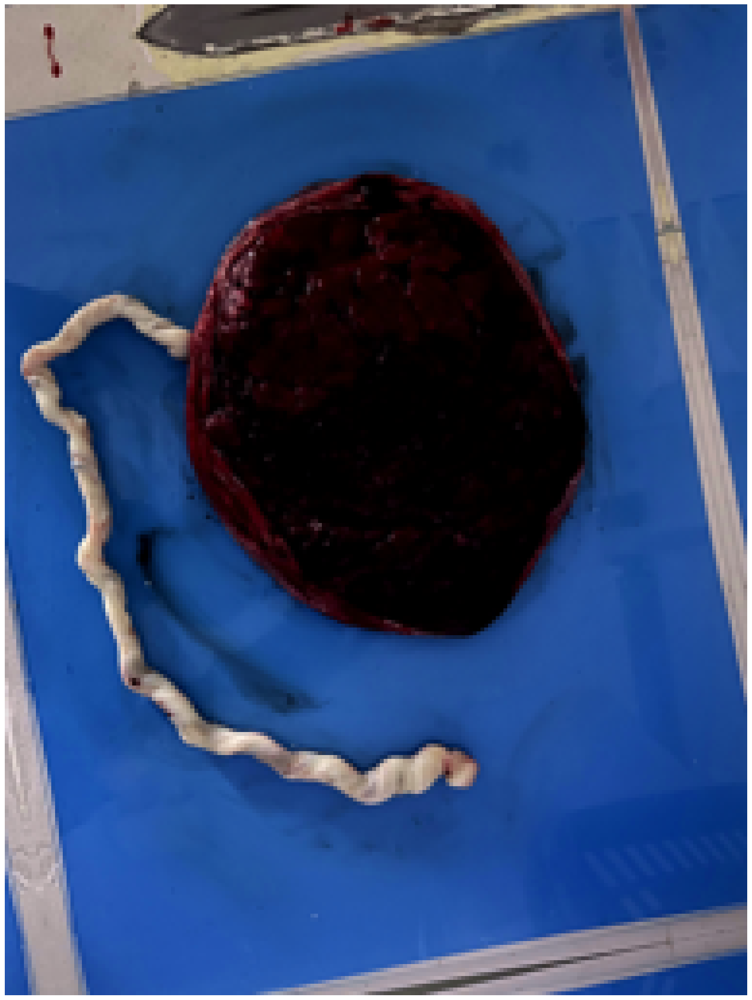

Predicted class: Unaltered


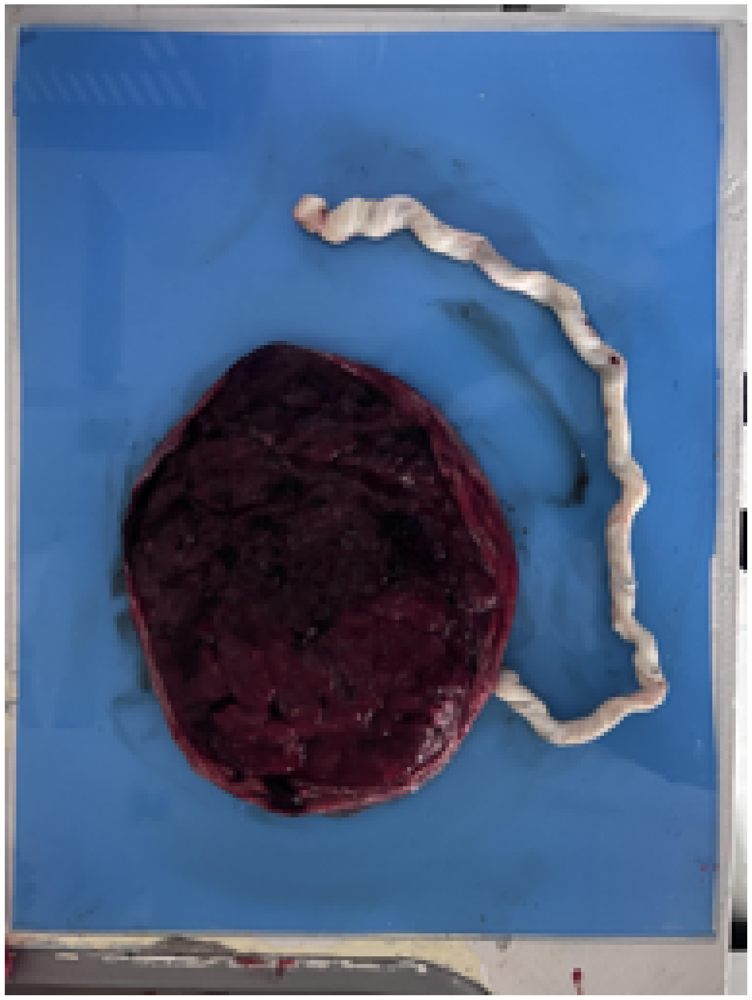

Predicted class: Unaltered


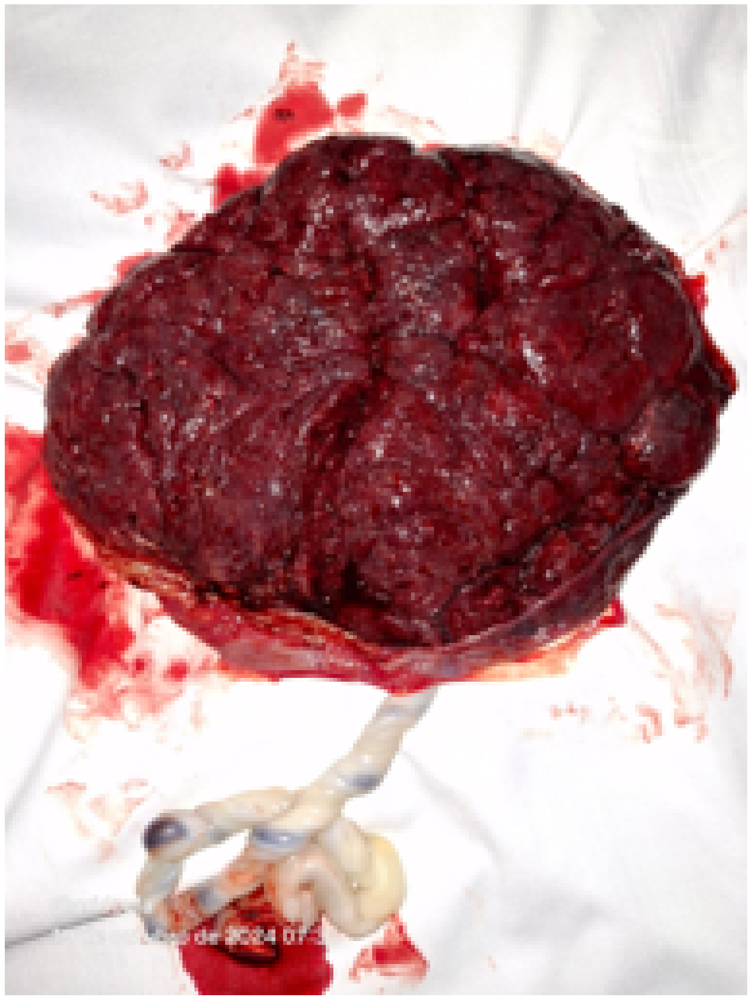

Predicted class: Unaltered


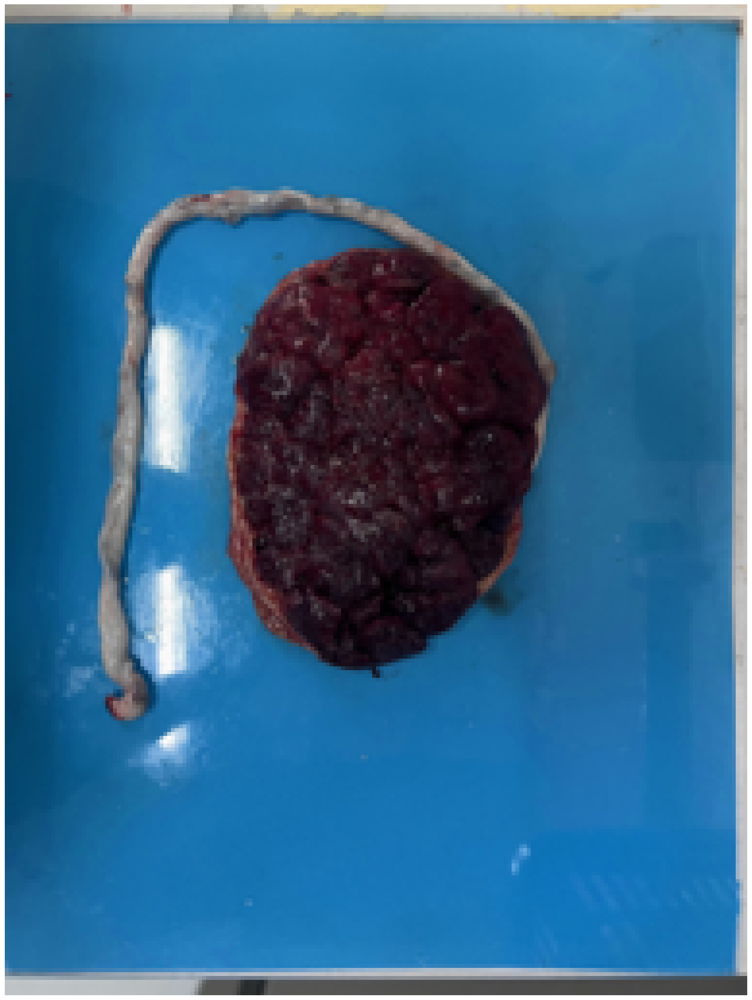

Predicted class: Unaltered


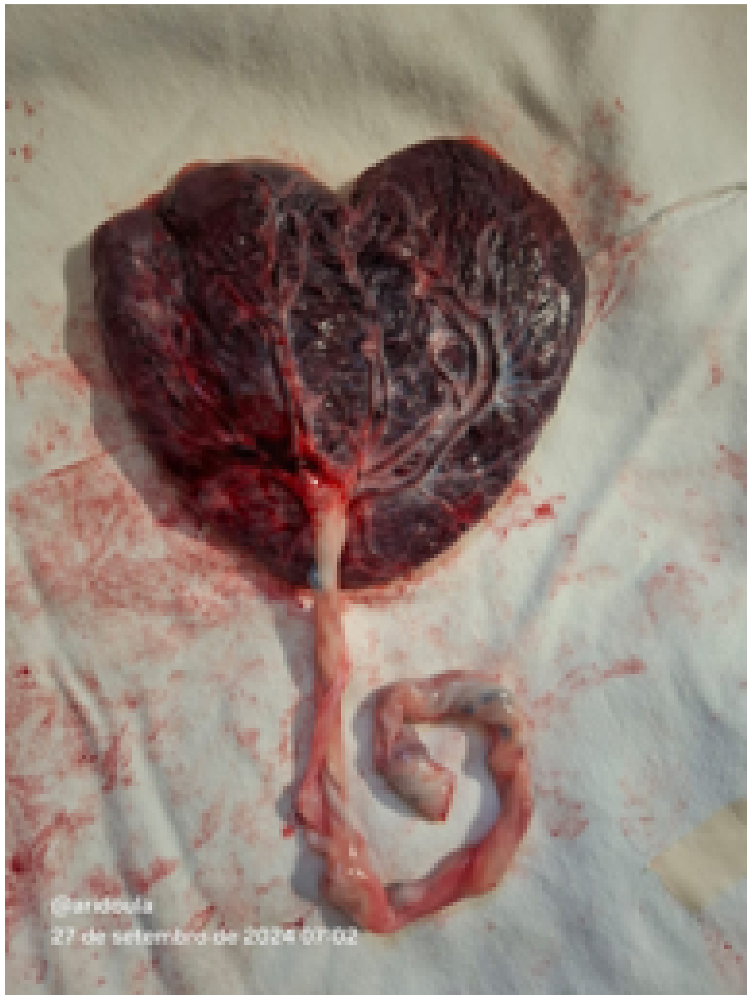

Predicted class: Unaltered


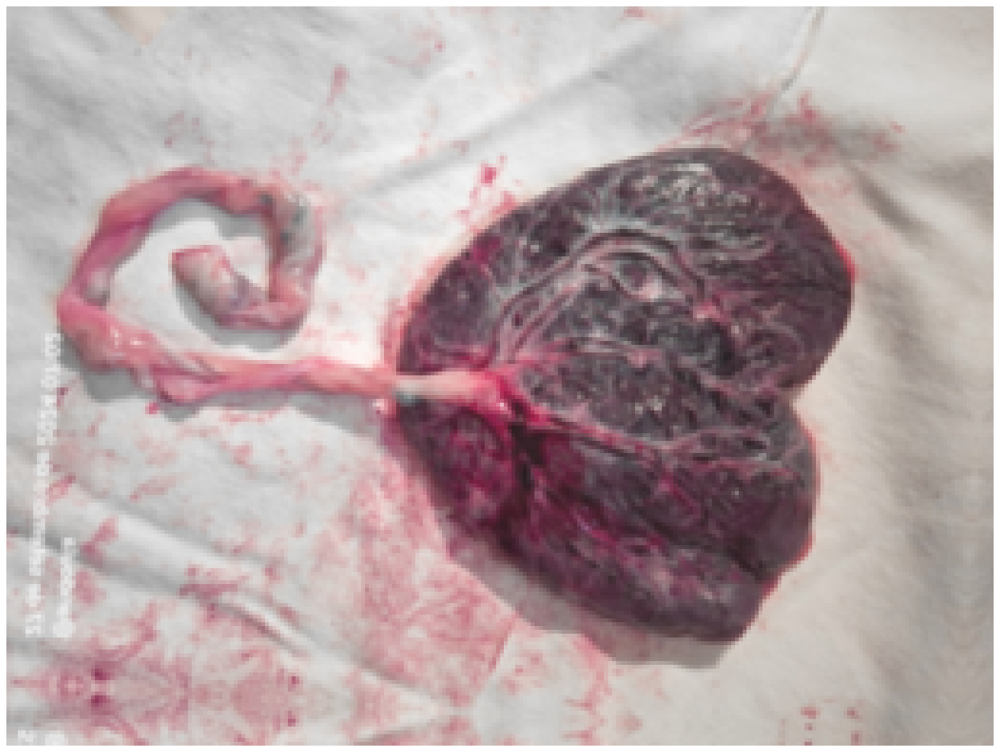

Predicted class: Unaltered


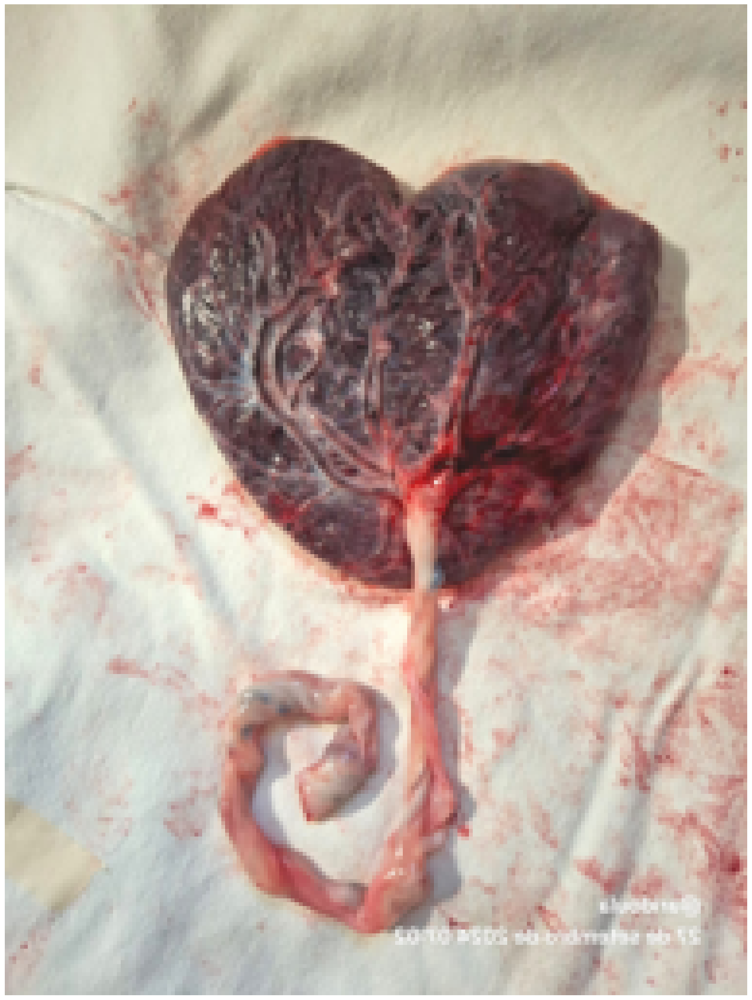

Predicted class: Unaltered


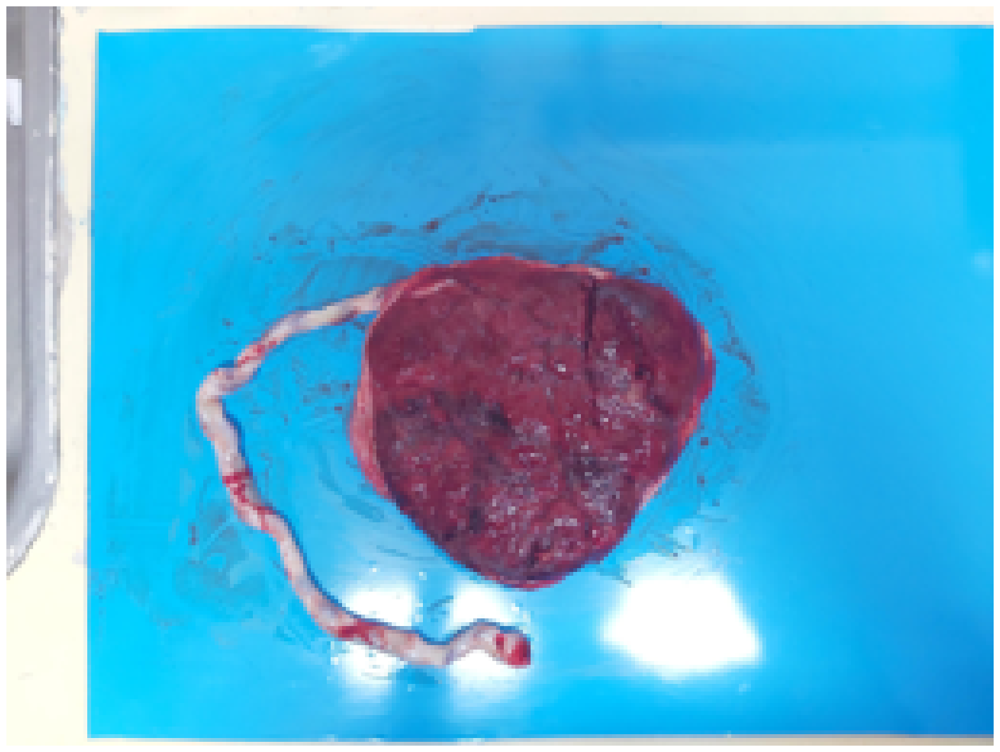

Predicted class: Unaltered


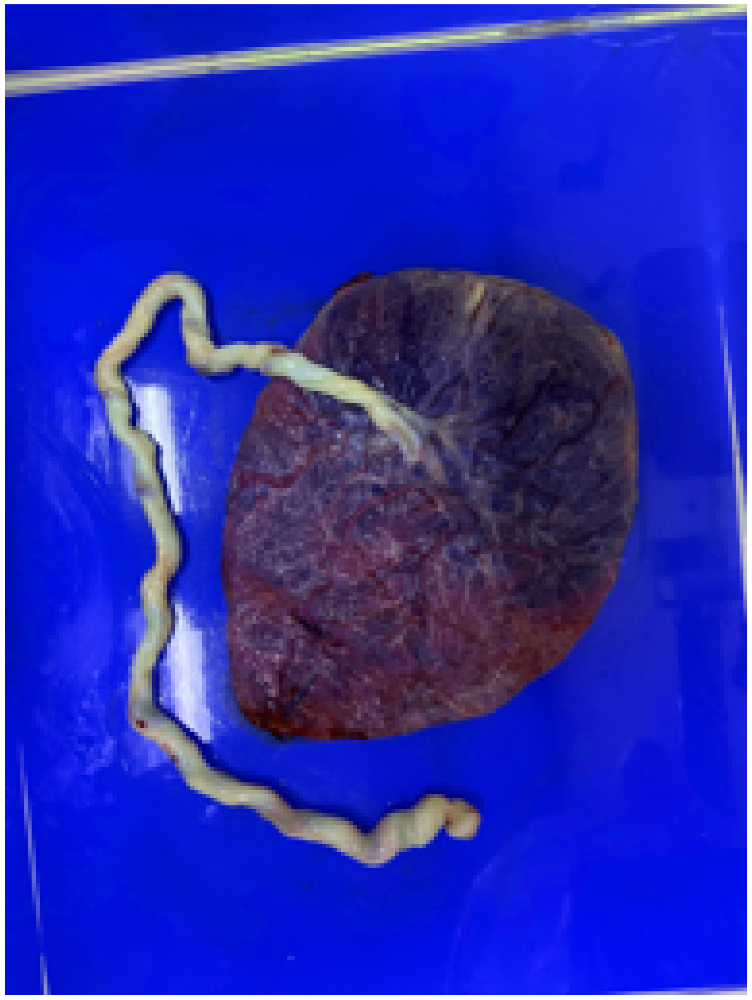

Predicted class: Unaltered


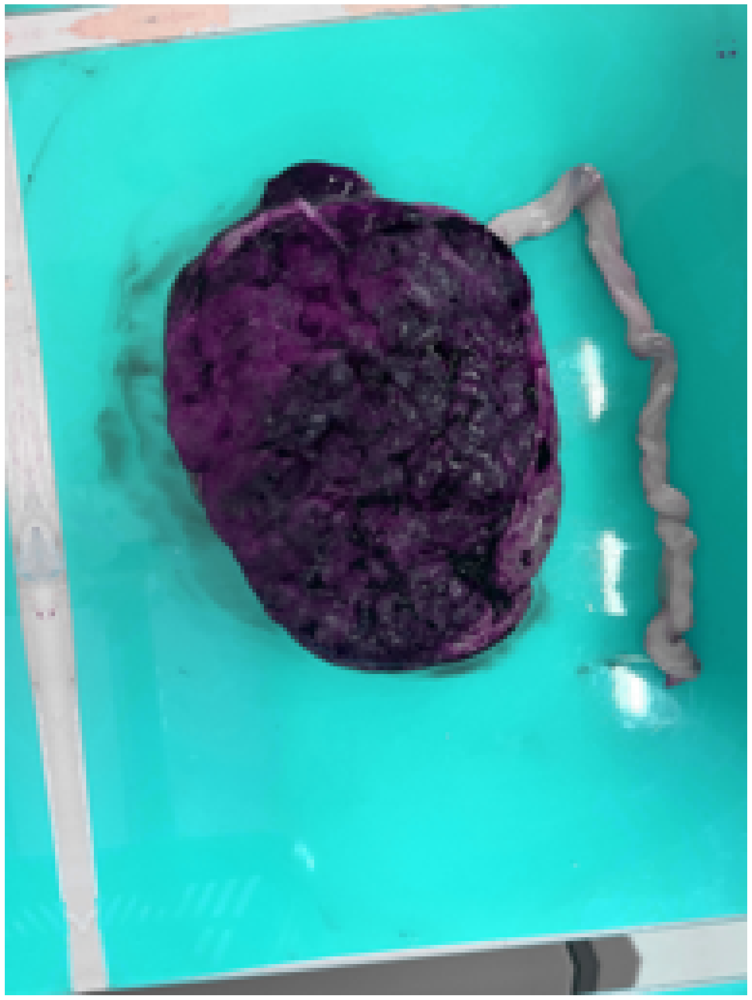

Predicted class: Unaltered


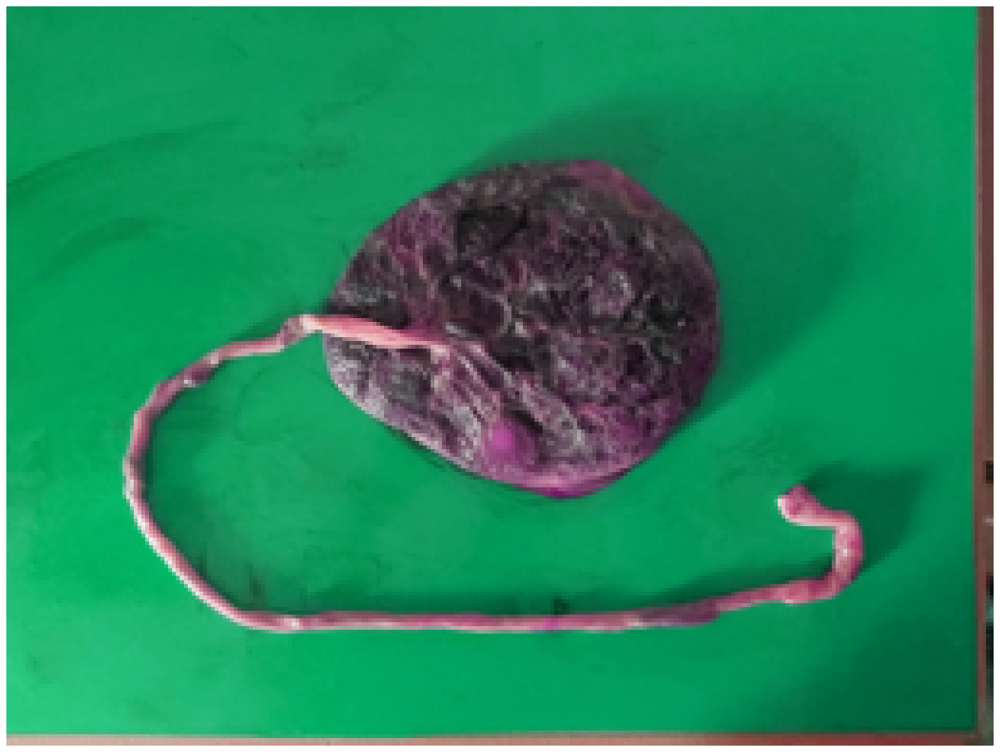

Predicted class: Unaltered


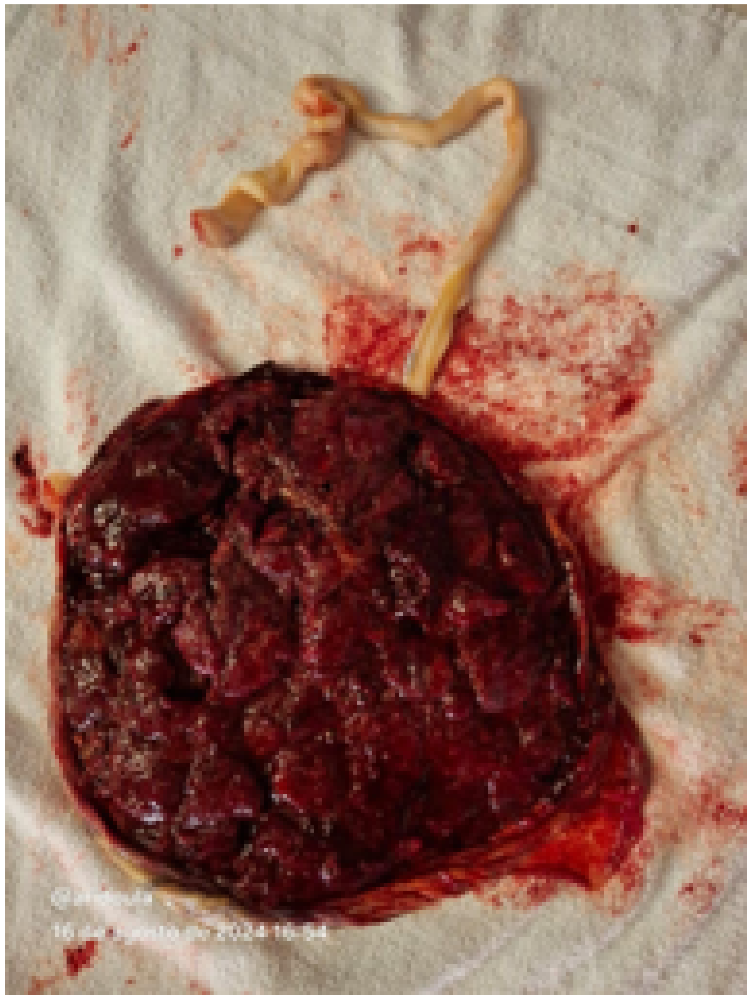

Predicted class: Unaltered


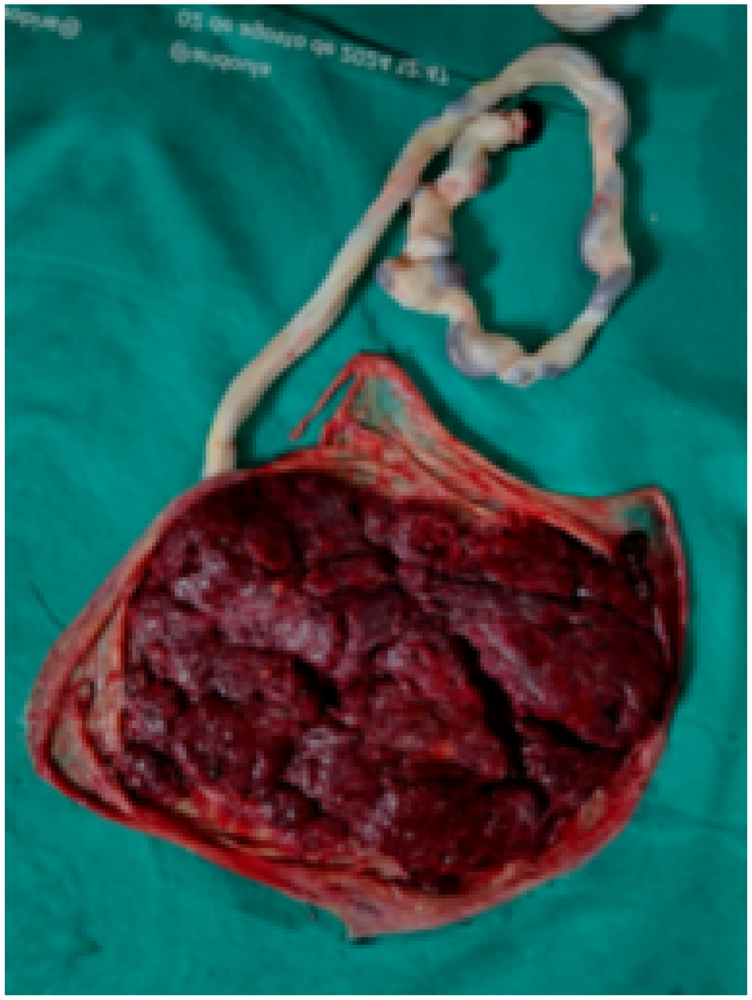

Predicted class: Unaltered


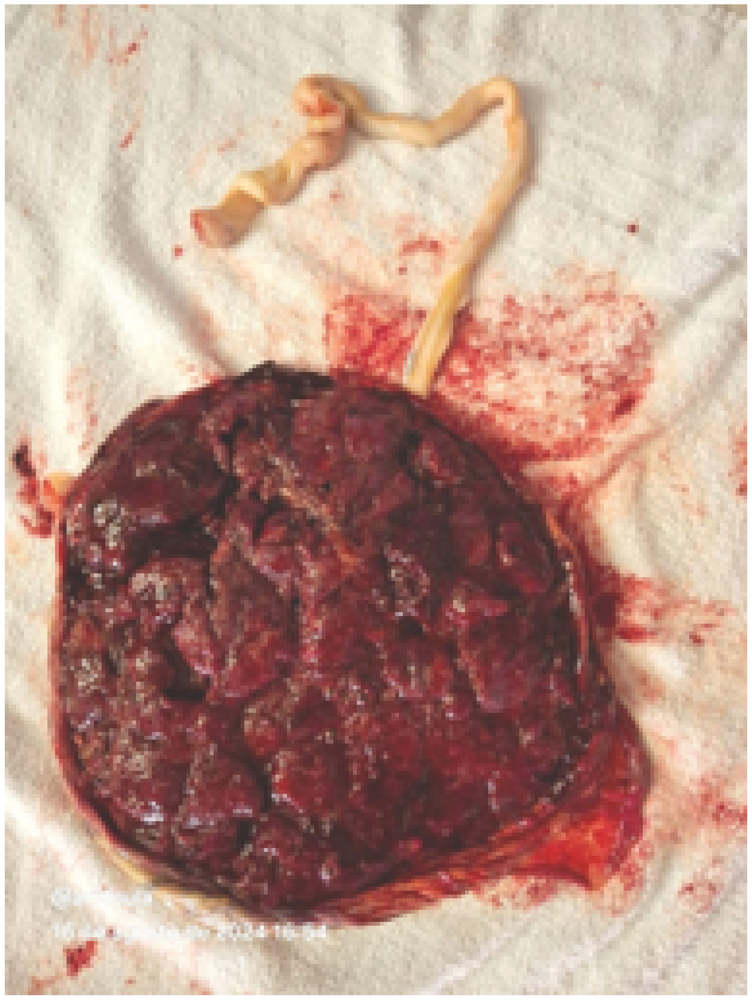

Predicted class: Unaltered


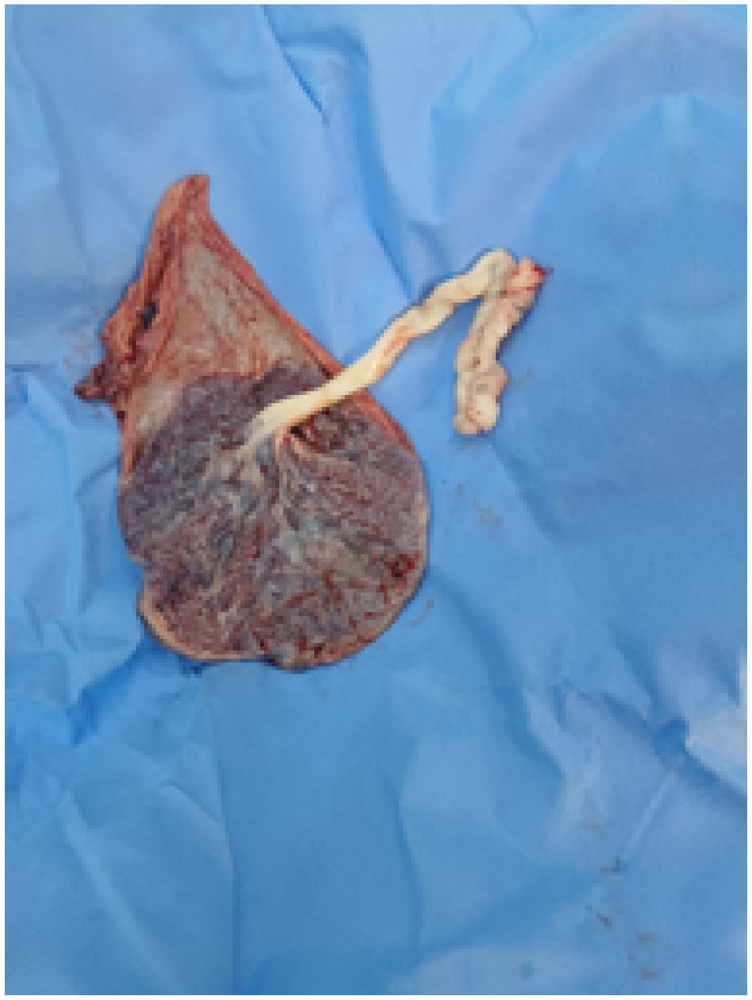

Predicted class: Unaltered


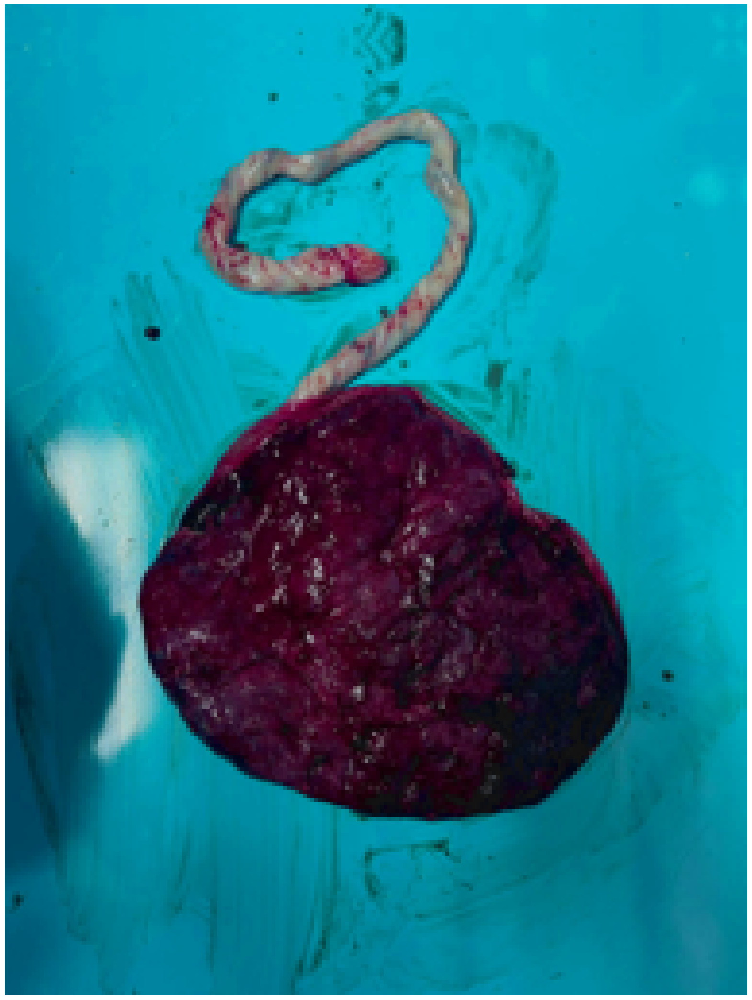

Predicted class: Unaltered


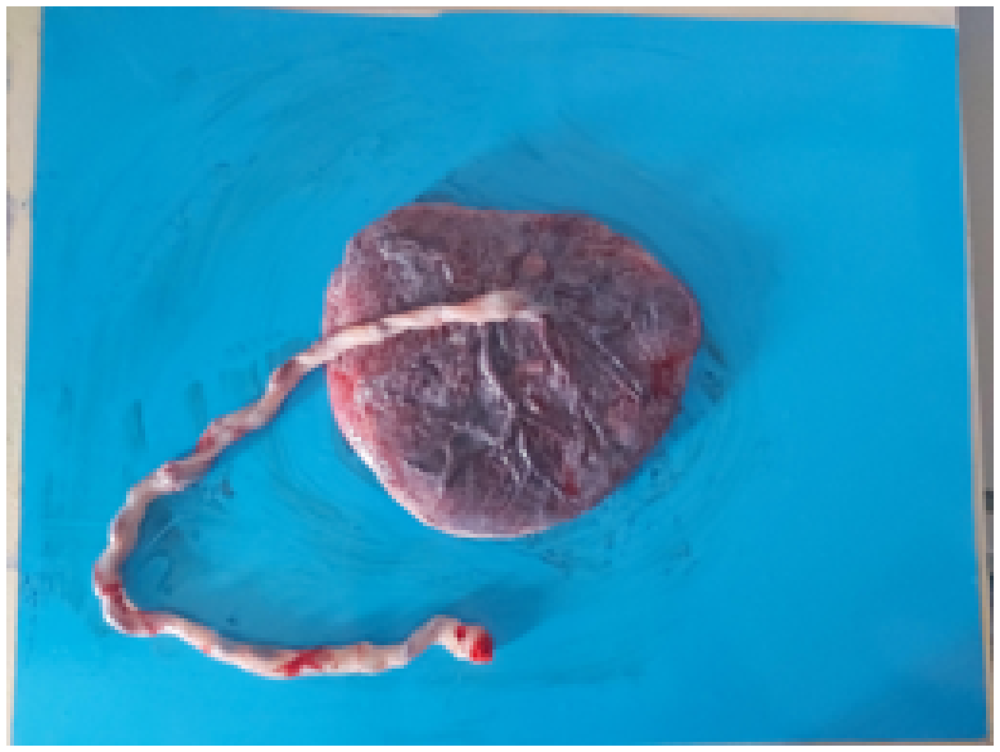

Predicted class: Unaltered


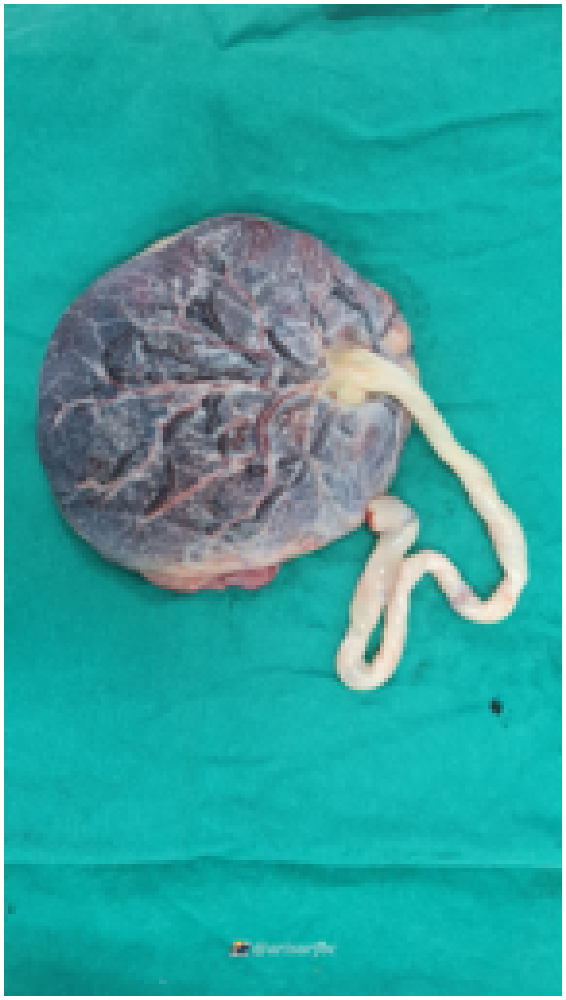

Predicted class: Unaltered


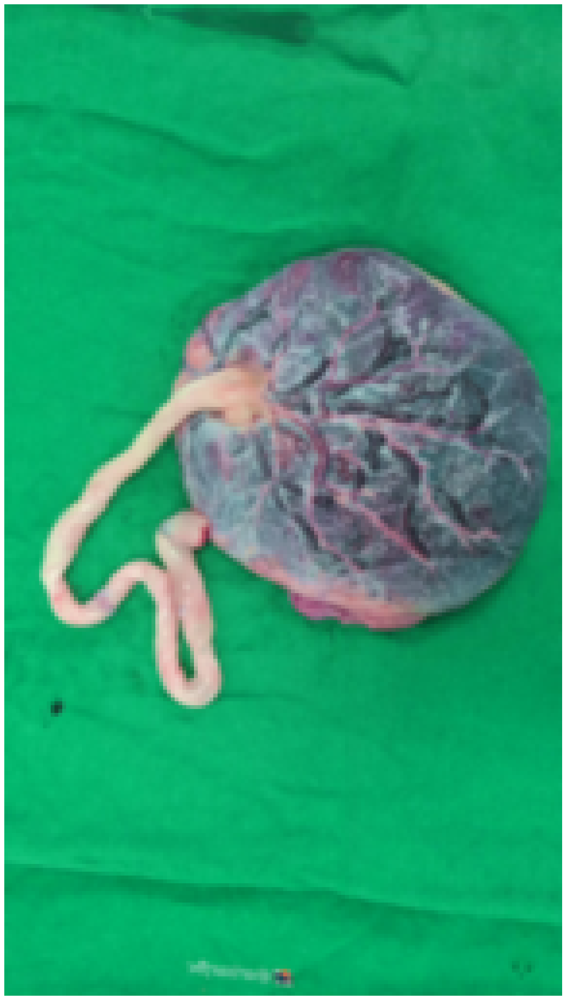

Predicted class: Unaltered


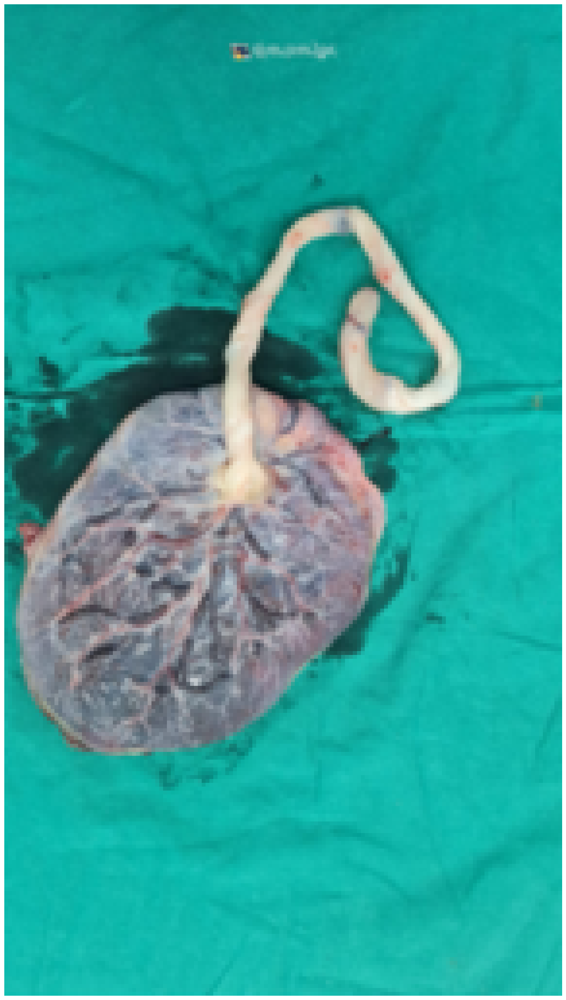

Predicted class: Unaltered


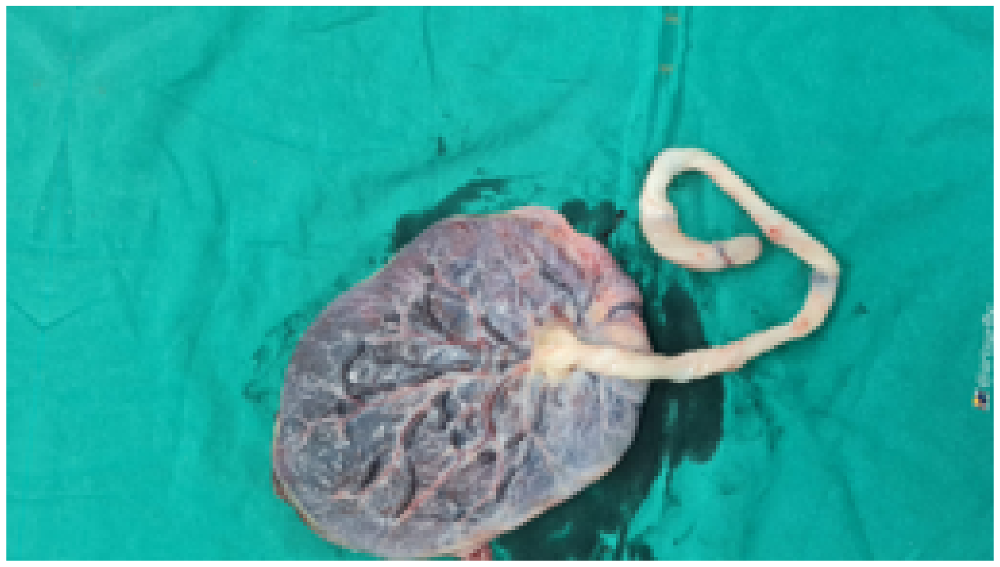

Predicted class: Unaltered


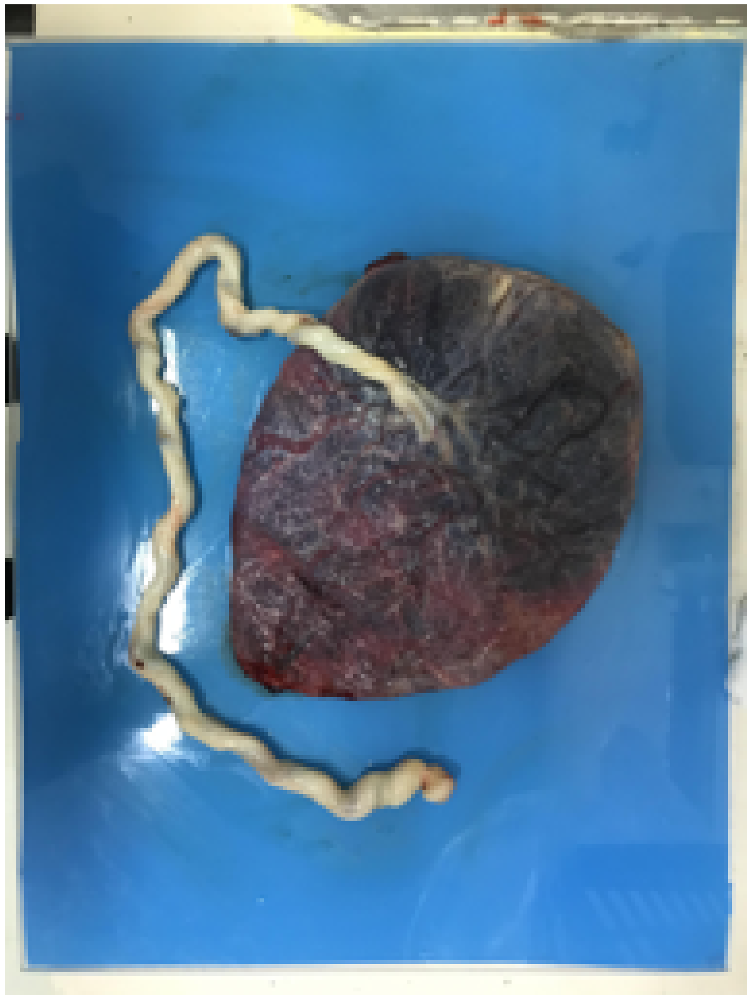

Predicted class: Unaltered


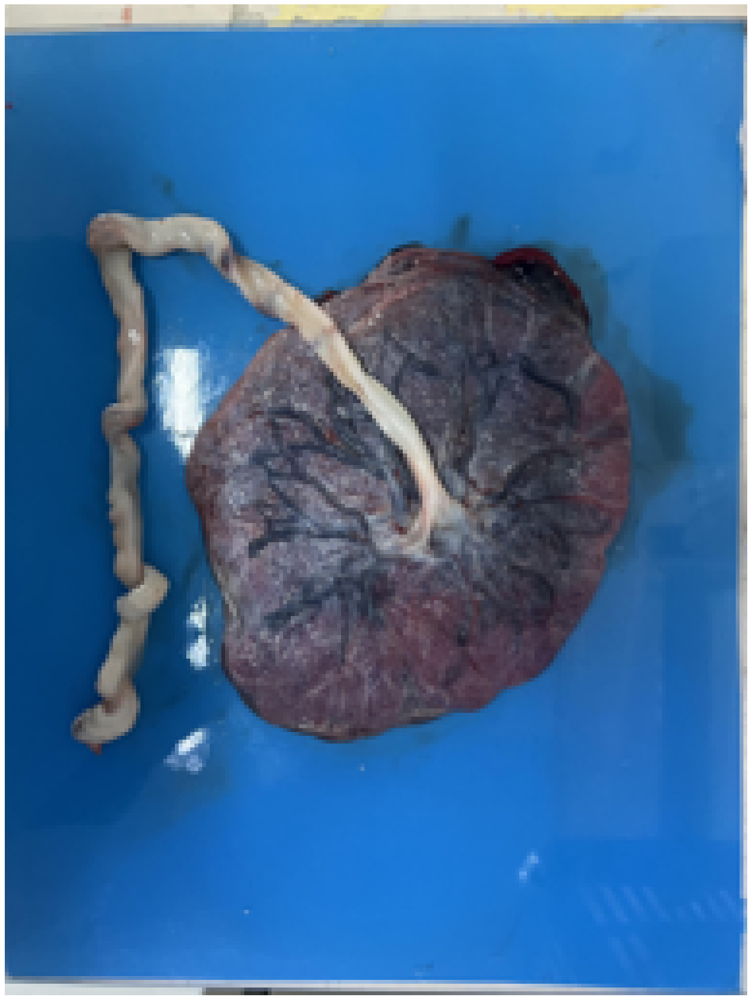

Predicted class: Unaltered


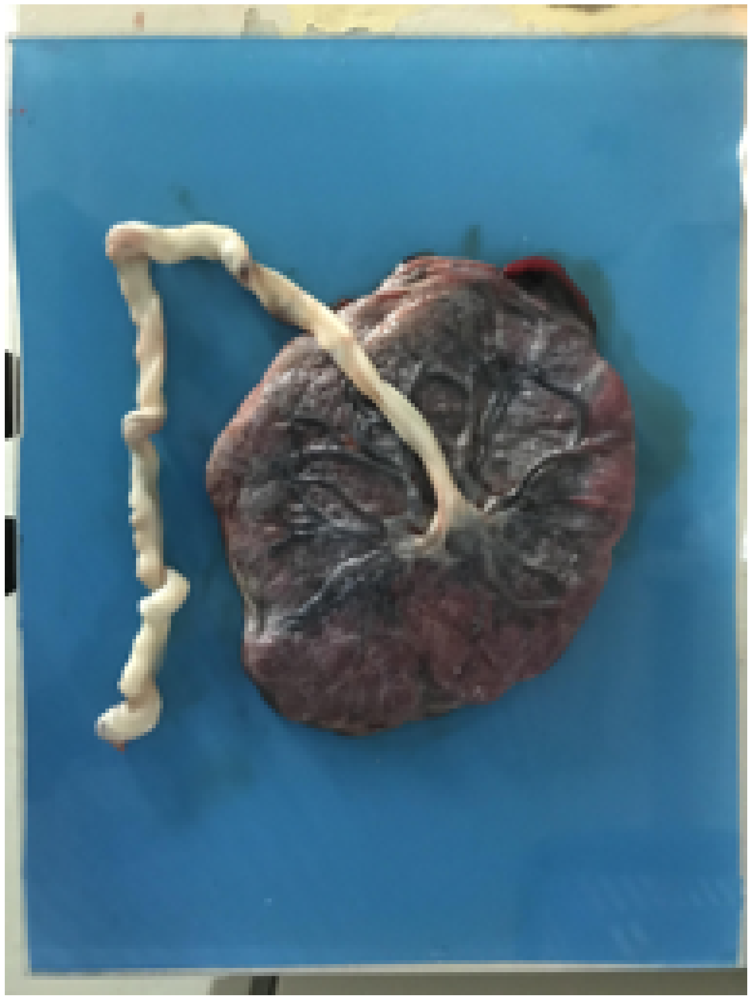

Predicted class: Unaltered


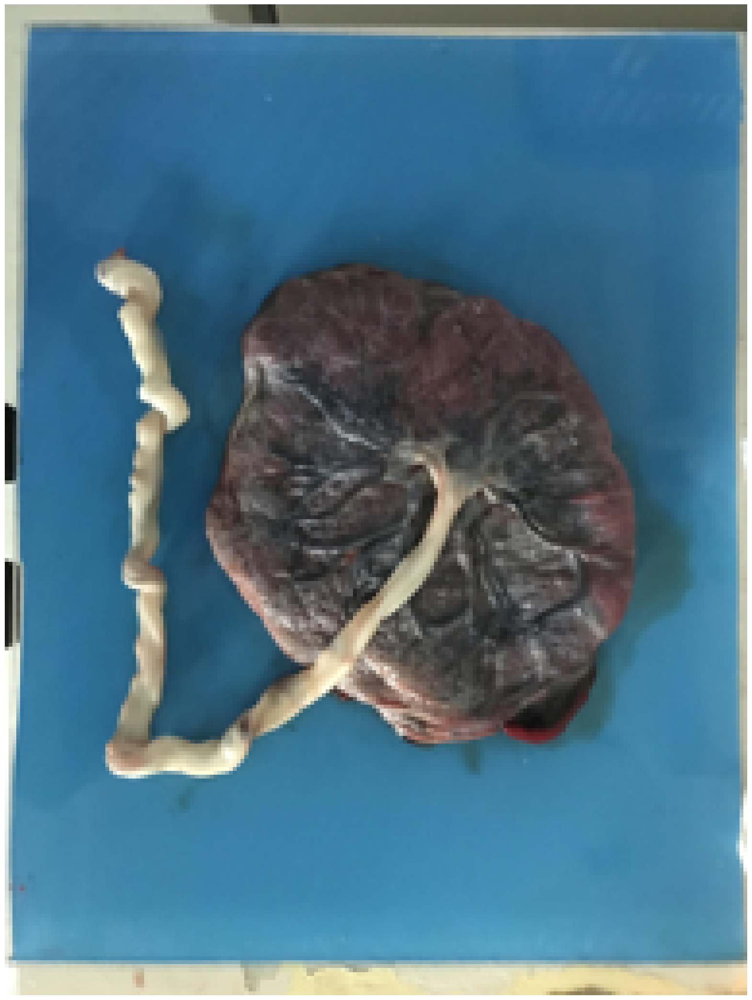

Predicted class: Unaltered


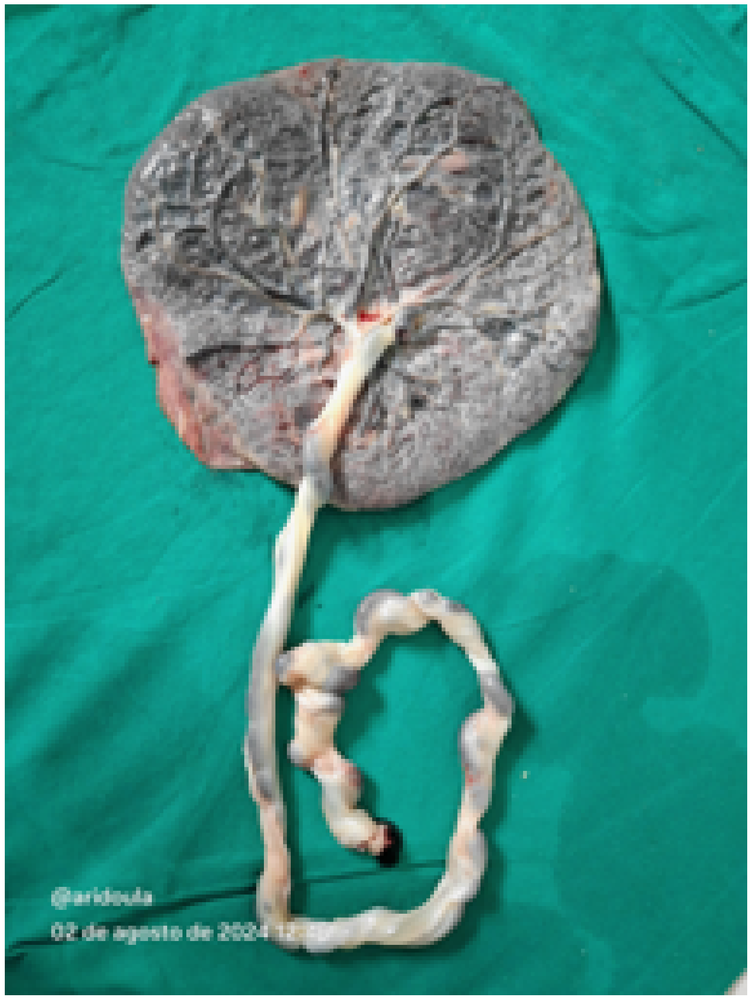

Predicted class: Unaltered


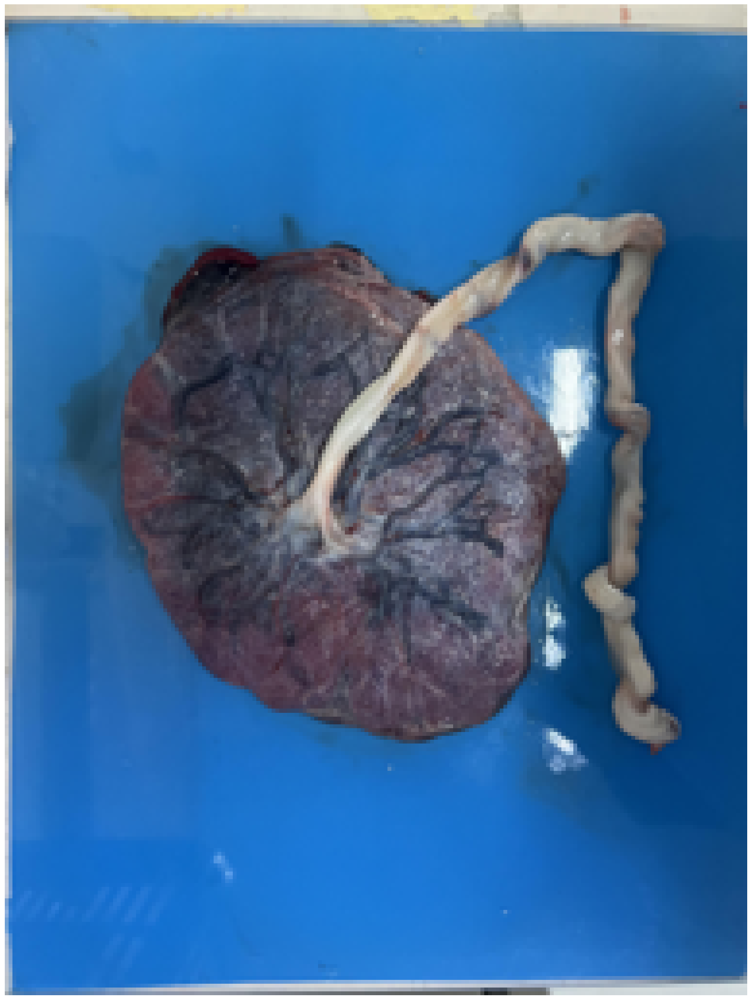

Predicted class: Unaltered


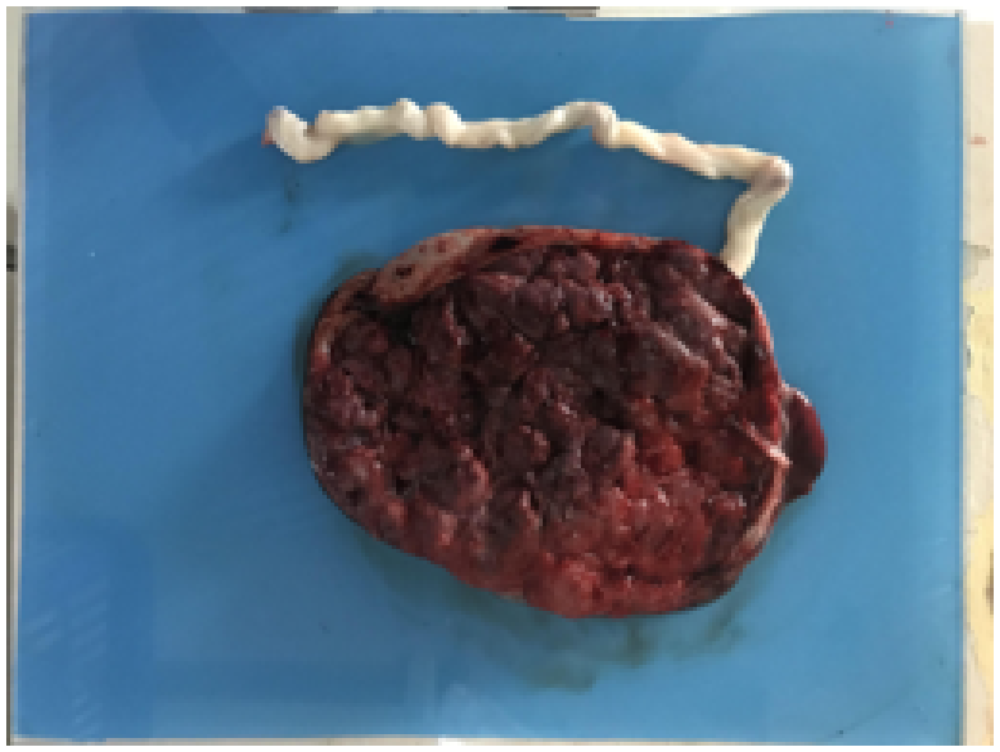

Predicted class: Unaltered


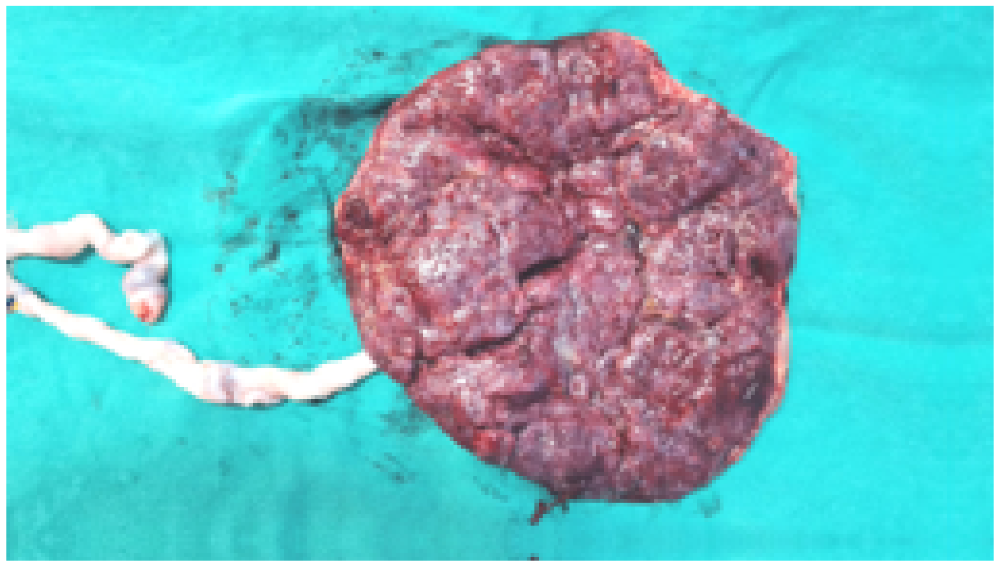

Predicted class: Unaltered


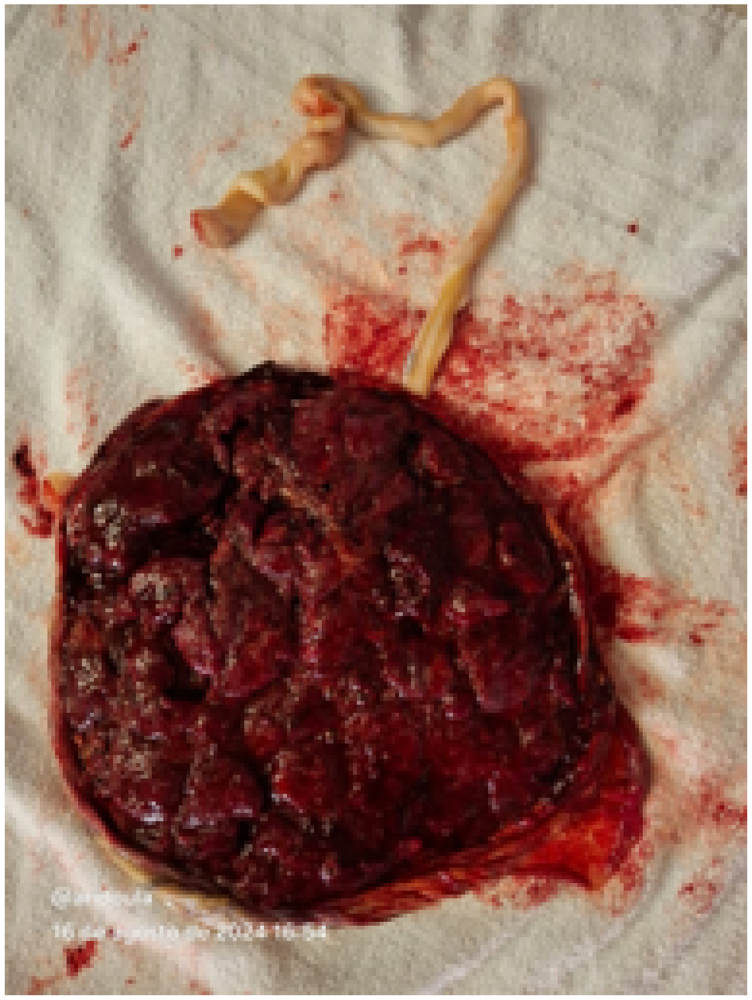

Predicted class: Unaltered


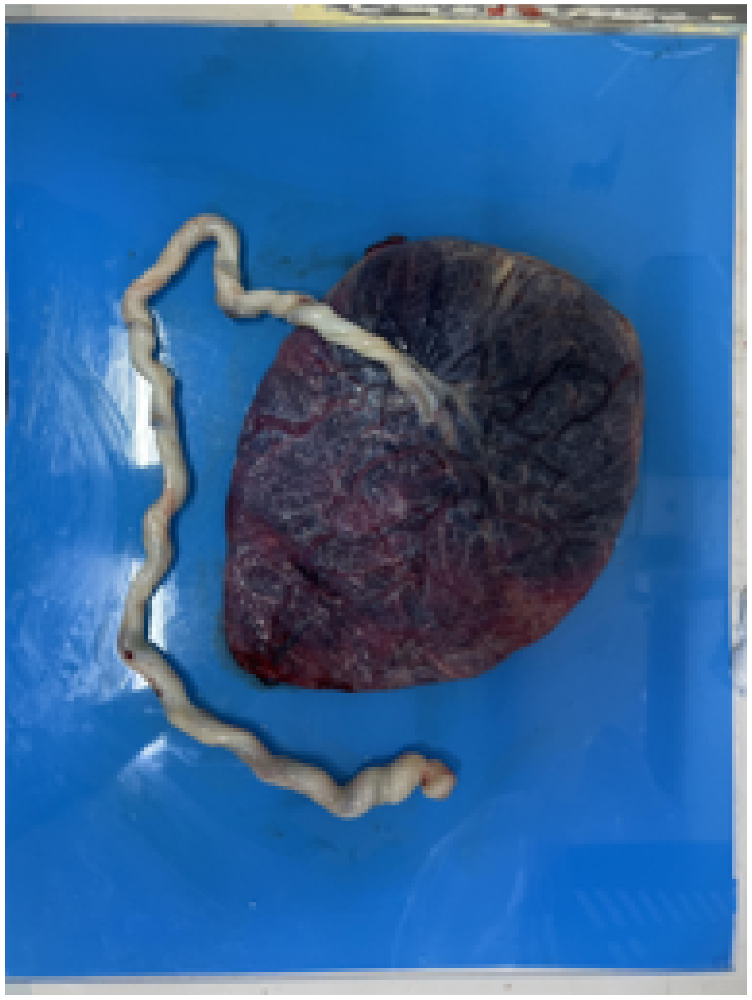

Predicted class: Unaltered


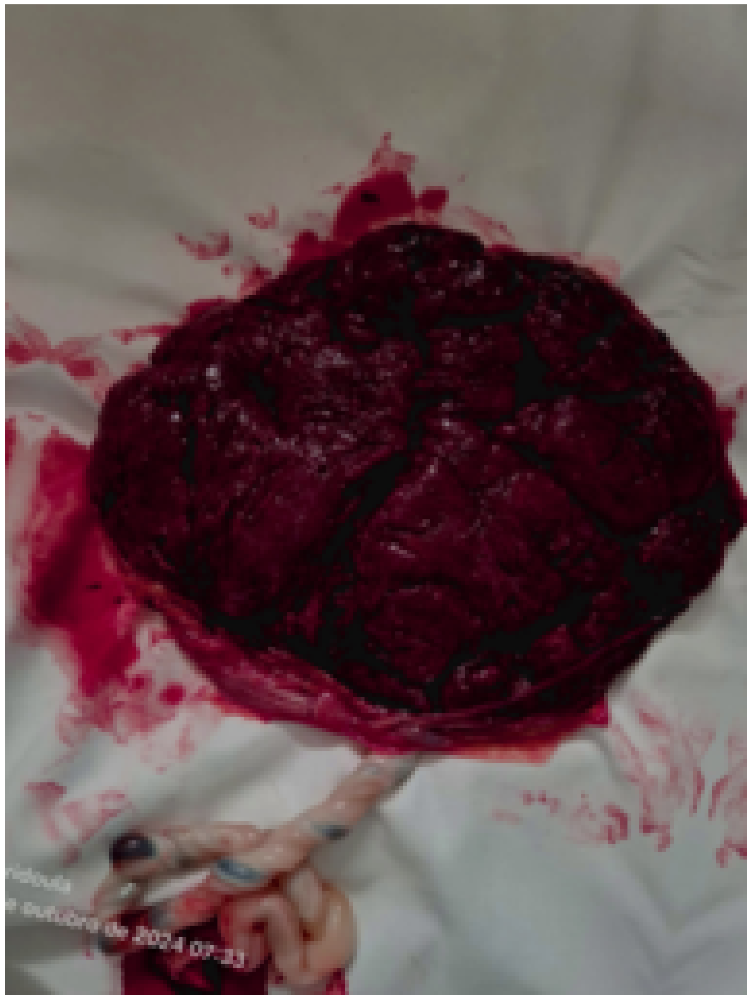

Predicted class: Unaltered


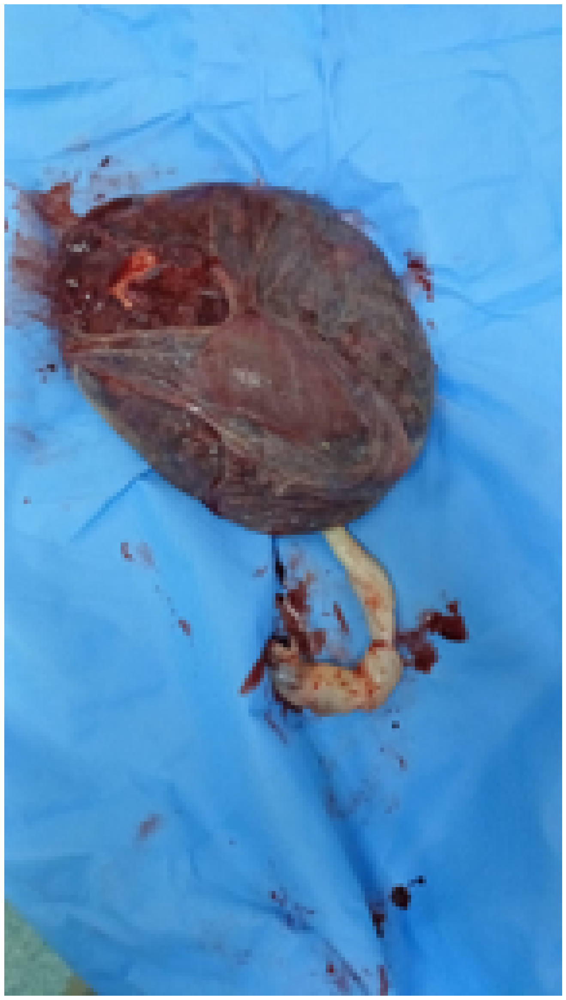

Predicted class: Unaltered


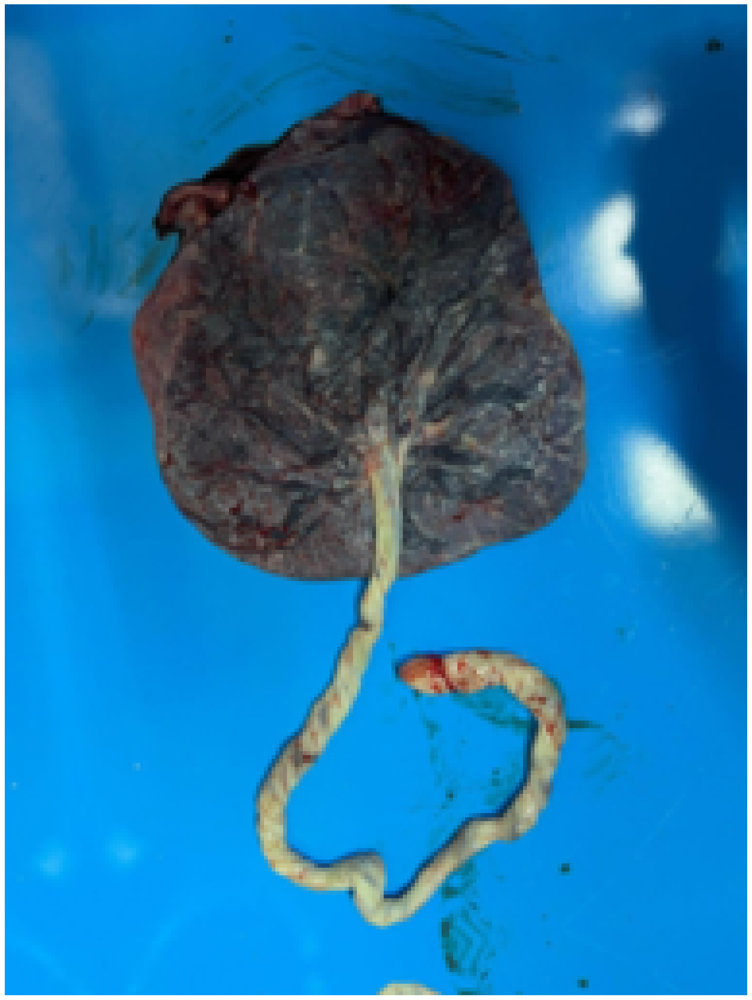

Predicted class: Unaltered


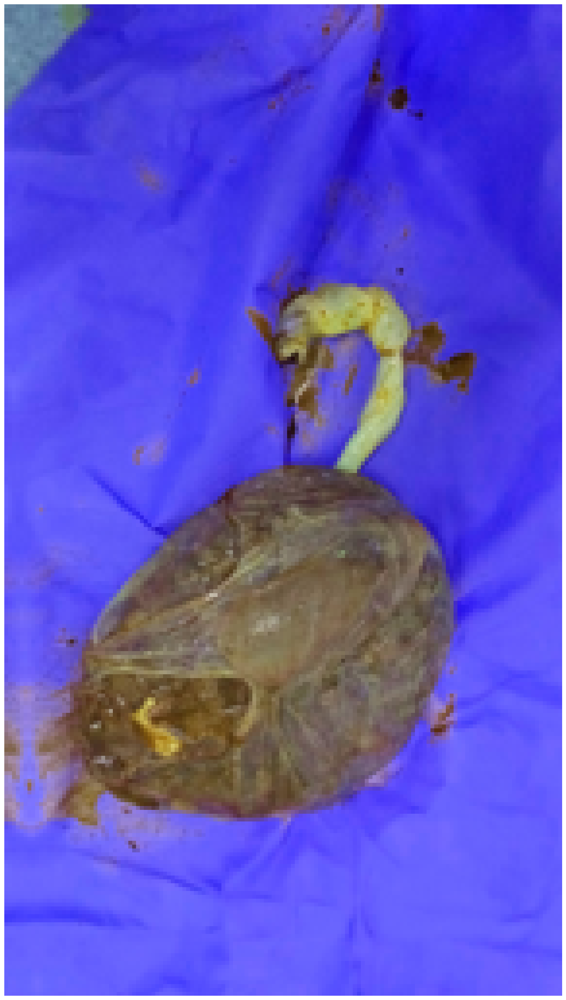

Predicted class: Unaltered


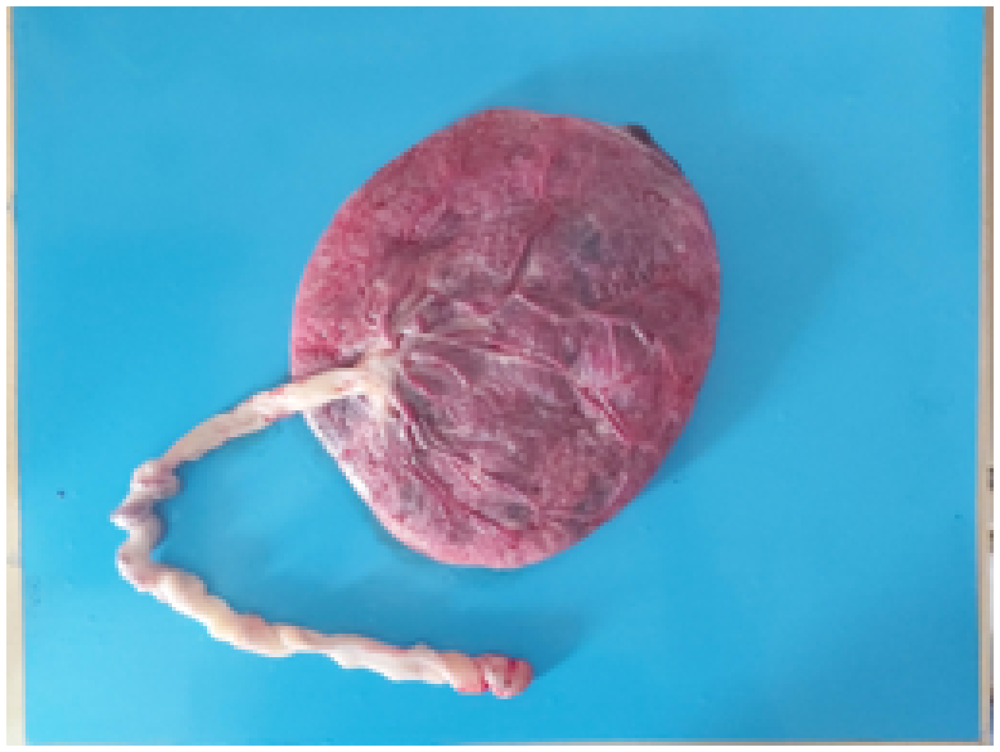

Predicted class: Unaltered


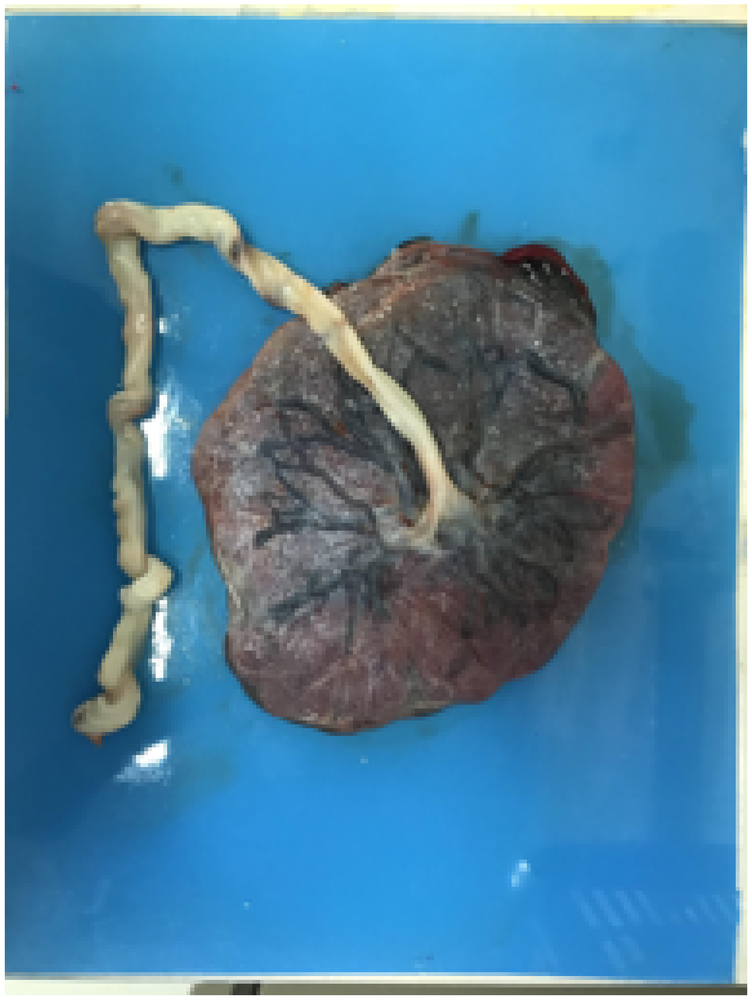

Predicted class: Unaltered


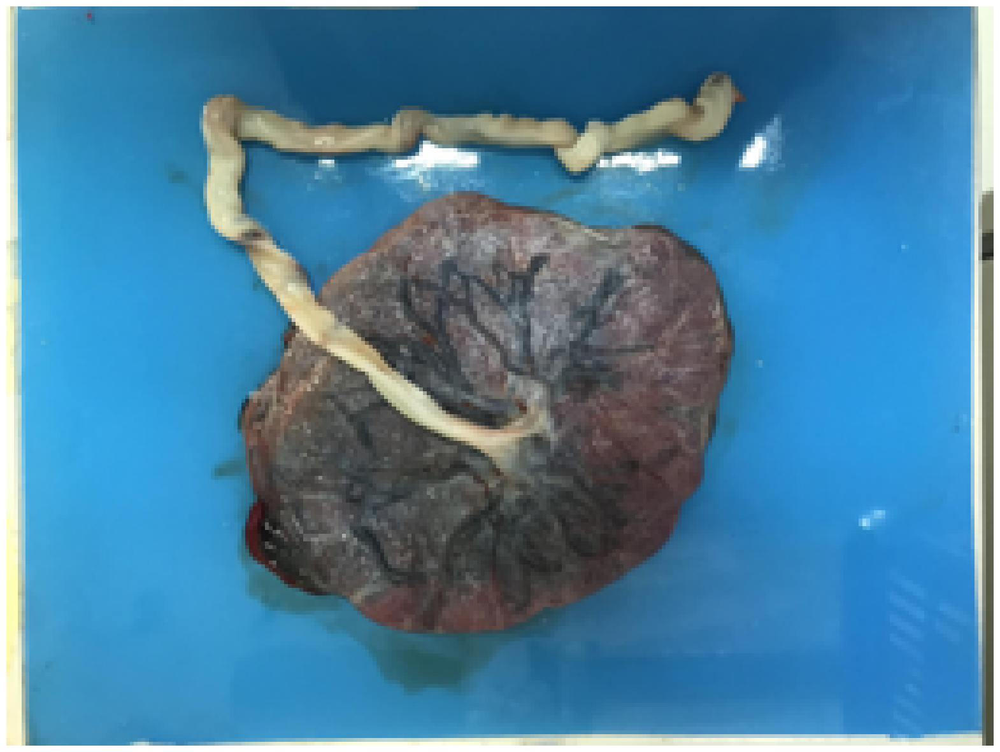

Predicted class: Unaltered


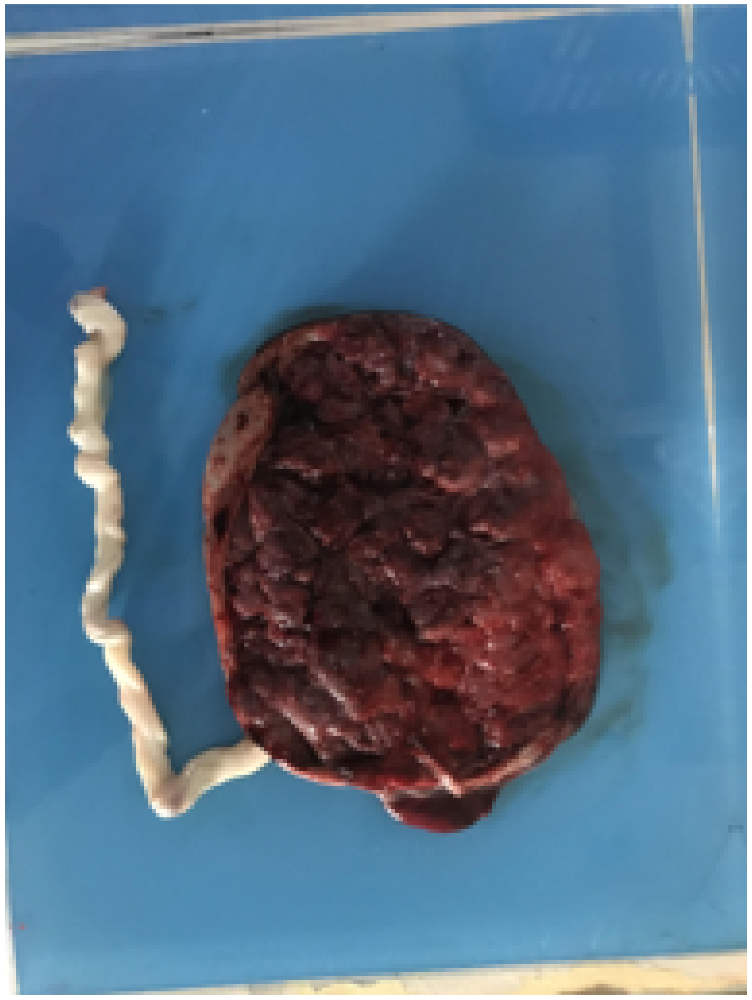

Predicted class: Unaltered


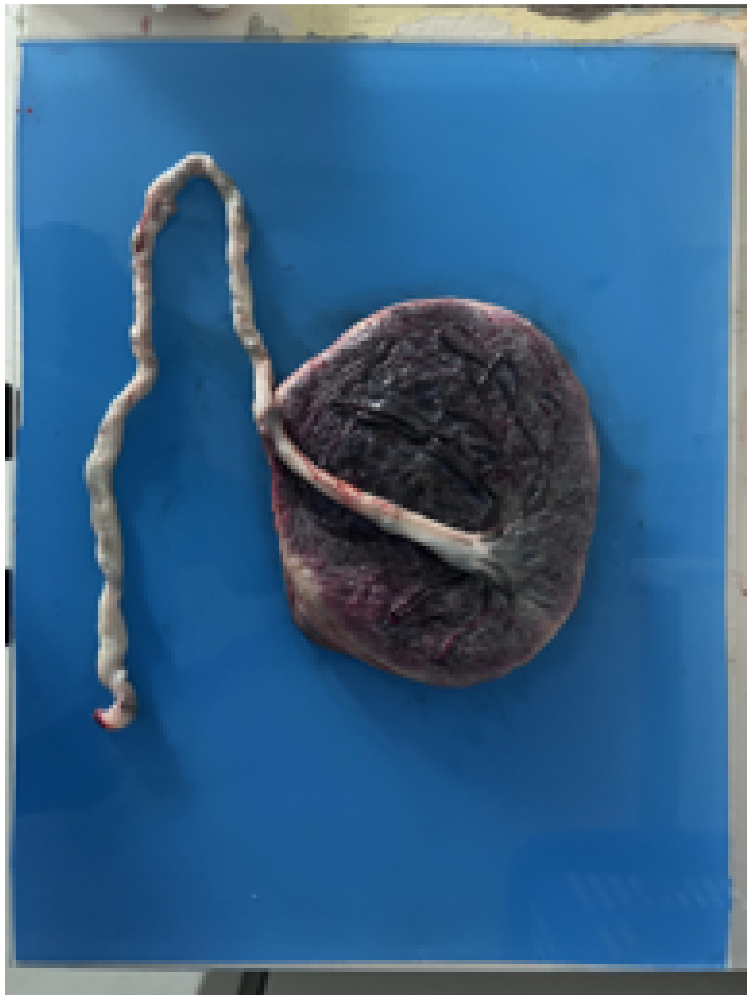

Predicted class: Unaltered


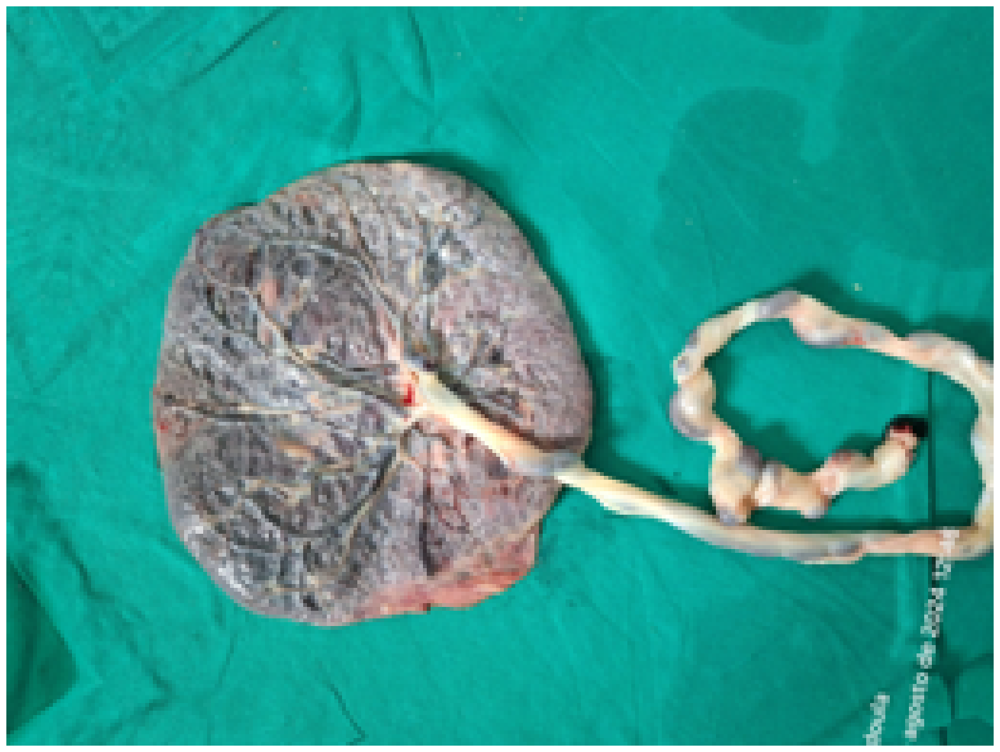

Predicted class: Unaltered


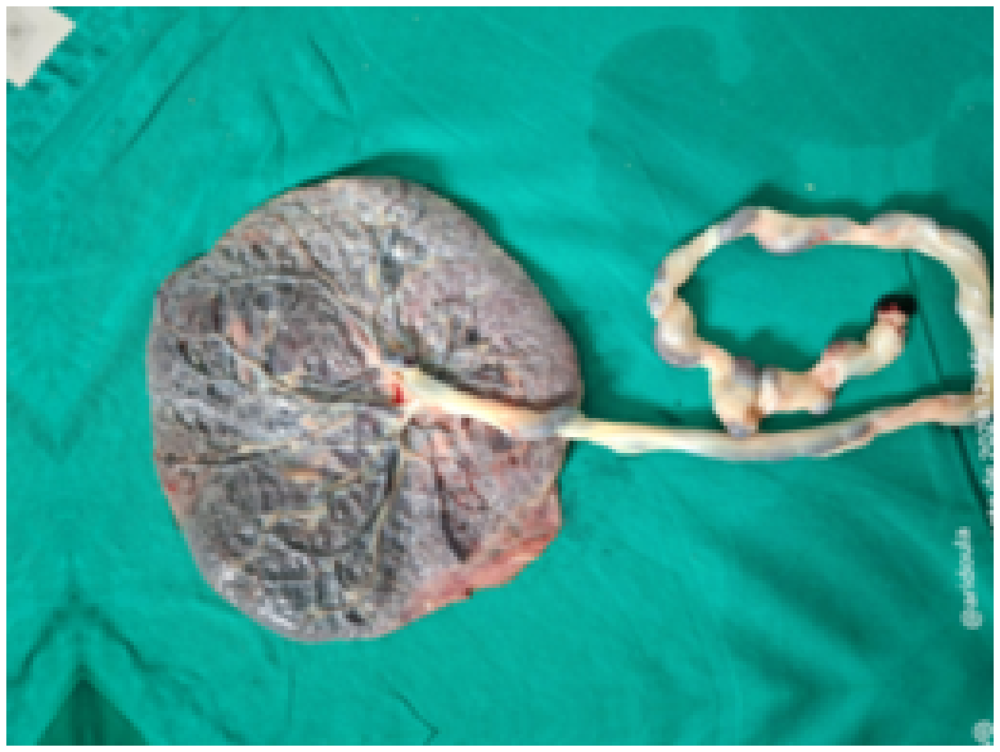

Predicted class: Unaltered


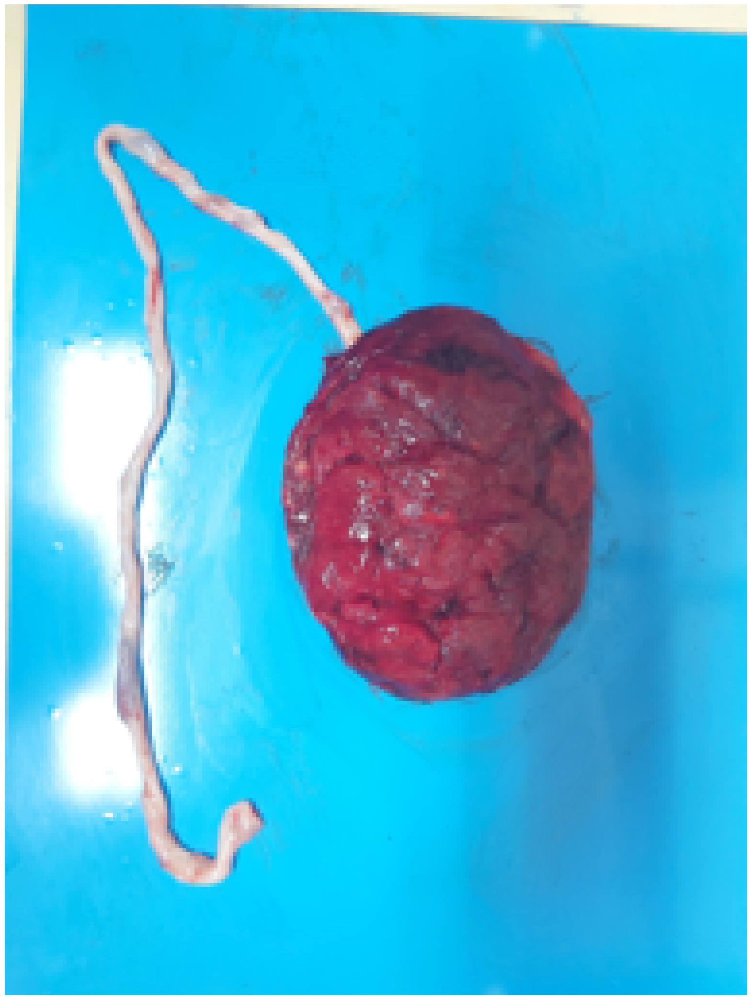

Predicted class: Unaltered


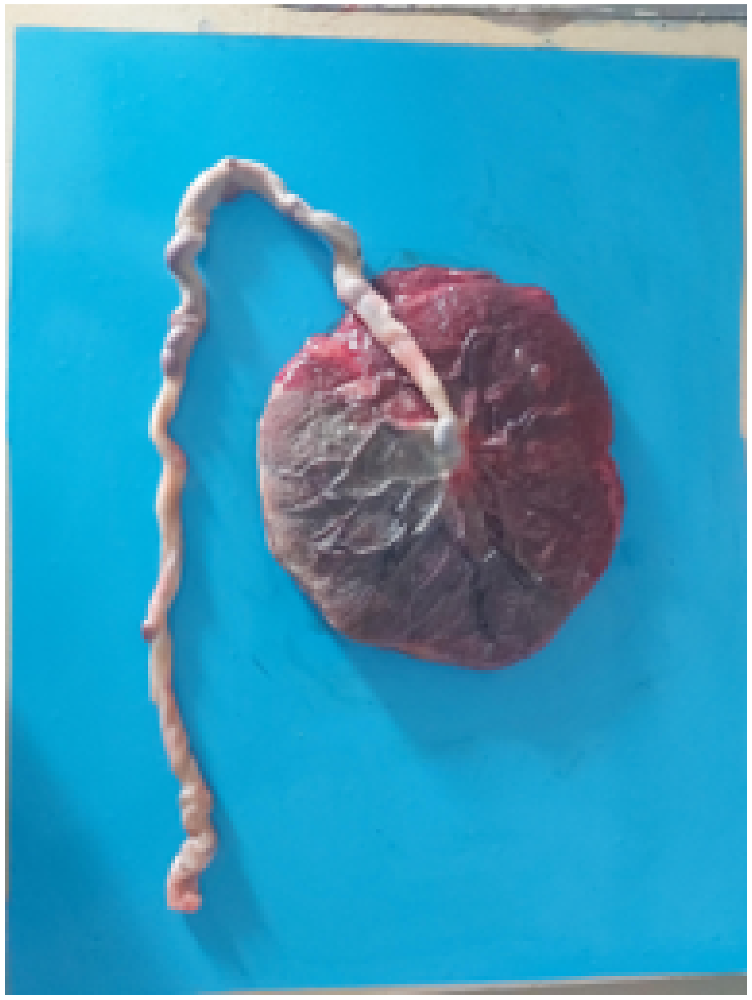

Predicted class: Unaltered


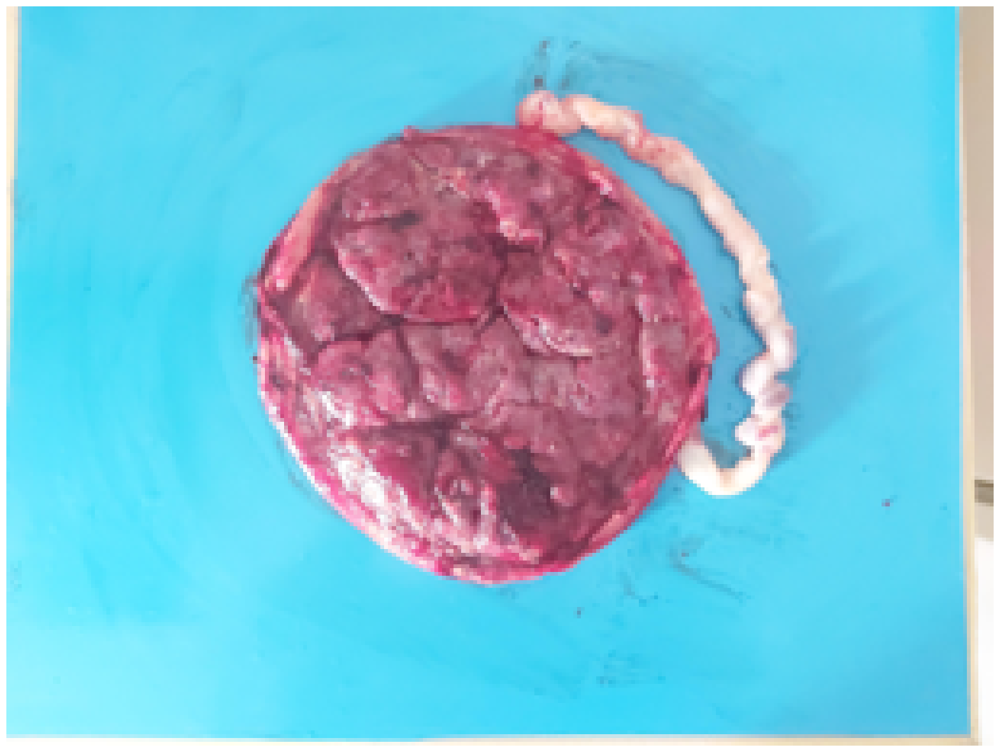

Predicted class: Unaltered


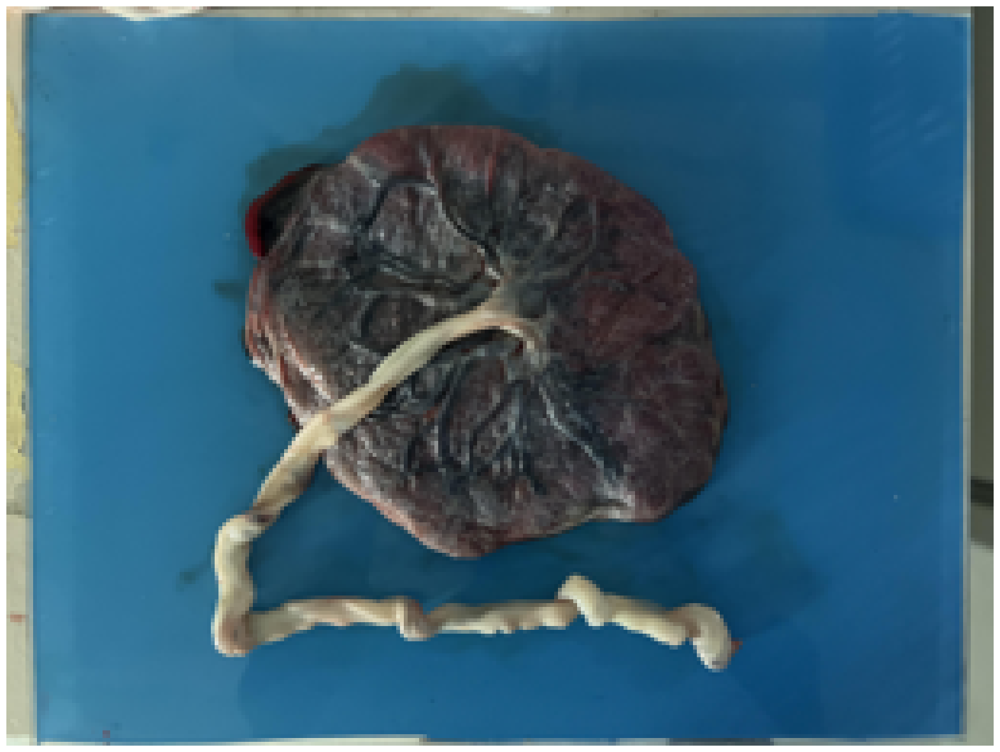

Predicted class: Unaltered


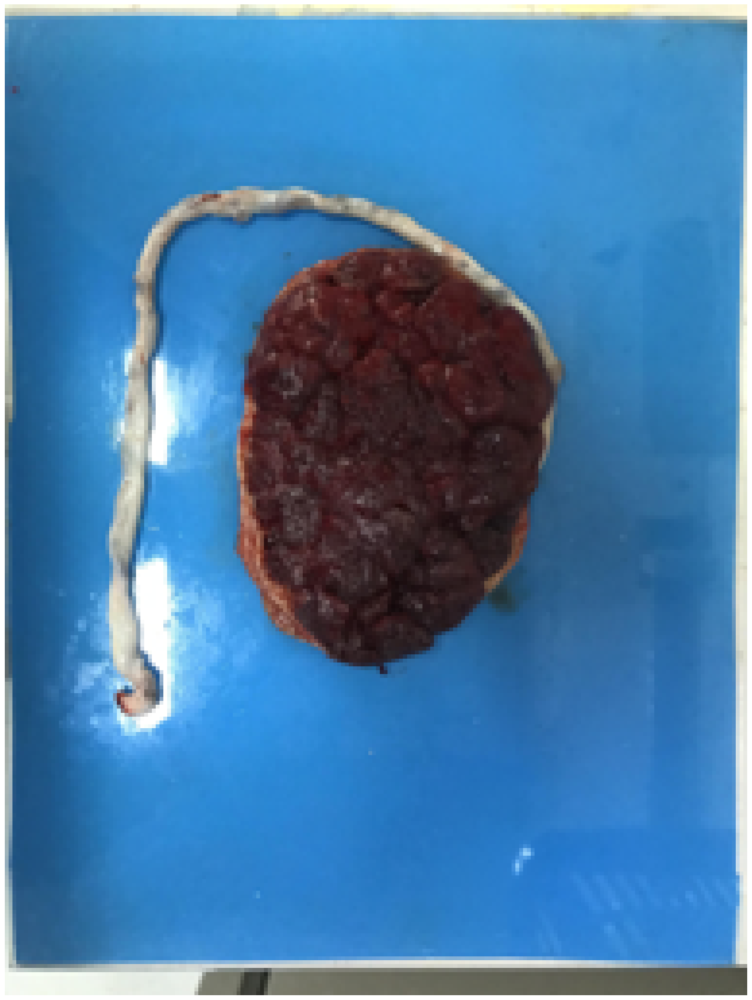

Predicted class: Unaltered


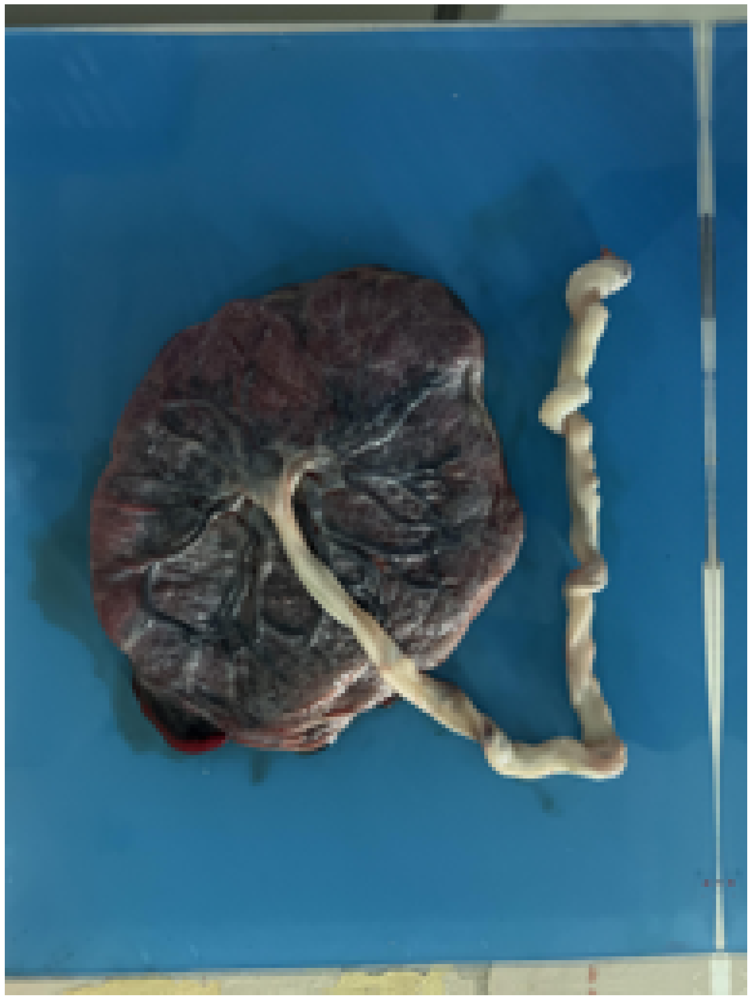

Predicted class: Unaltered


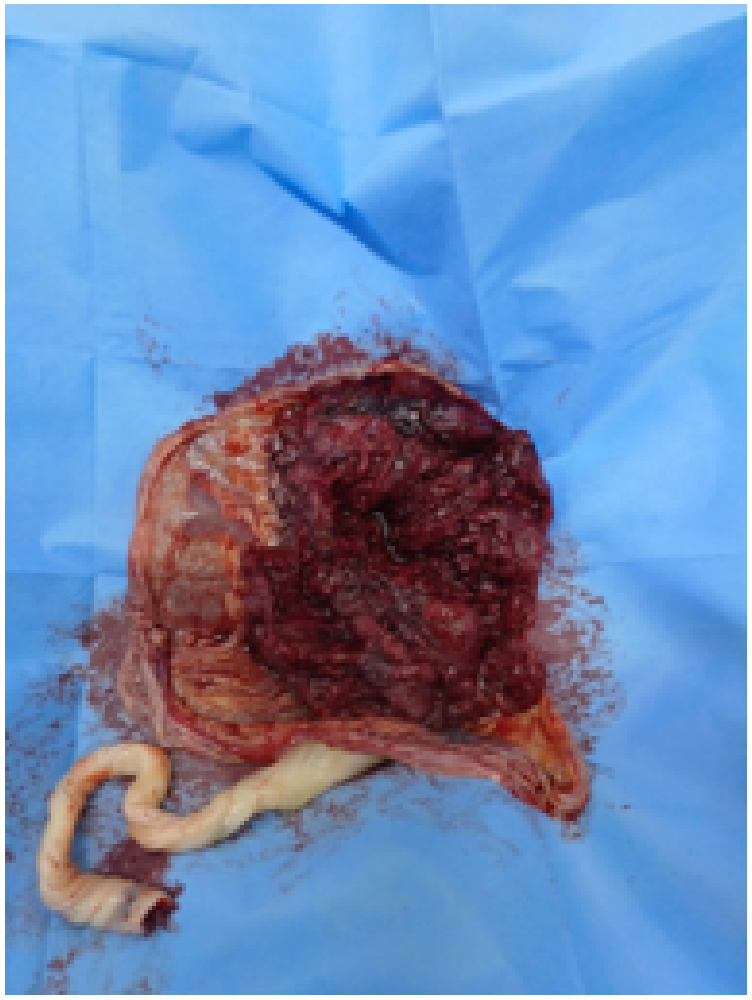

Predicted class: Unaltered


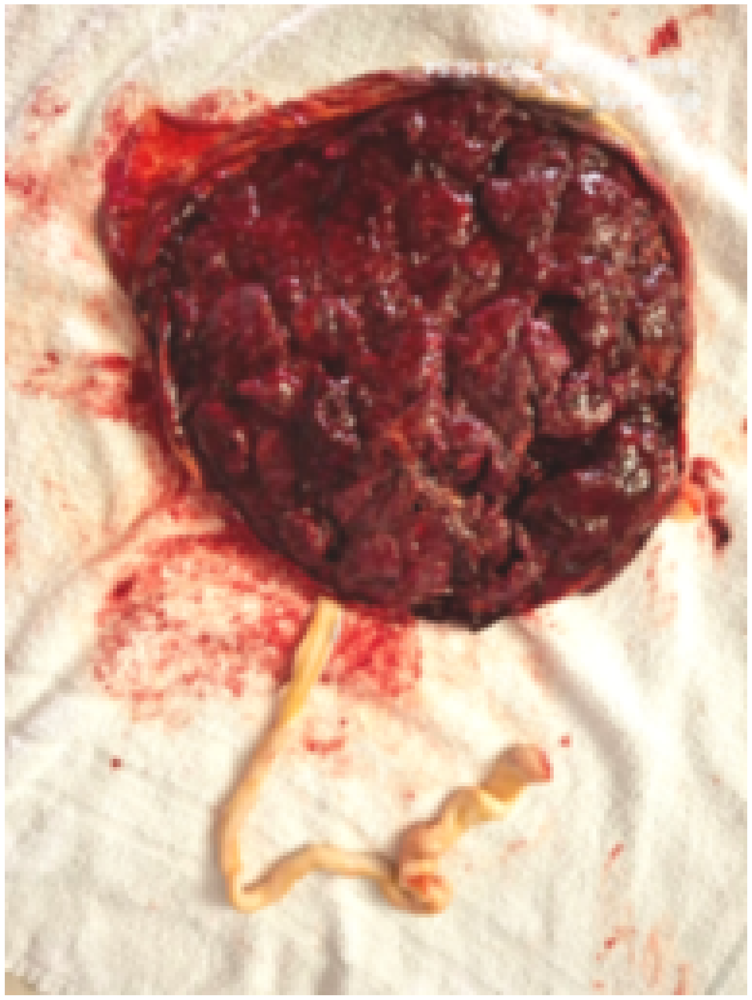

Predicted class: Unaltered


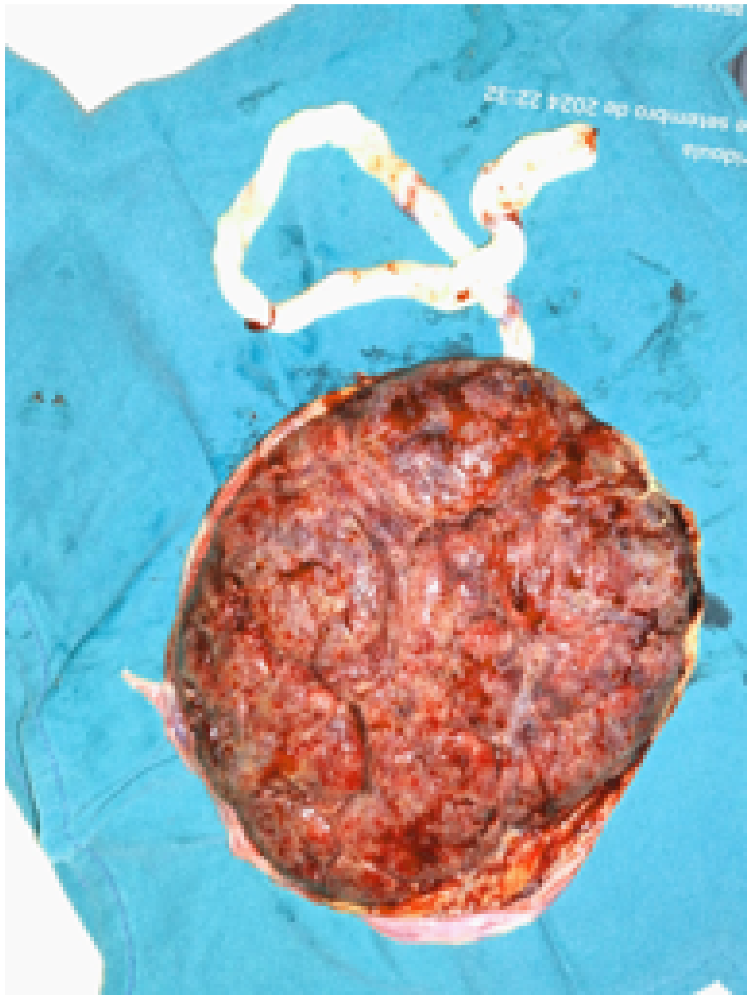

Predicted class: Unaltered


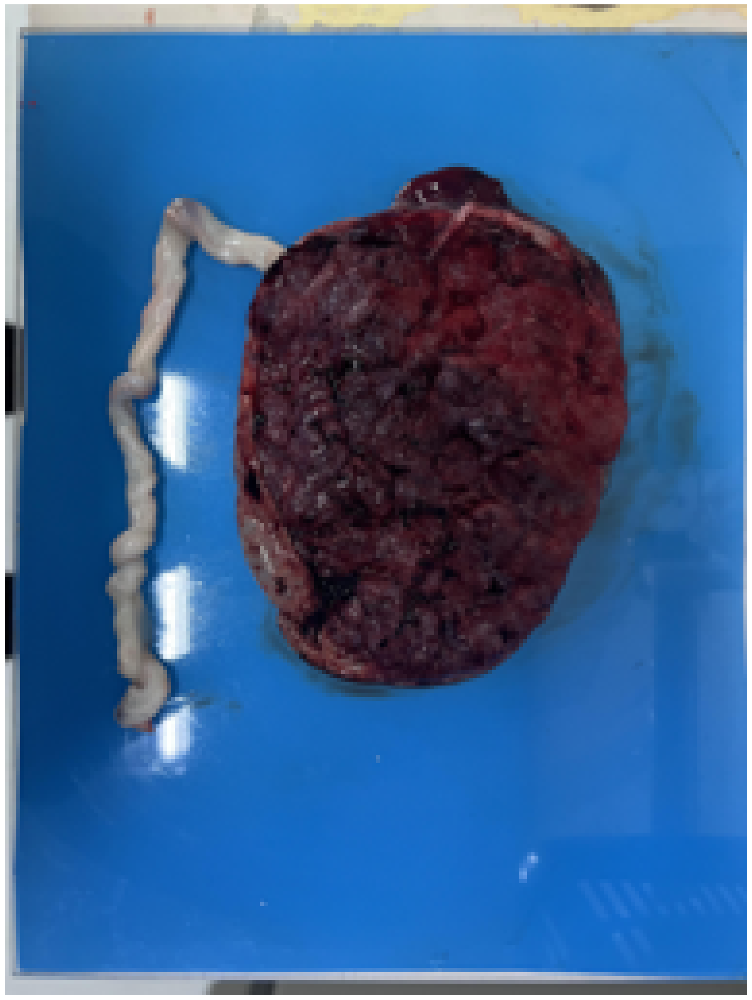

Predicted class: Unaltered


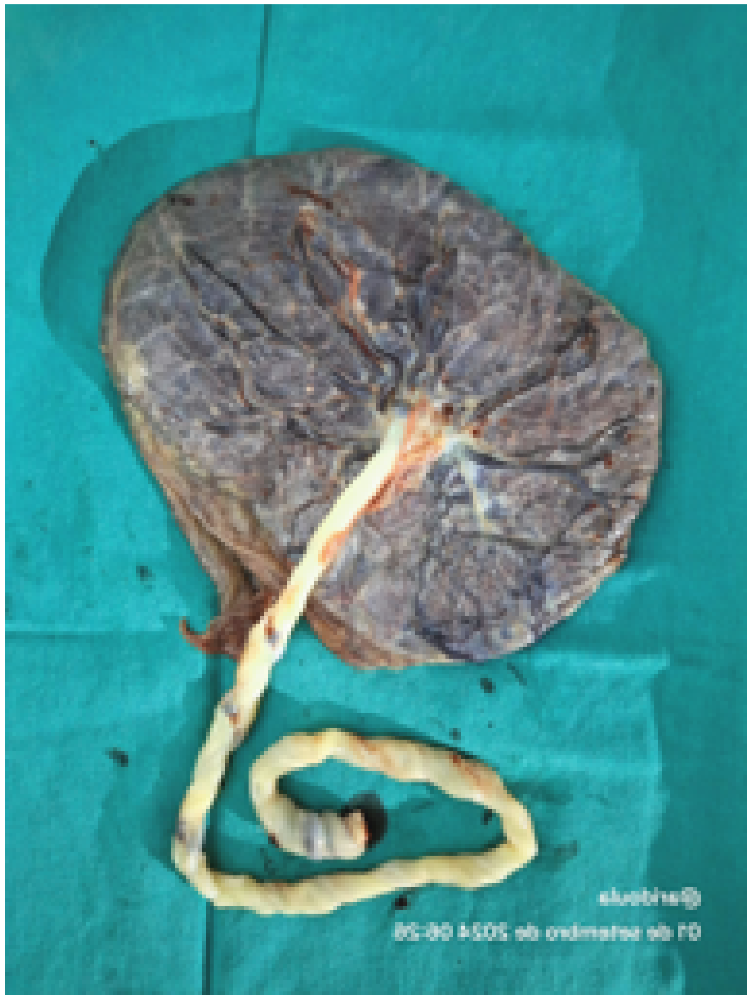

Predicted class: Unaltered


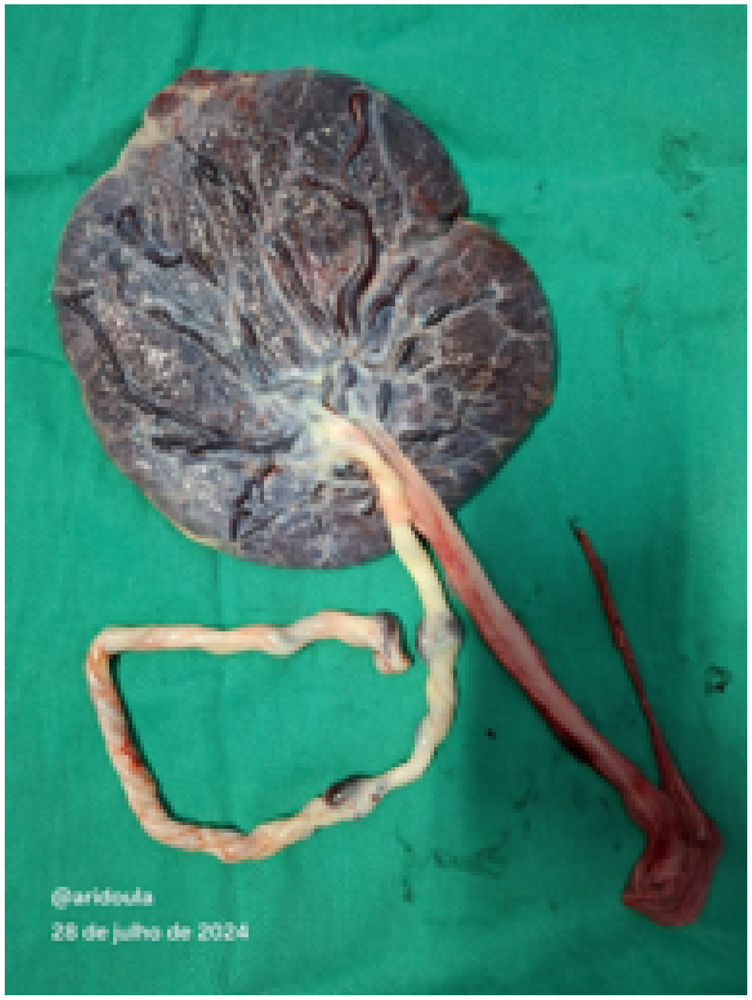

Predicted class: Unaltered


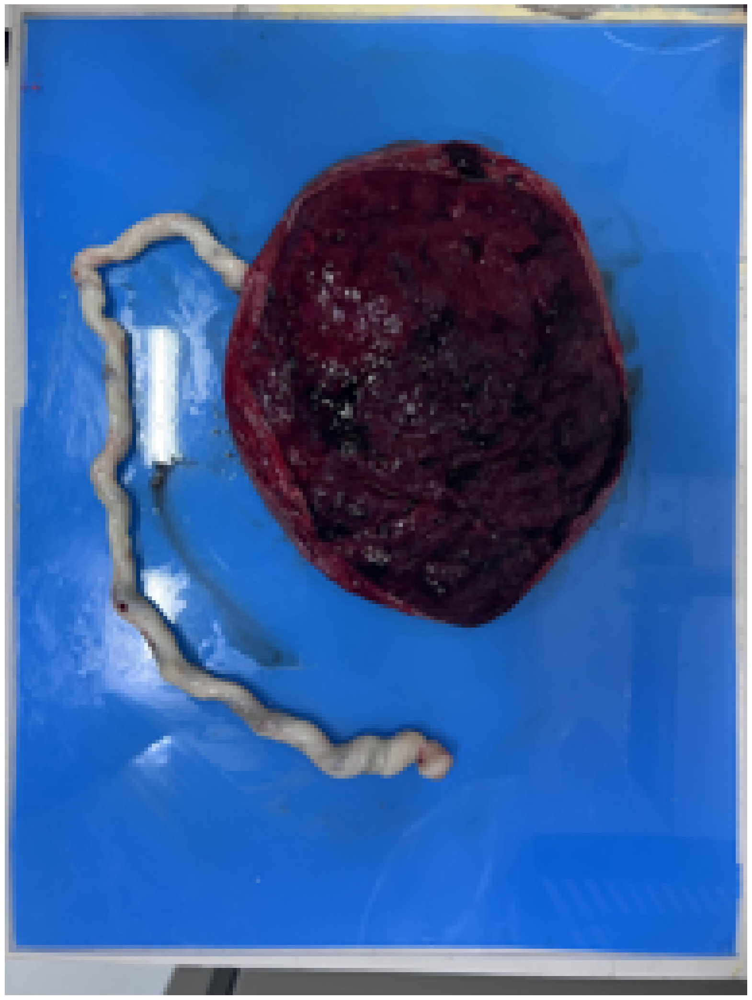

Predicted class: Unaltered


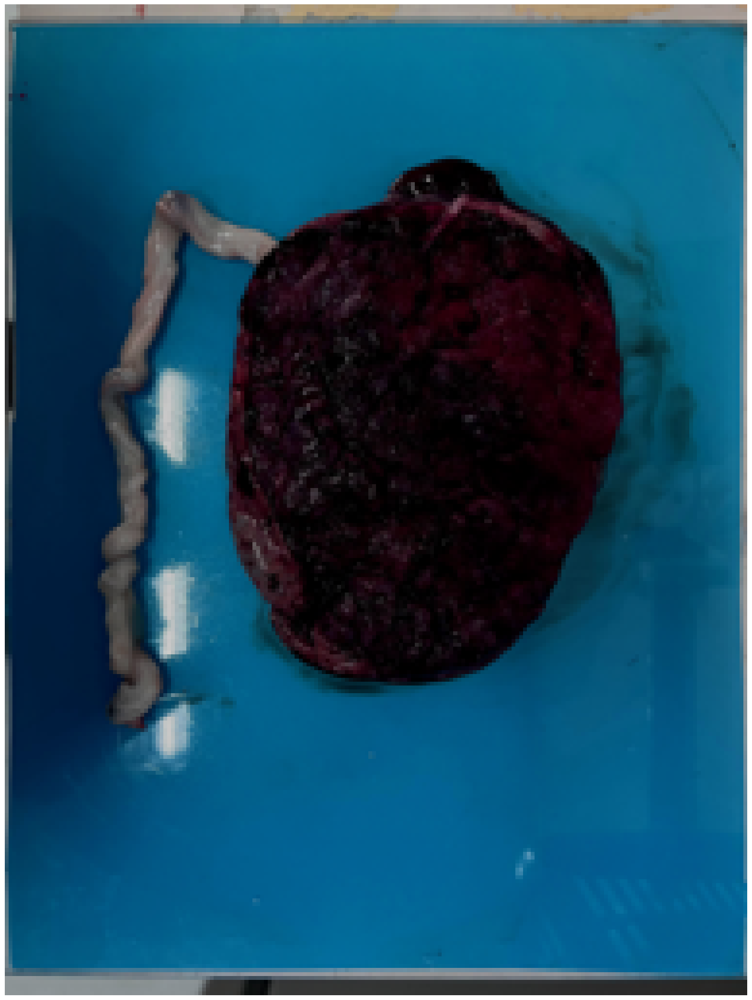

Predicted class: Unaltered


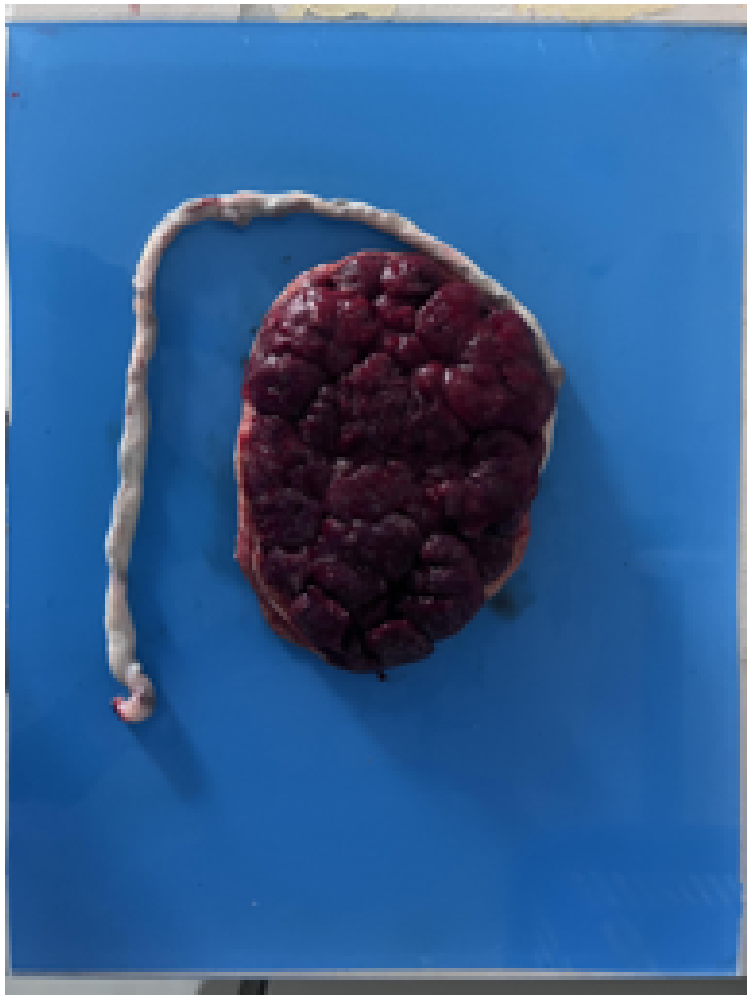

Predicted class: Unaltered


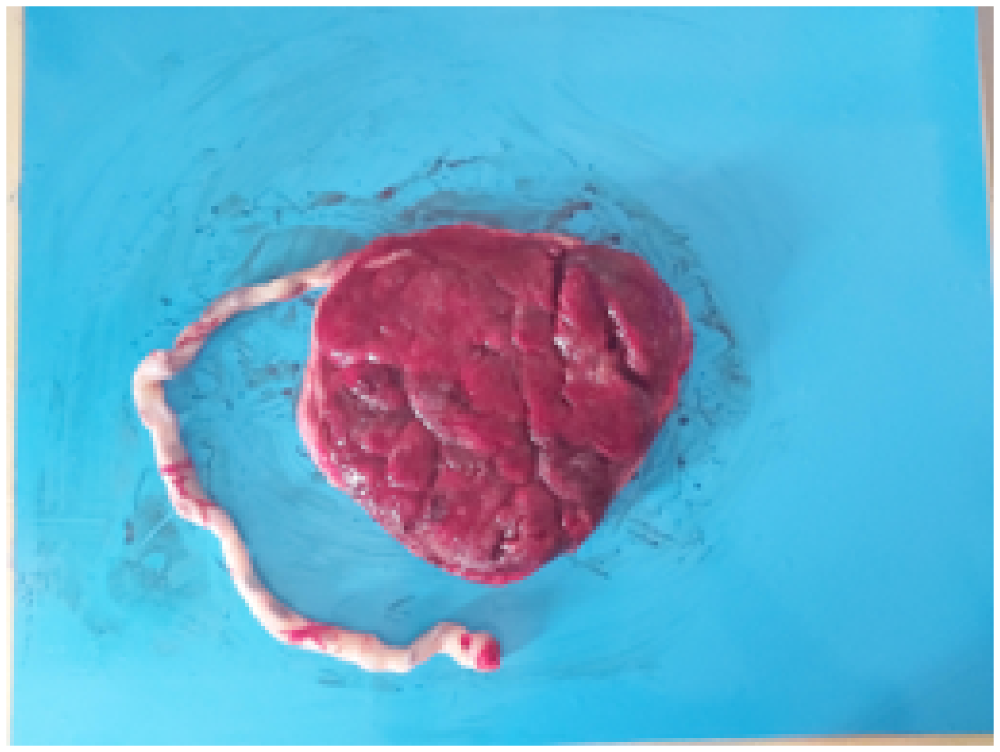

Predicted class: Unaltered


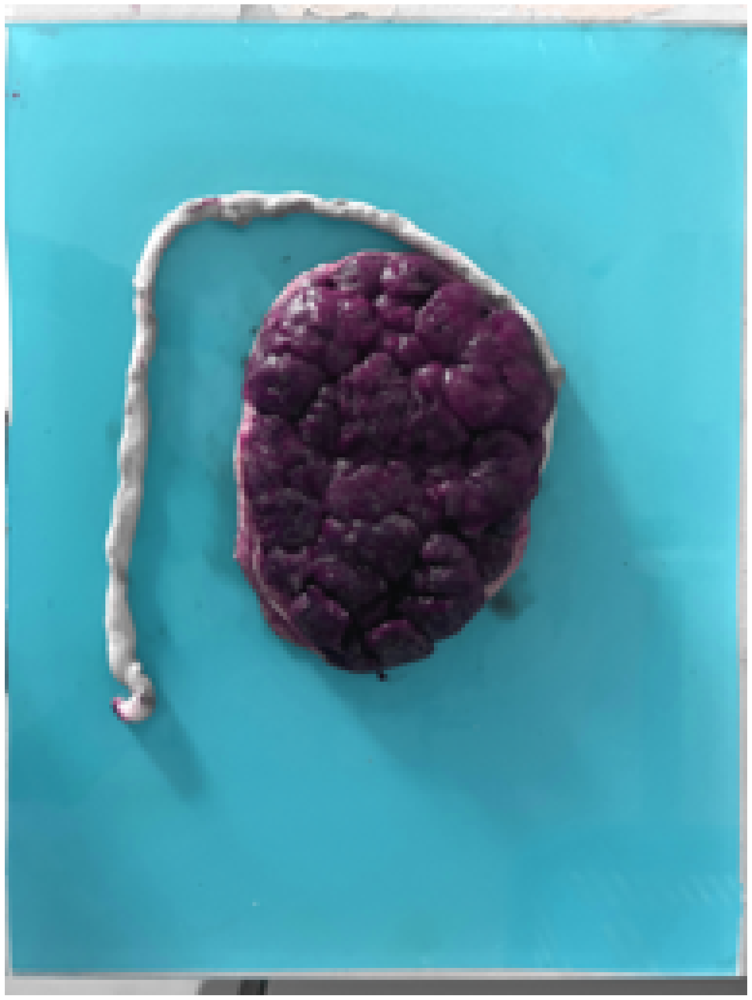

Predicted class: Unaltered


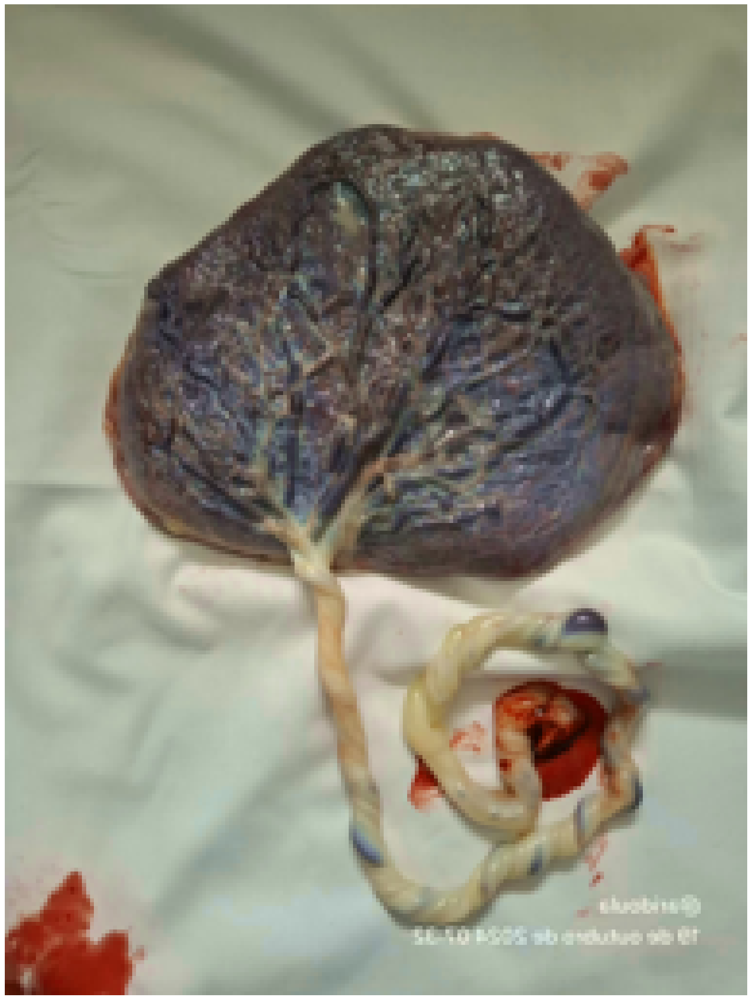

Predicted class: Unaltered


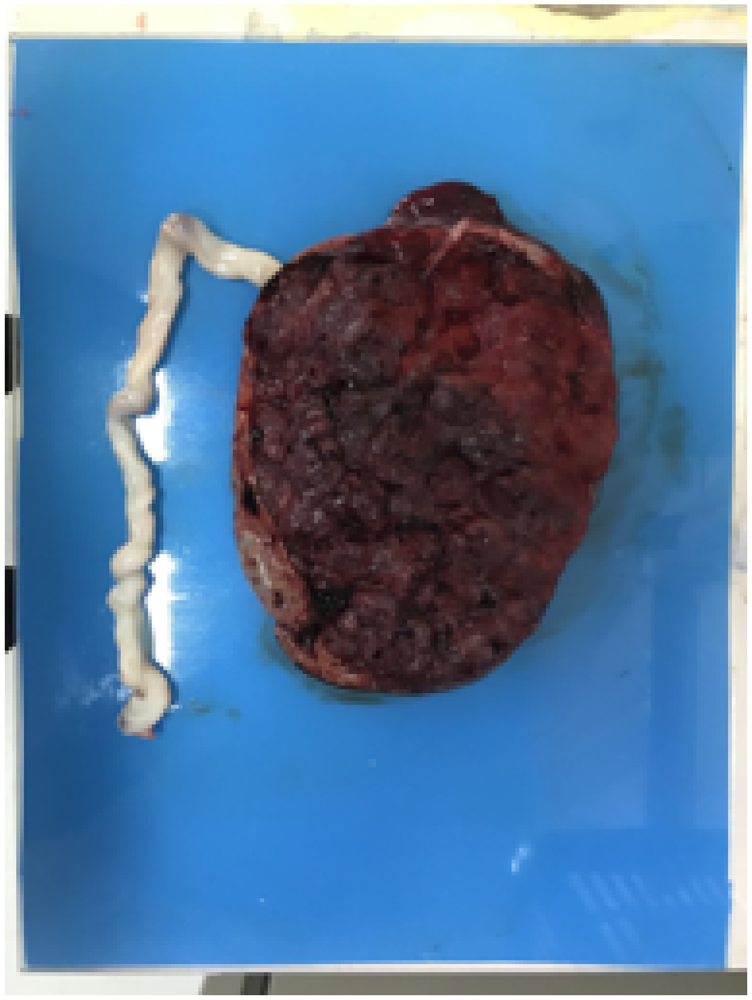

Predicted class: Unaltered


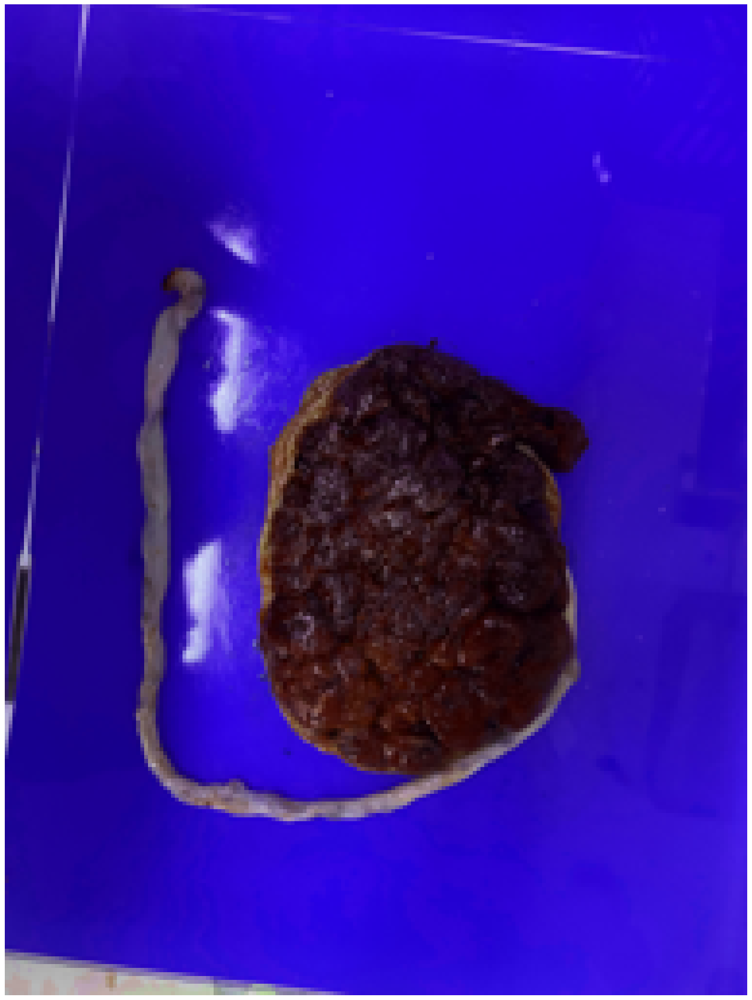

Predicted class: Unaltered


In [ ]:
import matplotlib.pyplot as plt
from fastai.vision.all import *

for (img, cls) in test_dataset:
    plt.figure(figsize=(20, 30))
    img_pil = img.to_thumb(256, 256)  # Convert to a PIL image (resize to fit in the figure)
    plt.imshow(img_pil)
    plt.axis('off')
    plt.show()

    pred_class, pred_idx, outputs = learner.predict(img)

    print(f"Predicted class: {pred_class}")

## EfficientNet B0 - Batch Size 8 with DA

### Setup

In [ ]:
# Defina o tamanho do seu lote de imagens para processamento pela rede
batch_size = 8

image_size = (224, 224)

data = ImageDataLoaders.from_folder(
    DATASET_PATH,
    train='train',
    valid='valid',
    test='test',
    item_tfms=Resize(image_size),
    batch_tfms=[*transforms, Normalize.from_stats(*imagenet_stats)],
    bs=batch_size
)

In [ ]:
from fastai.vision.models import efficientnet_b0

arch = efficientnet_b0(weights=True)
used_model = nn.Sequential(arch, nn.Linear(in_features=1000, out_features=data.c, bias=True))

/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B0_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B0_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth


100%|██████████| 20.5M/20.5M [00:00<00:00, 124MB/s]


In [ ]:
metrics = [
    accuracy,
    top_k_accuracy,
    F1Score(average="macro"),
    Precision(average="macro"),
    Recall(average="macro"),
]

In [ ]:
def get_learner(data, load_model=None, unfreeze:bool=False):
    """Creates and setups the learner for each step of the training approach.

    Args:
        data: Dataloader.
        load_model (str): Path to the model to be loaded.
        unfreeze (bool): Indicates if the model should be unfreezed. Defaults to False.
    """
    learner = Learner(
      dls=data,
      model=arch,
      metrics=metrics,
      opt_func=Adam,
      loss_func=CrossEntropyLossFlat()
    )

    learner.path = Path(os.path.join(MODELS_PATH, 'efficientnetb0-bs8'))

    if load_model:
      learner.load(load_model, with_opt=False)

    if unfreeze:
      learner.unfreeze()

    return learner

### Transfer Learning

#### Training

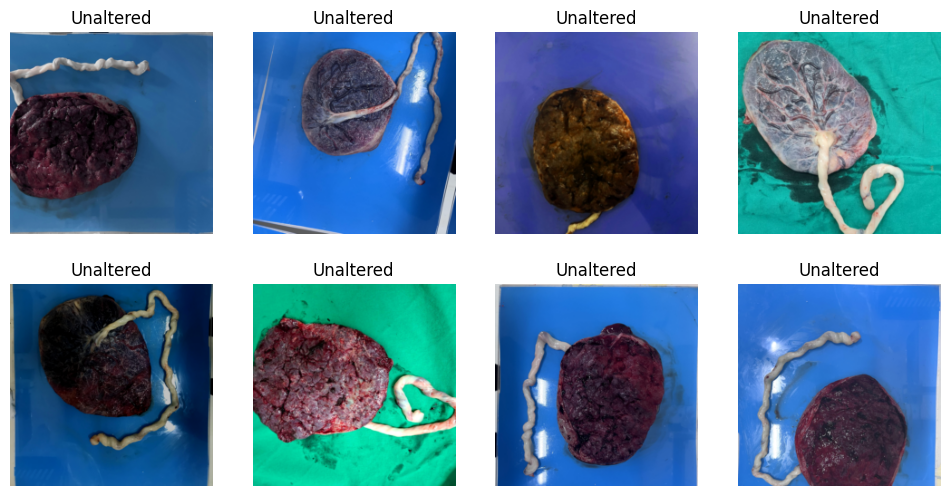

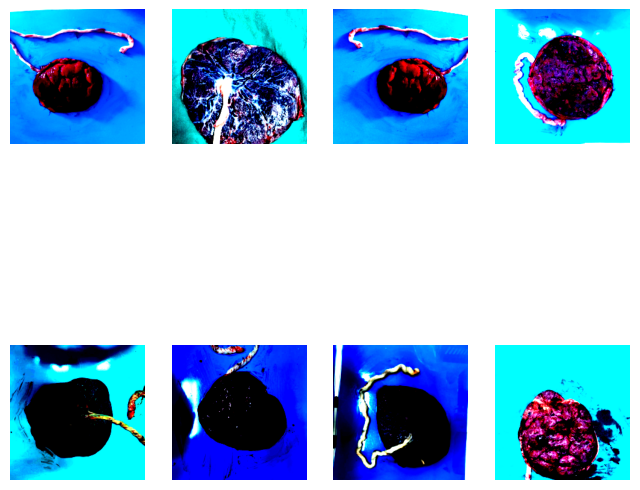

In [ ]:
data.show_batch()
b = data.one_batch()
show_images(b[0][:8], nrows=2, figsize=(8,8))

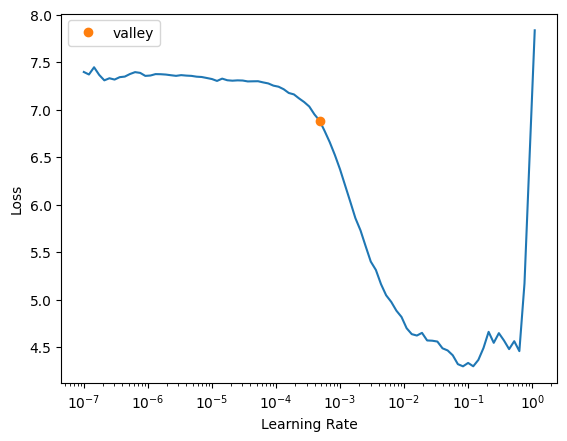

In [ ]:
learner = get_learner(data)
lr = learner.lr_find().valley

epoch,train_loss,valid_loss,accuracy,top_k_accuracy,f1_score,precision_score,recall_score,time
0,6.296850,5.612437,0.089744,0.166667,0.002858,0.014085,0.001590,01:03
1,4.106862,2.645715,0.717949,0.820513,0.091787,0.101808,0.084197,01:00
2,1.836613,1.016131,0.858974,0.897436,0.174825,0.171123,0.178886,01:00
3,0.804201,0.508336,0.935897,0.974359,0.495155,0.490672,0.500000,01:00
4,0.362095,0.217154,0.974359,0.987179,0.748016,0.746094,0.750000,01:00
5,0.224198,0.128223,0.987179,1.000000,0.874000,0.873016,0.875000,01:01
6,0.113466,0.091291,0.987179,1.000000,0.833333,0.812500,0.875000,01:00
7,0.078398,0.040573,1.000000,1.000000,1.000000,1.000000,1.000000,01:00


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 0 with f1_score value: 0.002857726066544193.


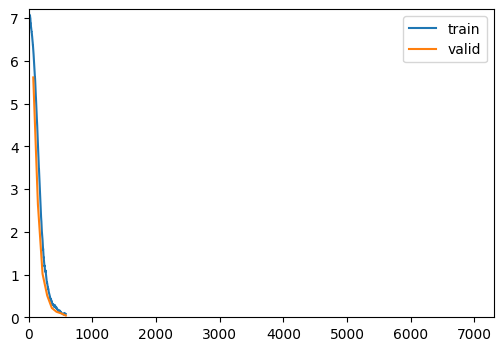

/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 1 with f1_score value: 0.09178743961352658.


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 2 with f1_score value: 0.17482517482517482.


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 3 with f1_score value: 0.4951550387596899.


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 4 with f1_score value: 0.748015873015873.


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 5 with f1_score value: 0.874.


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 7 with f1_score value: 1.0.


In [ ]:
wd = 1e-2
TRAIN_EPOCH = 100
callbacks = [
    SaveModelCallback(monitor='f1_score', fname='best_model_stg1', with_opt=False),
    ShowGraphCallback(),
    EarlyStoppingCallback(monitor='valid_loss', patience=15)
]

learner.fit_one_cycle(TRAIN_EPOCH, lr_max=lr, wd=wd, cbs=callbacks)

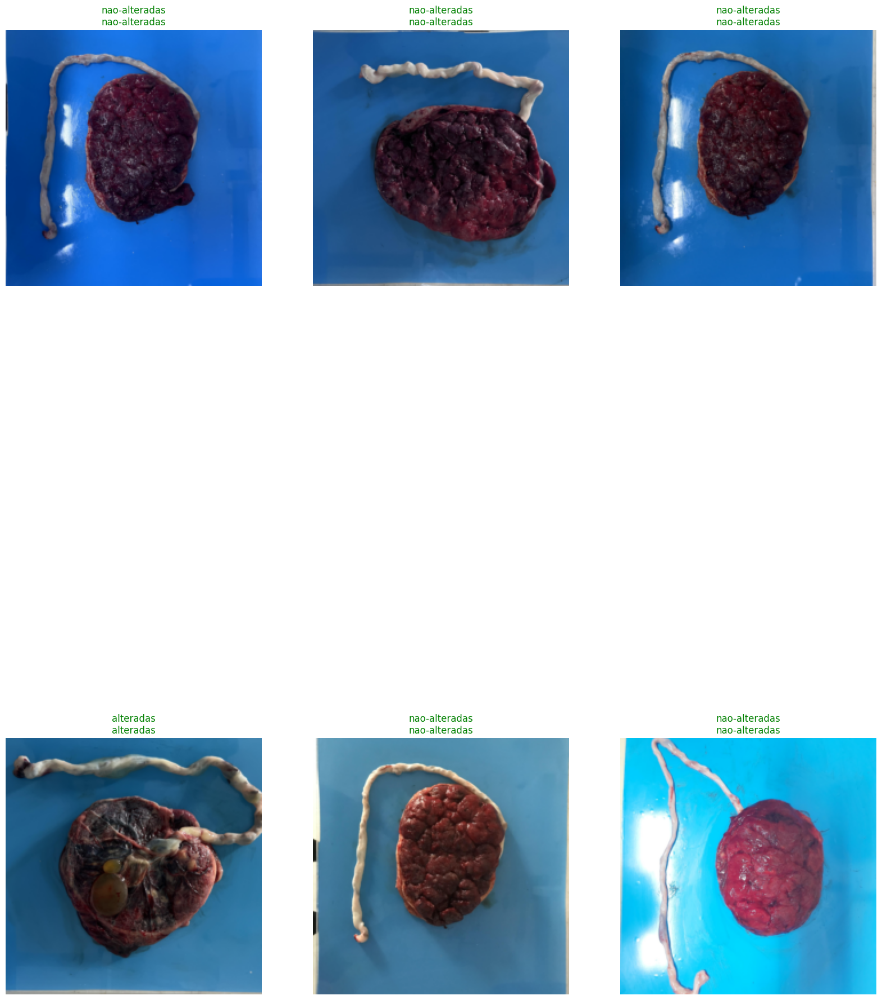

In [ ]:
get_learner(data, 'best_model_stg1').show_results(
    max_n=6, figsize=(20, 30)
)

### Finetuning

In [ ]:
'''
learner = get_learner(data, 'best_model_stg1', True)
learner.lr_find()
'''

print('Skipped since finetuning not needed')

Skipped since finetuning not needed


In [ ]:
'''
lr = slice(1.44e-5, 8e-5)
wd = 1e-2
TRAIN_EPOCH = 20
callbacks = [
    SaveModelCallback(monitor='f1_score', fname='best_model_stg2', with_opt=False),
    ShowGraphCallback(),
    EarlyStoppingCallback(monitor='valid_loss', patience=3)
]

learn.fit_one_cycle(TRAIN_EPOCH, lr_max=lr, wd=wd, cbs=callbacks)
'''

print('Skipped since finetuning not needed')

Skipped since finetuning not needed


### Test

#### Setup

In [ ]:
# Defina o tamanho do seu lote de imagens para processamento pela rede
batch_size = 1

image_size = (224, 224)

data_test = ImageDataLoaders.from_folder(
    DATASET_PATH,
    train='test',
    valid='test',
    test='test',
    item_tfms=Resize(image_size),
    batch_tfms=[Normalize.from_stats(*imagenet_stats)],
    bs=batch_size
)

In [ ]:
learner = get_learner(data_test, 'best_model_stg1')
test_dataset = data_test.valid_ds

#### Functions

In [ ]:
from IPython.display import Image

def gt_classifications(ds):
    for (img, cls) in ds:
        yield Classification(int(cls))

def pred_classifications(ds):
    for (img, cls) in ds:
        (cls_name, pred_cls, scores) = learner.predict(img)
        yield Classification(int(pred_cls), scores[int(pred_cls)])

def top5(img):
  pred_class, pred_idxs, outputs = learner.predict(img)
  top_5_conf, i = outputs.topk(5)
  itr = 0
  classes = data.classes
  for x in i:
    print("Class: %s, Probability: %.4f %%"%(classes[x.item()], top_5_conf[itr].item()*100))
    itr=itr+1
  print()

def get_prediction(img, correct_class):
  pred_class, pred_idxs, outputs = learner.predict(img)
  classes = data.classes
  out = list(outputs)
  index = classes.index(correct_class)
  prediction = out[index]
  print("%.10f %%"%(prediction.item()*100))
  print()

#### Results

In [ ]:
evaluation_test = evaluate_classification(
    gt_classifications(test_dataset), pred_classifications(test_dataset), test_dataset.vocab
)

print(evaluation_test)

0 samples [00:00, ? samples/s]

Classification Metrics:
	Sample Count: 18
	Accuracy: 0.9444444444444444
	Avg Recall: 0.9666666666666667
	Avg Precision: 0.875
	Avg Specificity: 0.9666666666666667
	Avg FPR: 0.03333333333333333
	Avg F-Score: 0.9113300492610837

By Class:

alteradas:
	TP: 3
	TN: 14
	FP: 1
	FN: 0
	FPR: 0.06666666666666667
	Accuracy: 0.9444444444444444
	Recall: 1.0
	Precision: 0.75
	Specificity: 0.9333333333333333
	F-Score: 0.8571428571428571
nao-alteradas:
	TP: 14
	TN: 3
	FP: 0
	FN: 1
	FPR: 0.0
	Accuracy: 0.9444444444444444
	Recall: 0.9333333333333333
	Precision: 1.0
	Specificity: 1.0
	F-Score: 0.9655172413793104


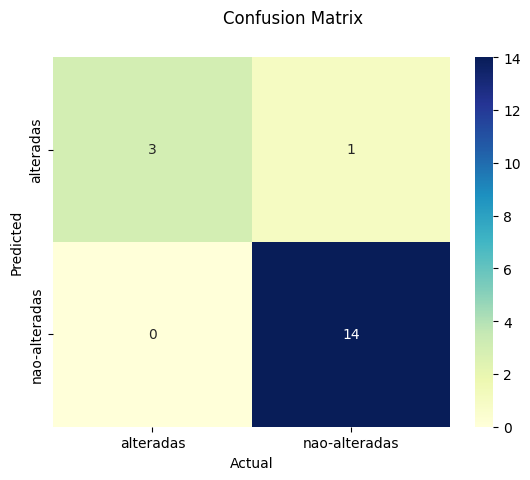

(<Figure size 640x480 with 2 Axes>,
 <Axes: xlabel='Actual', ylabel='Predicted'>)

In [ ]:
evaluation_test.show_confusion_matrix()

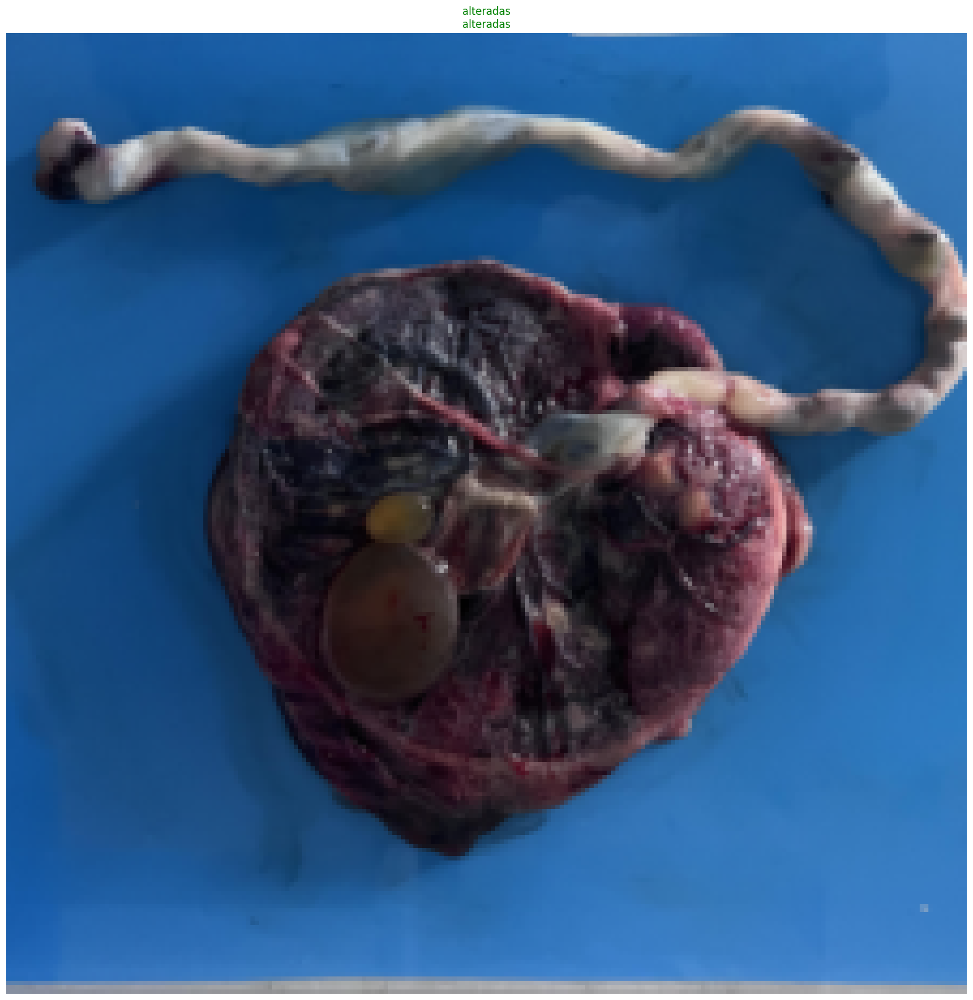

In [ ]:
learner.show_results(
    max_n=6, figsize=(20, 30)
)

## EfficientNet B4 - Batch Size 8 with DA

### Setup

In [ ]:
from fastai.vision.models import efficientnet_b4

arch = efficientnet_b4(weights=True)
used_model = nn.Sequential(arch, nn.Linear(in_features=1000, out_features=data.c, bias=True))

/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B4_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B4_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/efficientnet_b4_rwightman-23ab8bcd.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b4_rwightman-23ab8bcd.pth


100%|██████████| 74.5M/74.5M [00:00<00:00, 180MB/s]


In [ ]:
metrics = [
    accuracy,
    top_k_accuracy,
    F1Score(average="macro"),
    Precision(average="macro"),
    Recall(average="macro"),
]

In [ ]:
# Defina o tamanho do seu lote de imagens para processamento pela rede
batch_size = 8

image_size = (224, 224)

data = ImageDataLoaders.from_folder(
    DATASET_PATH,
    train='train',
    valid='valid',
    test='test',
    item_tfms=Resize(image_size),
    batch_tfms=[*transforms, Normalize.from_stats(*imagenet_stats)],
    bs=batch_size
)

In [ ]:
def get_learner(data, load_model=None, unfreeze:bool=False):
    """Creates and setups the learner for each step of the training approach.

    Args:
        data: Dataloader.
        load_model (str): Path to the model to be loaded.
        unfreeze (bool): Indicates if the model should be unfreezed. Defaults to False.
    """
    learner = Learner(
      dls=data,
      model=arch,
      metrics=metrics,
      opt_func=Adam,
      loss_func=CrossEntropyLossFlat()
    )

    learner.path = Path(os.path.join(MODELS_PATH, 'efficientnetb4-bs8'))

    if load_model:
      learner.load(load_model, with_opt=False)

    if unfreeze:
      learner.unfreeze()

    return learner

### Transfer Learning

#### Training

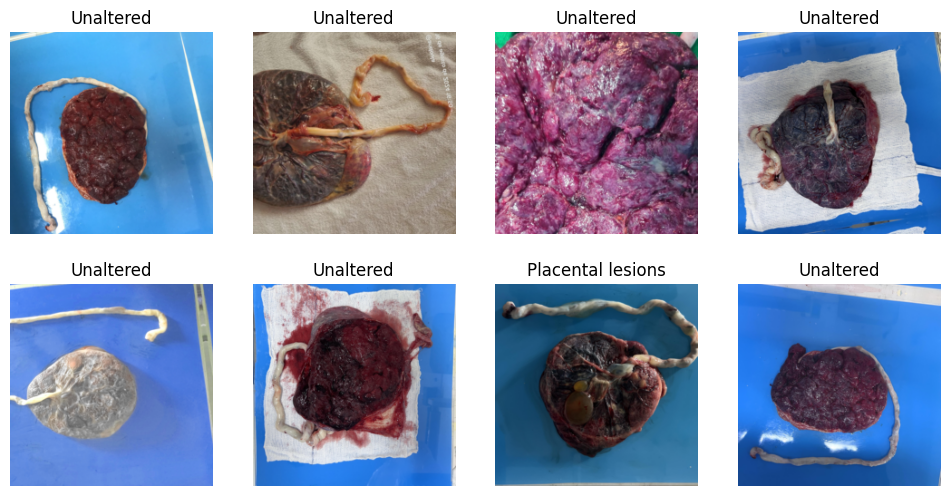

In [ ]:
data.show_batch()

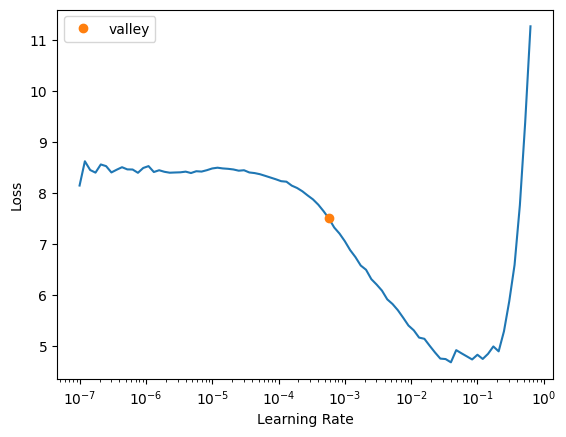

In [ ]:
learner = get_learner(data)
lr = learner.lr_find().valley

epoch,train_loss,valid_loss,accuracy,top_k_accuracy,f1_score,precision_score,recall_score,time
0,6.557111,5.548245,0.064103,0.179487,0.002042,0.011574,0.001120,01:04
1,3.800762,2.439464,0.615385,0.794872,0.028812,0.030075,0.027650,01:07
2,2.046966,1.322250,0.820513,0.858974,0.135621,0.183784,0.128571,01:05
3,1.068537,0.720719,0.871795,0.948718,0.269744,0.289899,0.274194,01:06
4,0.616801,0.411885,0.948718,0.987179,0.572047,0.603606,0.562500,01:05
5,0.316268,0.213100,0.961538,0.987179,0.788714,0.869231,0.750000,01:08
6,0.128802,0.118268,0.961538,0.987179,0.820765,0.869231,0.794643,01:06
7,0.073515,0.031756,0.987179,1.000000,0.833333,0.812500,0.875000,01:06
8,0.036641,0.027251,1.000000,1.000000,1.000000,1.000000,1.000000,01:06
9,0.018211,0.015171,1.000000,1.000000,1.000000,1.000000,1.000000,01:06


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 0 with f1_score value: 0.002042483660130719.


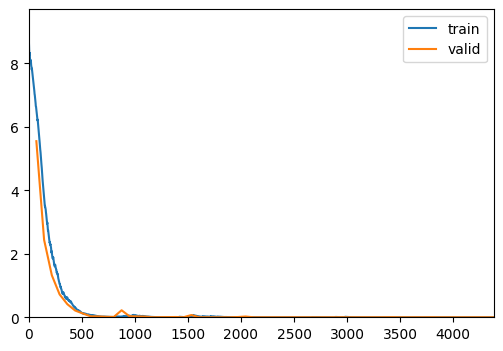

/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 1 with f1_score value: 0.028811524609843937.


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 2 with f1_score value: 0.13562091503267976.


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 3 with f1_score value: 0.269744008714597.


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 4 with f1_score value: 0.5720472440944881.


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 5 with f1_score value: 0.7887139107611548.


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 6 with f1_score value: 0.8207651928124369.


/usr/local/lib/python3.12/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Better model found at epoch 7 with f1_score value: 0.8333333333333333.
Better model found at epoch 8 with f1_score value: 1.0.


In [ ]:
wd = 1e-2
TRAIN_EPOCH = 60
callbacks = [
    SaveModelCallback(monitor='f1_score', fname='best_model_stg1', with_opt=False),
    ShowGraphCallback(),
    # EarlyStoppingCallback(monitor='valid_loss', patience=3)
]

learner.fit_one_cycle(TRAIN_EPOCH, lr_max=lr, wd=wd, cbs=callbacks)

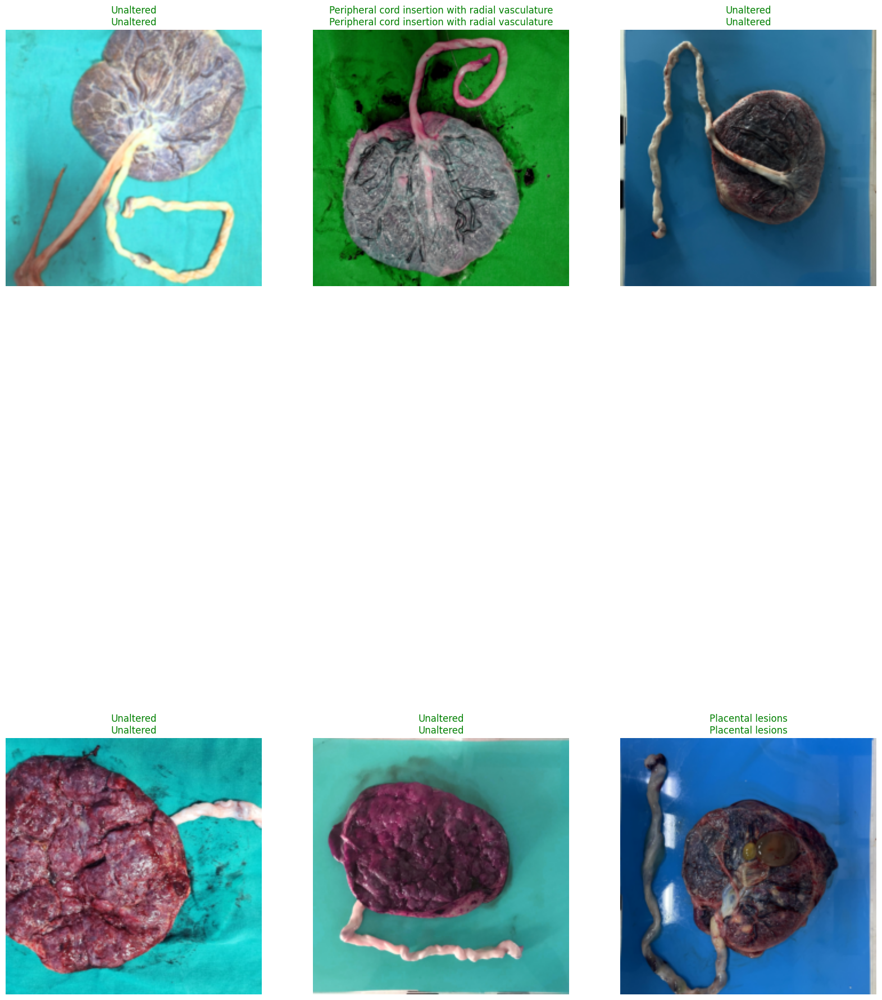

In [ ]:
get_learner(data, 'best_model_stg1').show_results(
    max_n=6, figsize=(20, 30)
)

### Finetuning

In [ ]:
'''
learner = get_learner(data, 'best_model_stg1', True)
learner.lr_find()
'''

print('Skipped since finetuning not needed')

Skipped since finetuning not needed


In [ ]:
'''
lr = slice(1.44e-5, 8e-5)
wd = 1e-2
TRAIN_EPOCH = 20
callbacks = [
    SaveModelCallback(monitor='f1_score', fname='best_model_stg2', with_opt=False),
    ShowGraphCallback(),
    EarlyStoppingCallback(monitor='valid_loss', patience=3)
]

learn.fit_one_cycle(TRAIN_EPOCH, lr_max=lr, wd=wd, cbs=callbacks)
'''

print('Skipped since finetuning not needed')

Skipped since finetuning not needed


### Test

#### Setup

In [ ]:
# Defina o tamanho do seu lote de imagens para processamento pela rede
batch_size = 1

image_size = (224, 224)

data_test= ImageDataLoaders.from_folder(
    DATASET_PATH,
    train='test',
    valid='test',
    test='test',
    item_tfms=Resize(image_size),
    batch_tfms=[Normalize.from_stats(*imagenet_stats)],
    bs=batch_size
)

In [ ]:
learner = get_learner(data_test, 'best_model_stg1')
test_dataset = data_test.valid_ds

#### Functions

In [ ]:
from IPython.display import Image

def gt_classifications(ds):
    for (img, cls) in ds:
        yield Classification(int(cls))

def pred_classifications(ds):
    for (img, cls) in ds:
        (cls_name, pred_cls, scores) = learner.predict(img)
        yield Classification(int(pred_cls), scores[int(pred_cls)])

def top5(img):
  pred_class, pred_idxs, outputs = learner.predict(img)
  top_5_conf, i = outputs.topk(5)
  itr = 0
  classes = data.classes
  for x in i:
    print("Class: %s, Probability: %.4f %%"%(classes[x.item()], top_5_conf[itr].item()*100))
    itr=itr+1
  print()

def get_prediction(img, correct_class):
  pred_class, pred_idxs, outputs = learner.predict(img)
  classes = data.classes
  out = list(outputs)
  index = classes.index(correct_class)
  prediction = out[index]
  print("%.10f %%"%(prediction.item()*100))
  print()

#### Results

In [ ]:
evaluation_test = evaluate_classification(
    gt_classifications(test_dataset), pred_classifications(test_dataset), test_dataset.vocab
)

print(evaluation_test)

0 samples [00:00, ? samples/s]

Classification Metrics:
	Sample Count: 78
	Accuracy: 0.9743589743589743
	Avg Recall: 0.875
	Avg Precision: 0.99609375
	Avg Specificity: 0.984375
	Avg FPR: 0.015625
	Avg F-Score: 0.9146825396825397

By Class:

Greenish membranes:
	TP: 1
	TN: 77
	FP: 0
	FN: 0
	FPR: 0.0
	Accuracy: 1.0
	Recall: 1.0
	Precision: 1
	Specificity: 1.0
	F-Score: 1.0
Irregular placental disc:
	TP: 1
	TN: 77
	FP: 0
	FN: 0
	FPR: 0.0
	Accuracy: 1.0
	Recall: 1.0
	Precision: 1
	Specificity: 1.0
	F-Score: 1.0
Marginal insertion of the umbilical cord with radial blood vessel distribution:
	TP: 1
	TN: 76
	FP: 0
	FN: 1
	FPR: 0.0
	Accuracy: 0.9871794871794872
	Recall: 0.5
	Precision: 1.0
	Specificity: 1.0
	F-Score: 0.6666666666666666
Opaque placental membranes:
	TP: 2
	TN: 76
	FP: 0
	FN: 0
	FPR: 0.0
	Accuracy: 1.0
	Recall: 1.0
	Precision: 1
	Specificity: 1.0
	F-Score: 1.0
Oval-shaped disc:
	TP: 1
	TN: 77
	FP: 0
	FN: 0
	FPR: 0.0
	Accuracy: 1.0
	Recall: 1.0
	Precision: 1
	Specificity: 1.0
	F-Score: 1.0
Peripheral cord insert

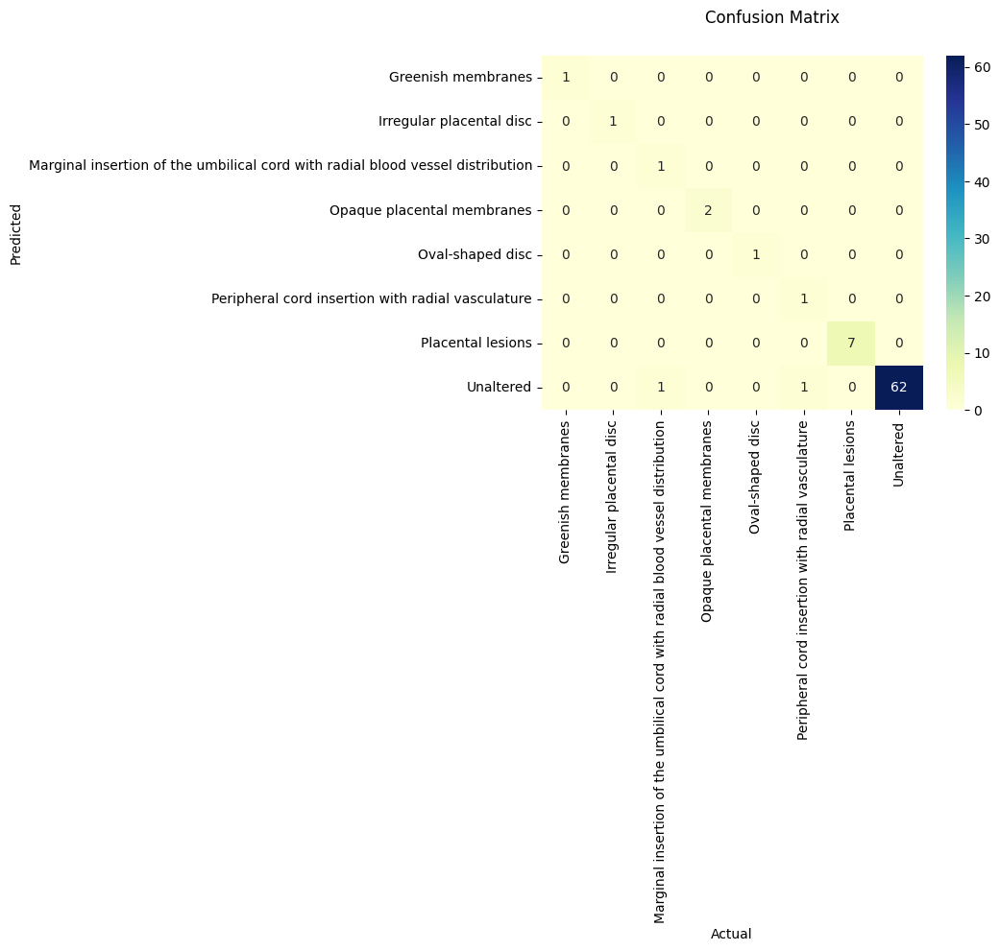

(<Figure size 640x480 with 2 Axes>,
 <Axes: xlabel='Actual', ylabel='Predicted'>)

In [ ]:
evaluation_test.show_confusion_matrix()